## Capstone Project:
**Topic**: Impact of Screen Time on Mental Health.

**Mentor**: Mr. Satyaki Dasgupta

**Team Members**:
1. Tompala Kiran Kumar - **2024AIML117**
2. Rajaprabhar V - **2024AIML084**
3. Pottimoorti Santosh Kumar - **2024AIML103**
4. Sathyanarayana Rao K - **2024AIML106**
5. Kingsly Abraham V - **2024AIML096**


**Dataset**: https://drive.google.com/drive/u/1/folders/1zpD1hniFkSkNKzBFhhpmqZP8Pd-UlqR7

### 01. Importing Required Libraries

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid")
import warnings
warnings.filterwarnings("ignore")

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, classification_report, mean_absolute_percentage_error
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest, f_regression, RFE, RFECV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet

from sklearn.ensemble import (
    RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor ,
    StackingRegressor, VotingRegressor
)
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor


In [3]:
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
#!pip install ipympl

In [4]:
from ydata_profiling import ProfileReport

### 02. Importing/ Reading  the data from CSV file into a dataset

In [5]:
# Importing the data

file_path=r"C:\Drive - Professional\AIML - BITS Pilani (PG)\03. Assignments\03. Data Files\digital_diet_mental_health.csv"
data=pd.read_csv(file_path)
data

,user_id,age,gender,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,...,stress_level,physical_activity_hours_per_week,location_type,mental_health_score,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day
0,user_1,51,Female,4.8,3.4,1.3,1.6,1.6,4.1,2.0,...,10,0.7,Urban,32,1,1,125.2,13,15,4.0
1,user_2,64,Male,3.9,3.5,1.8,0.9,2.0,2.7,3.1,...,6,4.3,Suburban,75,0,1,150.4,19,18,6.5
2,user_3,41,Other,10.5,2.1,2.6,0.7,2.2,3.0,2.8,...,5,3.1,Suburban,22,0,0,187.9,7,3,6.9
3,user_4,27,Other,8.8,0.0,0.0,0.7,2.5,3.3,1.6,...,5,0.0,Rural,22,0,1,73.6,7,2,4.8
4,user_5,55,Male,5.9,1.7,1.1,1.5,1.6,1.1,3.6,...,7,3.0,Urban,64,1,1,217.5,8,10,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1955,user_1996,58,Female,5.6,4.0,2.5,0.3,1.5,1.1,1.2,...,9,0.0,Urban,62,0,1,164.9,20,17,4.9
1956,user_1997,62,Female,3.9,3.1,1.0,1.5,1.1,2.7,4.1,...,8,2.7,Urban,29,0,0,172.6,15,15,25.5
1957,user_1998,64,Female,7.4,3.0,0.0,1.4,0.9,0.8,2.6,...,4,6.5,Urban,54,1,0,101.3,1,20,9.5
1958,user_1999,19,Male,4.2,4.4,2.3,0.9,1.4,1.7,1.2,...,8,2.6,Urban,28,0,0,123.7,1,11,13.4


### 03. Data Profiling

In [6]:
profile = ProfileReport(data, title="Mental Health Dataset Profile")
profile.to_file("output_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 924.02it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
# Checking the information of the dataset like the variables and its datatype.
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1960 entries, 0 to 1959
Data columns (total 25 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   user_id                           1960 non-null   object 
 1   age                               1960 non-null   int64  
 2   gender                            1960 non-null   object 
 3   daily_screen_time_hours           1960 non-null   float64
 4   phone_usage_hours                 1960 non-null   float64
 5   laptop_usage_hours                1960 non-null   float64
 6   tablet_usage_hours                1960 non-null   float64
 7   tv_usage_hours                    1960 non-null   float64
 8   social_media_hours                1960 non-null   float64
 9   work_related_hours                1960 non-null   float64
 10  entertainment_hours               1960 non-null   float64
 11  gaming_hours                      1960 non-null   float64
 12  sleep_

In [8]:
# Summary statistics of the dataset of each variable/ column.
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
age,1960.0,38.755102,14.894806,13.0,26.0,39.0,51.0,64.0
daily_screen_time_hours,1960.0,6.018571,1.971352,0.0,4.7,6.0,7.3,13.3
phone_usage_hours,1960.0,3.028929,1.446964,0.0,2.0,3.0,4.0,8.4
laptop_usage_hours,1960.0,2.001837,0.997090,0.0,1.3,2.0,2.7,5.6
tablet_usage_hours,1960.0,0.995663,0.492223,0.0,0.6,1.0,1.3,2.5
tv_usage_hours,1960.0,1.503112,0.960525,0.0,0.8,1.5,2.2,4.7
social_media_hours,1960.0,2.038265,1.133262,0.0,1.2,2.0,2.8,5.8
work_related_hours,1960.0,2.010969,1.116660,0.0,1.2,2.0,2.8,5.9
entertainment_hours,1960.0,2.460051,1.237285,0.0,1.6,2.4,3.3,6.8
gaming_hours,1960.0,1.285459,0.897082,0.0,0.6,1.2,1.9,4.0


In [9]:
# Checking the shape of the dataset (Rows & Columns)
print("Shape of dataset:", data.shape)

Shape of dataset: (1960, 25)


### 04. Pre-processing the data

In [10]:
# Checking for the missing values in each variable
print("\nMissing values:\n", data.isnull().sum())


Missing values:
 user_id                             0
age                                 0
gender                              0
daily_screen_time_hours             0
phone_usage_hours                   0
laptop_usage_hours                  0
tablet_usage_hours                  0
tv_usage_hours                      0
social_media_hours                  0
work_related_hours                  0
entertainment_hours                 0
gaming_hours                        0
sleep_duration_hours                0
sleep_quality                       0
mood_rating                         0
stress_level                        0
physical_activity_hours_per_week    0
location_type                       0
mental_health_score                 0
uses_wellness_apps                  0
eats_healthy                        0
caffeine_intake_mg_per_day          0
weekly_anxiety_score                0
weekly_depression_score             0
mindfulness_minutes_per_day         0
dtype: int64


In [11]:
# Checking for the duplicate records/ observations
print("\nDuplicate rows:", data.duplicated().sum())


Duplicate rows: 0


## Outlier Detection

-> IQR Method:

In [12]:
# Selecting  only the numeric columns for outlier detection
numeric_cols = data.select_dtypes(include=np.number).columns
outlier_counts = {}

# IQR Method for Outlier Detection
for col in numeric_cols:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = data[(data[col] < lower_bound) | (data[col] > upper_bound)]
    outlier_counts[col] = outliers.shape[0]

In [13]:
print("Number of outliers detected from IQR Method:", len(outliers))
print(outliers.index)

Number of outliers detected from IQR Method: 6
Index([290, 1015, 1026, 1253, 1483, 1742], dtype='int64')


In [14]:
# --- Outlier Removal based on IQR Method ---
IQR_data= data.copy()

IQR_outlier_indices = [297, 1036, 1047, 1280, 1515, 1778]
IQR_data.drop(index=IQR_outlier_indices, inplace=True)
print(f"\n{len(IQR_outlier_indices)} outliers were removed based on the IQR method.")
print(f"New shape after outlier removal: {IQR_data.shape}")


6 outliers were removed based on the IQR method.
New shape after outlier removal: (1954, 25)


-> DBSCAN for outliers

- DBSCAN works by finding dense clusters and labeling points in low-density regions as outliers.
- The 'eps' parameter defines the maximum distance between two samples for them to be considered as in the same neighborhood.
- The 'min_samples' parameter is the number of samples in a neighborhood for a point to be considered as a core point.

In [15]:
from sklearn.cluster import DBSCAN

#features_for_analysis = data.select_dtypes(include=np.number).columns.tolist()
# Droping non-numeric columns
numeric_df = data.drop(columns=['user_id', 'gender', 'location_type'])

# Standardizing the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_df)

# Example: suppose eps = 2.5 (from elbow)
dbscan = DBSCAN(eps=0.001, min_samples=2)
labels = dbscan.fit_predict(scaled_data)

new=pd.DataFrame(data)

# Add results back
new['cluster'] = labels
outliers = new[new['cluster'] == -1]

print("Number of outliers detected:", len(outliers))
print(outliers.index)

Number of outliers detected: 1960
RangeIndex(start=0, stop=1960, step=1)


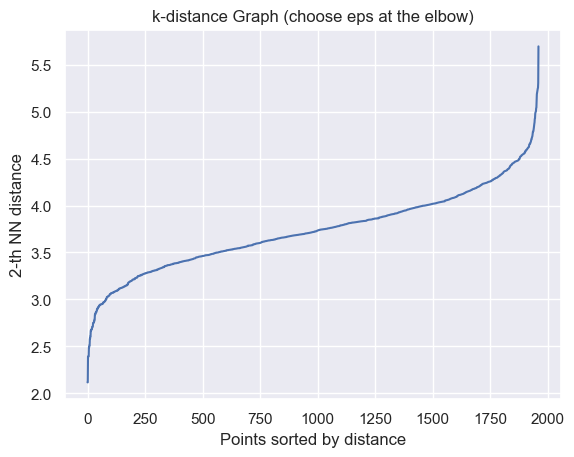

In [16]:
# Tuning Parameters with k-distance Graph
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import numpy as np

# Rule of thumb: min_samples = 2 * n_features
min_samples = 2
neighbors = NearestNeighbors(n_neighbors=min_samples)
neighbors_fit = neighbors.fit(scaled_data)
distances, indices = neighbors_fit.kneighbors(scaled_data)

# Sort distances (k-th nearest neighbor)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.title("k-distance Graph (choose eps at the elbow)")
plt.xlabel("Points sorted by distance")
plt.ylabel(f"{min_samples}-th NN distance")
plt.show()

### -> Other Methods for Outliers detction

01. Isolation Forest
-- Randomly isolates points in feature space; points that are easier to isolate are outliers.

02. Local Outlier Factor (LOF) -- Compares local density of a point with its neighbors; lower density → outlier.

03. One-Class SVM -- Learns the boundary of the “normal” data in feature space; points outside → outliers.

04. Elliptic Envelope -- Fits a multivariate Gaussian (ellipsoid) to the data; points outside → outliers.

In [17]:
#!pip install pyod
#!pip install combo



In [18]:
# !pip install pyod
#import pyod
#print(pyod.__version__)

In [19]:
import pyod

In [20]:
from pyod.models.abod import ABOD
from pyod.models.cblof import CBLOF
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF

def other_outlier_detection(data, outlierCountDF):
    # Parameters
    random_state = np.random.RandomState(42)
    outliers_fraction = 0.05

    # Define models (procedural way)
    classifiers = [
        ("Angle-based Outlier Detector", ABOD(contamination=outliers_fraction)),
        ("Cluster-based Local Outlier Factor", CBLOF(
            contamination=outliers_fraction,
            check_estimator=False,
            random_state=random_state
        )),
        ("Feature Bagging", FeatureBagging(
            base_estimator=LOF(n_neighbors=35),
            contamination=outliers_fraction,
            check_estimator=False,
            random_state=random_state
        )),
        ("Histogram-based Outlier Detection", HBOS(contamination=outliers_fraction)),
        ("Isolation Forest", IForest(contamination=outliers_fraction, random_state=random_state)),
        ("K Nearest Neighbors", KNN(contamination=outliers_fraction)),
        ("Average KNN", KNN(method='mean', contamination=outliers_fraction))
    ]

    # Copying of dataset
    d1 = data.copy()
    d2 = data.copy()
    outlierTemp = outlierCountDF.copy()
    outlierList = []

    # Looping through models
    for modelName, model in classifiers:
        model.fit(d1)
        prediction = model.predict(d1)  # 0 = inlier, 1 = outlier

        inlierCount = len(prediction) - np.count_nonzero(prediction)
        outlierCount = np.count_nonzero(prediction == 1)

        # Adding prediction results to dataframe
        d2[modelName] = prediction.tolist()

        # Printing results
        print(f"OUTLIERS: {outlierCount}, INLIERS: {inlierCount}, MODEL: {modelName}")

        # Appending to summary dataframe
        newRow = {"Model": modelName, "OutlierCount": outlierCount}
        outlierTemp = pd.concat([outlierTemp, pd.DataFrame([newRow])], ignore_index=True)

        # Keeping the track of models
        outlierList.append(modelName)

    return d2, outlierTemp, outlierList


In [21]:
categorical_vars = ['gender', 'location_type', 'uses_wellness_apps', 'eats_healthy']
id_vars = ['user_ID']
exclude_cols = categorical_vars + id_vars

data_filtered = data.drop(columns=[col for col in exclude_cols if col in data.columns])

numeric_data = data_filtered.select_dtypes(include=[np.number])

outlierCountDF = pd.DataFrame(columns=["Model", "OutlierCount"])

d2, outlierTemp, outlierList = other_outlier_detection(numeric_data, outlierCountDF)

OUTLIERS: 186, INLIERS: 1774, MODEL: Angle-based Outlier Detector
OUTLIERS: 98, INLIERS: 1862, MODEL: Cluster-based Local Outlier Factor
OUTLIERS: 89, INLIERS: 1871, MODEL: Feature Bagging
OUTLIERS: 98, INLIERS: 1862, MODEL: Histogram-based Outlier Detection
OUTLIERS: 98, INLIERS: 1862, MODEL: Isolation Forest
OUTLIERS: 70, INLIERS: 1890, MODEL: K Nearest Neighbors
OUTLIERS: 20, INLIERS: 1940, MODEL: Average KNN


In [22]:
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.covariance import EllipticEnvelope

# --- 1. IQR Method ---
def iqr_outliers(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - 1.5 * IQR
    upper = Q3 + 1.5 * IQR
    return ((df[col] < lower) | (df[col] > upper)).astype(int)

# Apply IQR for each numeric column → 1 = outlier if any column is flagged
iqr_flags = pd.DataFrame(0, index=data.index, columns=["IQR"])
for col in data.select_dtypes(include=[np.number]).columns:
    iqr_flags["IQR"] = iqr_flags["IQR"] | iqr_outliers(data, col)

# --- 2. Isolation Forest ---
iso = IsolationForest(contamination=0.05, random_state=42)
data["IForest"] = iso.fit_predict(data.select_dtypes(include=[np.number]))
data["IForest"] = (data["IForest"] == -1).astype(int)  # -1 → outlier

# --- 3. Local Outlier Factor ---
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
lof_preds = lof.fit_predict(data.select_dtypes(include=[np.number]))
data["LOF"] = (lof_preds == -1).astype(int)

# --- 4. One-Class SVM ---
svm = OneClassSVM(nu=0.05, kernel="rbf", gamma=0.1)
svm_preds = svm.fit_predict(data.select_dtypes(include=[np.number]))
data["OneClassSVM"] = (svm_preds == -1).astype(int)

# --- 5. Elliptic Envelope ---
ee = EllipticEnvelope(contamination=0.05, random_state=42)
ee_preds = ee.fit_predict(data.select_dtypes(include=[np.number]))
data["EllipticEnvelope"] = (ee_preds == -1).astype(int)

# --- Combining All Methods (AND condition) ---
data["IQR"] = iqr_flags["IQR"]  # add IQR column
data["Common_Outlier"] = (
   # (data["IQR"] == 1) &
    (data["IForest"] == 1) &
    (data["LOF"] == 1) &
    (data["OneClassSVM"] == 1) &
    (data["EllipticEnvelope"] == 1)
).astype(int)

# --- Removing Common Outliers ---
cleaned_data = data[data["Common_Outlier"] == 0].drop(
    columns=["IQR", "IForest", "LOF", "OneClassSVM", "EllipticEnvelope", "Common_Outlier"]
)

print("Original shape:", data.shape)
print("Cleaned shape:", cleaned_data.shape)

Original shape: (1960, 31)
Cleaned shape: (1944, 25)


### 05. Visualiziation/ EDA

#### 5.1. Pair Plots between Numeric Variables Vs Target Variable

In [ ]:
# Create a new dataset without the 'user_id' column
pair_plot_data = cleaned_data.drop(columns='user_id')

# Pulling all columns with numeric data types from the new dataset
numeric_vars = pair_plot_data.select_dtypes(include=['int64', 'float64']).columns.tolist()

print(f"Plotting the following {len(numeric_vars)} numeric variables (including target):")
print(numeric_vars)

# Target variable
target_var = 'mental_health_score'

# Creating pair plot for all numeric variables
sns.pairplot(
    data=pair_plot_data[numeric_vars],
    hue=target_var,             # Optional: color by target variable
    diag_kind='kde',            # Kernel Density Estimation on the diagonal
    plot_kws={'alpha': 0.6, 's': 20}  # Style for scatter points
)

plt.suptitle("Pair Plot of Numeric Variables", y=1.02, fontsize=16)
plt.show()

In [ ]:
import math

# Create a new dataset without the 'user_id' column
pair_plot_data = cleaned_data.drop(columns='user_id')

# Get all columns with numeric data types from the new dataset
numeric_vars = pair_plot_data.select_dtypes(include=['int64', 'float64']).columns.tolist()

print(f"Plotting the following {len(numeric_vars)} numeric variables:")
print(numeric_vars)

# The target variable is 'mental_health_score'
target_var = 'mental_health_score'

# Remove the target variable from the list of features to plot
numeric_vars.remove(target_var)

# Determine the number of plots and the grid layout
num_plots = len(numeric_vars)
cols = 3  # Number of columns for the grid
rows = math.ceil(num_plots / cols) # Calculate rows needed

# Create the figure and subplots
fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 4 * rows))
fig.suptitle(f'Numeric Variables vs. {target_var}', fontsize=16) # Removed y parameter
plt.subplots_adjust(hspace=0.4, wspace=0.3, top=0.95) # Added top margin adjustment

# Flatten the axes array for easy iteration if it's a 2D array
if rows > 1:
    axes = axes.flatten()
else:
    axes = [axes]

# Loop through each numeric variable and create a scatter plot with a regression line
for i, var in enumerate(numeric_vars):
    sns.regplot(
        x=var,
        y=target_var,
        data=pair_plot_data,
        ax=axes[i],
        scatter_kws={'s': 10},
        line_kws={'color': 'red'}
    )
    axes[i].set_title(f'{var} vs. {target_var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel(target_var)

# Hide any empty subplots
for i in range(num_plots, len(axes)):
    fig.delaxes(axes[i])

plt.show()

print("\nIndividual plots for each numeric variable vs. the target variable have been generated.")
print("A new window with a grid of plots should appear, making it easier to interpret the relationships.")



#### 5.2. Pair Plot by Gender

Generating pair plot for key variables...


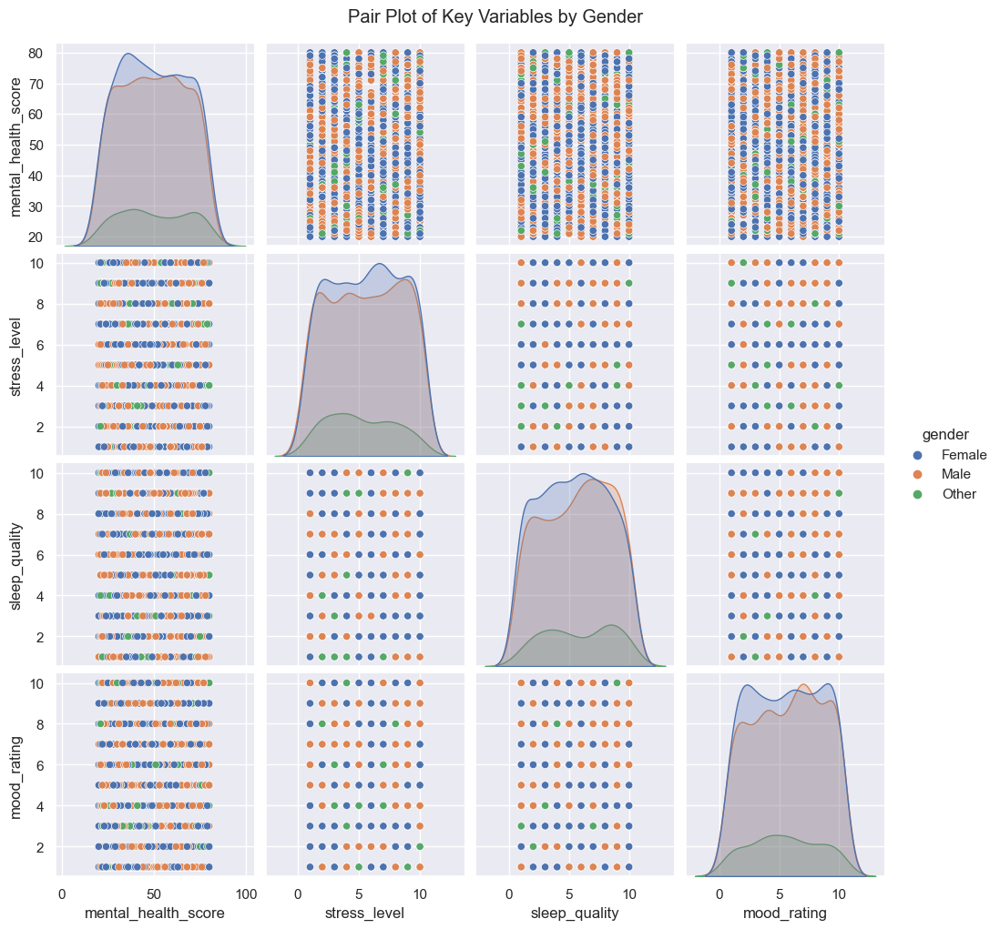

In [25]:
# --- Visualisation - Pair plots ---
print("Generating pair plot for key variables...")
sns.pairplot(cleaned_data, vars=['mental_health_score', 'stress_level', 'sleep_quality', 'mood_rating'], hue='gender', diag_kind='kde')
plt.suptitle('Pair Plot of Key Variables by Gender', y=1.02)
plt.savefig('pair_plot_by_gender.png')
plt.show()

#### 5.3. Pair Plot: Age Vs mental_health_score

In [ ]:
# --- Scatter plot - gender wise ---
print("\nGenerating scatter plot for Age vs Mental Health Score by Gender...")
plt.figure(figsize=(10, 6))
sns.scatterplot(data=cleaned_data, x='age', y='mental_health_score', hue='gender', style='gender')
plt.title('Age vs. Mental Health Score by Gender')
plt.xlabel('Age')
plt.ylabel('Mental Health Score')
plt.savefig('age_vs_mental_health_by_gender.png')
plt.show()

#### 5.4. Bar Plots: Gender Vs Numeric Variables


Generating bar plots for Gender vs. all numerical columns...


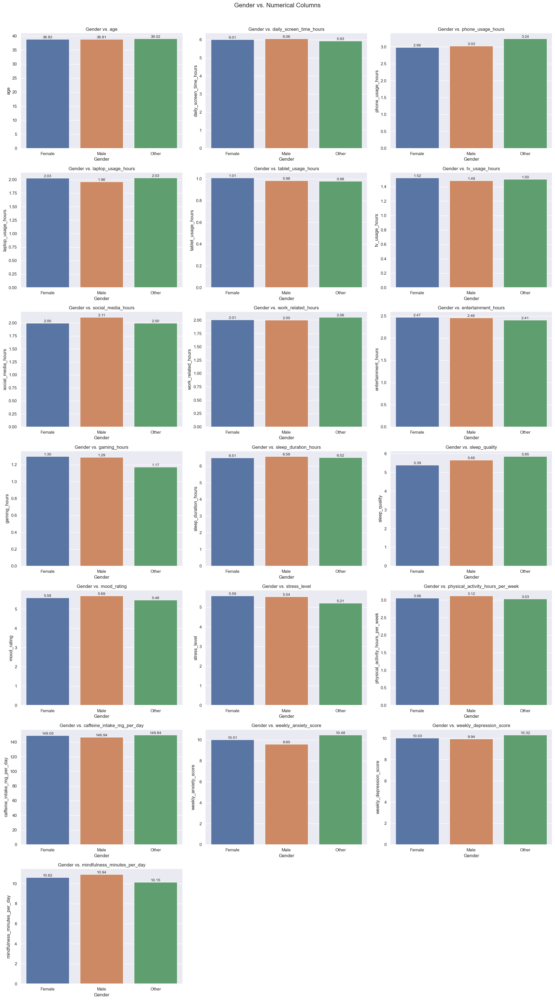

In [27]:
# --- Bar plots for gender vs. all numerical columns ---
numerical_cols = data_filtered.select_dtypes(include=np.number).columns.tolist()
numerical_cols.remove('mental_health_score')

print("\nGenerating bar plots for Gender vs. all numerical columns...")
n_cols = 3
n_rows = (len(numerical_cols) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    ax = axes[i]
    sns.barplot(data=cleaned_data, x='gender', y=col, ax=ax, errorbar=None)
    ax.set_title(f'Gender vs. {col}', fontsize=12)
    ax.set_xlabel('Gender')
    ax.set_ylabel(col)

    # Add exact counts on each bar
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height:.2f}', (p.get_x() + p.get_width() / 2., height),
                    ha='center', va='bottom', fontsize=10)

# Hiding any empty subplots
for j in range(len(numerical_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle('Gender vs. Numerical Columns', y=1.02, fontsize=16)
plt.savefig('gender_vs_numerical_bar_plots.png')
plt.show()

#### 5.5. Bar Plots: Location_type Vs Numeric Variables


Generating bar plots for Gender vs. all numerical columns...


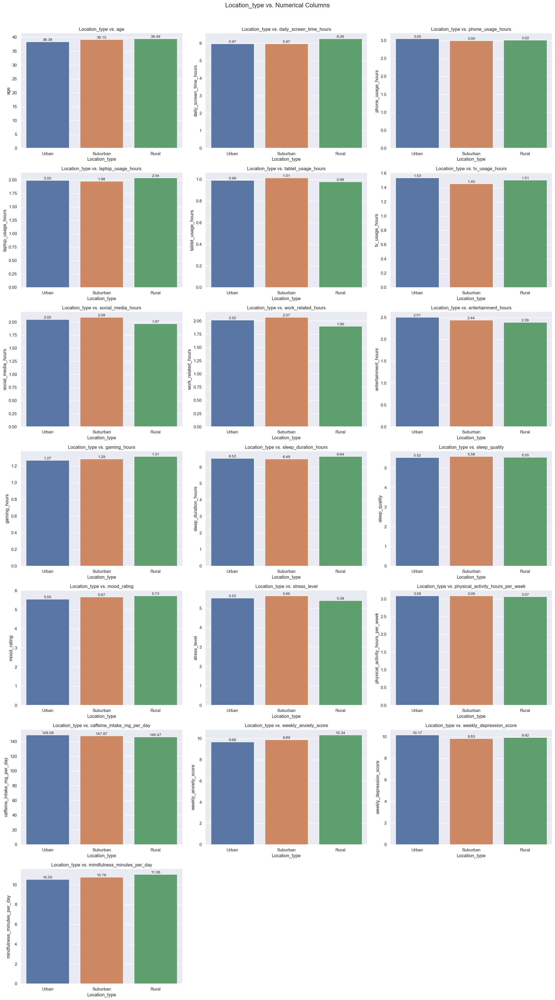

In [28]:
# --- Bar plots for gender vs. all numerical columns ---
numerical_cols = data_filtered.select_dtypes(include=np.number).columns.tolist()
numerical_cols.remove('mental_health_score')

print("\nGenerating bar plots for Gender vs. all numerical columns...")
n_cols = 3
n_rows = (len(numerical_cols) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    ax = axes[i]
    sns.barplot(data=cleaned_data, x='location_type', y=col, ax=ax, errorbar=None)
    ax.set_title(f'Location_type vs. {col}', fontsize=12)
    ax.set_xlabel('Location_type')
    ax.set_ylabel(col)

    # Add exact counts on each bar
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height:.2f}', (p.get_x() + p.get_width() / 2., height),
                    ha='center', va='bottom', fontsize=10)

# Hiding any empty subplots
for j in range(len(numerical_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle('Location_type vs. Numerical Columns', y=1.02, fontsize=16)
plt.savefig('Location_type_vs_numerical_bar_plots.png')
plt.show()


#### 5.6. Box Plots : For all numeric variables to visualize the outliers.


Outlier counts for each variable (using IQR method):
- age: 0 outliers
- daily_screen_time_hours: 17 outliers
- phone_usage_hours: 6 outliers
- laptop_usage_hours: 7 outliers
- tablet_usage_hours: 4 outliers
- tv_usage_hours: 6 outliers
- social_media_hours: 9 outliers
- work_related_hours: 5 outliers
- entertainment_hours: 4 outliers
- gaming_hours: 9 outliers
- sleep_duration_hours: 11 outliers
- sleep_quality: 0 outliers
- mood_rating: 0 outliers
- stress_level: 0 outliers
- physical_activity_hours_per_week: 7 outliers
- mental_health_score: 0 outliers
- uses_wellness_apps: 0 outliers
- eats_healthy: 0 outliers
- caffeine_intake_mg_per_day: 14 outliers
- weekly_anxiety_score: 0 outliers
- weekly_depression_score: 0 outliers
- mindfulness_minutes_per_day: 6 outliers


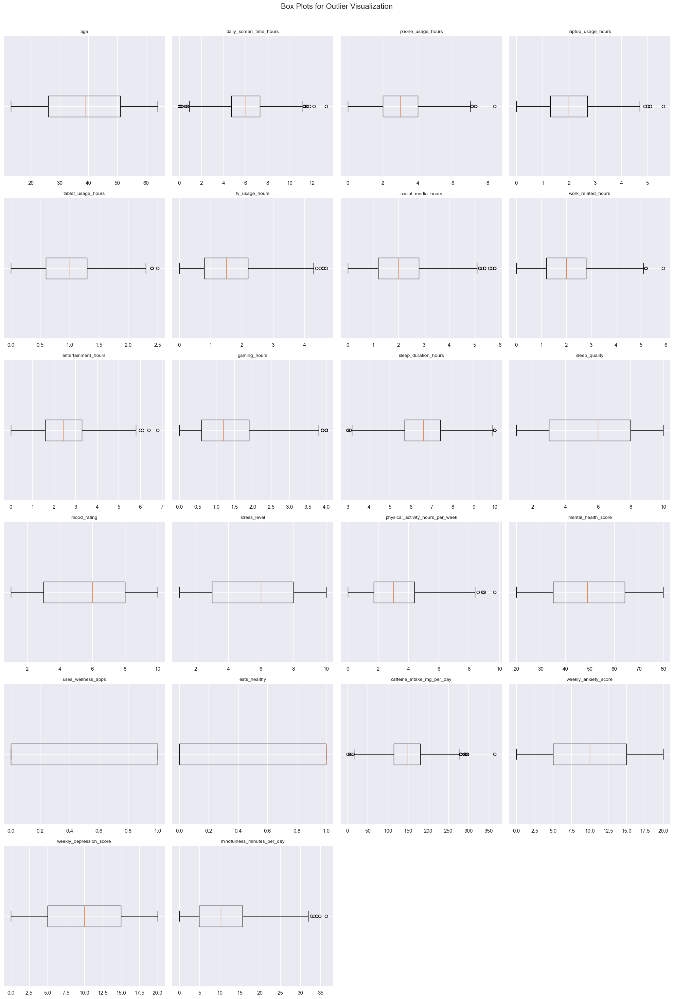

In [29]:
#  --- Generating box plots for all numeric variables to visualize the outliers (after removing the ouliers- Crosschecking) ---
n_cols = 4  # Number of columns for the subplots
n_rows = (len(numeric_cols) + n_cols - 1) // n_cols  # Calculating the number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(numeric_cols):
    axes[i].boxplot(cleaned_data[col].dropna(), vert=False)  # Using .dropna() to handle any potential missing values
    axes[i].set_title(col, fontsize=10)
    axes[i].tick_params(axis='y', left=False, labelleft=False)

# Hiding any empty subplots
for j in range(len(numeric_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Box Plots for Outlier Visualization', y=0.98, fontsize=16)
plt.savefig('final_outlier_box_plots.png')

# Printing the number of outliers found for each variable
print("\nOutlier counts for each variable (using IQR method):")
for col, count in outlier_counts.items():
    print(f"- {col}: {count} outliers")


#### 5.7. Scatter Plots : To visualize the realationship with Target variable

In [ ]:
# -- Generating scatter plots to visualize the relationship with the target variable --
target_col = 'mental_health_score'
feature_cols = [col for col in numeric_cols if col != target_col]

n_cols = 4  # Number of columns for the subplots
n_rows = (len(feature_cols) + n_cols - 1) // n_cols  # Calculate number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(feature_cols):
    axes[i].scatter(cleaned_data[col], cleaned_data[target_col], alpha=0.5)
    axes[i].set_title(f'{col} vs. {target_col}', fontsize=10)
    axes[i].set_xlabel(col, fontsize=8)
    axes[i].set_ylabel(target_col, fontsize=8)

# Hide any empty subplots
for j in range(len(feature_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle(f'Feature Distributions vs. {target_col}', y=0.98, fontsize=16)
plt.savefig('feature_vs_target_scatter_plots.png')
plt.show()

#### 5.8. Checking unique values of each variables from original dataset

In [31]:
from tabulate import tabulate

# Droping the 'user_id' column as it's a unique identifier
data_to_analyze = data.drop(columns=['user_id'])

print("\n--- Unique Values for Each Variable ---")
print("Note: For columns with a large number of unique values, a count is shown.")
print("---" * 15)

# Preparing the data for the table
table_data = []
for col in data_to_analyze.columns:
    unique_values = data_to_analyze[col].unique()
    num_unique = len(unique_values)

    if num_unique > 50:
        unique_display = f"{num_unique} unique values"
    else:
        unique_display = str(unique_values)

    table_data.append([col, unique_display])

# Print the data in a table format
print(tabulate(table_data, headers=["Variable", "Unique Values"], tablefmt="grid"))

print("\nUnique value check complete.")


--- Unique Values for Each Variable ---
Note: For columns with a large number of unique values, a count is shown.
---------------------------------------------
+----------------------------------+--------------------------------------------------------------------------+
| Variable                         | Unique Values                                                            |
+==================================+==========================================================================+
| age                              | 52 unique values                                                         |
+----------------------------------+--------------------------------------------------------------------------+
| gender                           | ['Female' 'Male' 'Other']                                                |
+----------------------------------+--------------------------------------------------------------------------+
| daily_screen_time_hours          | 114 unique values 

#### 5.9. Bar Chart (Percentage distribution) of Categorical Variables.


--- Generating Stacked Bar Graphs for all Categorical Pairs ---
Total pairs to plot: 6


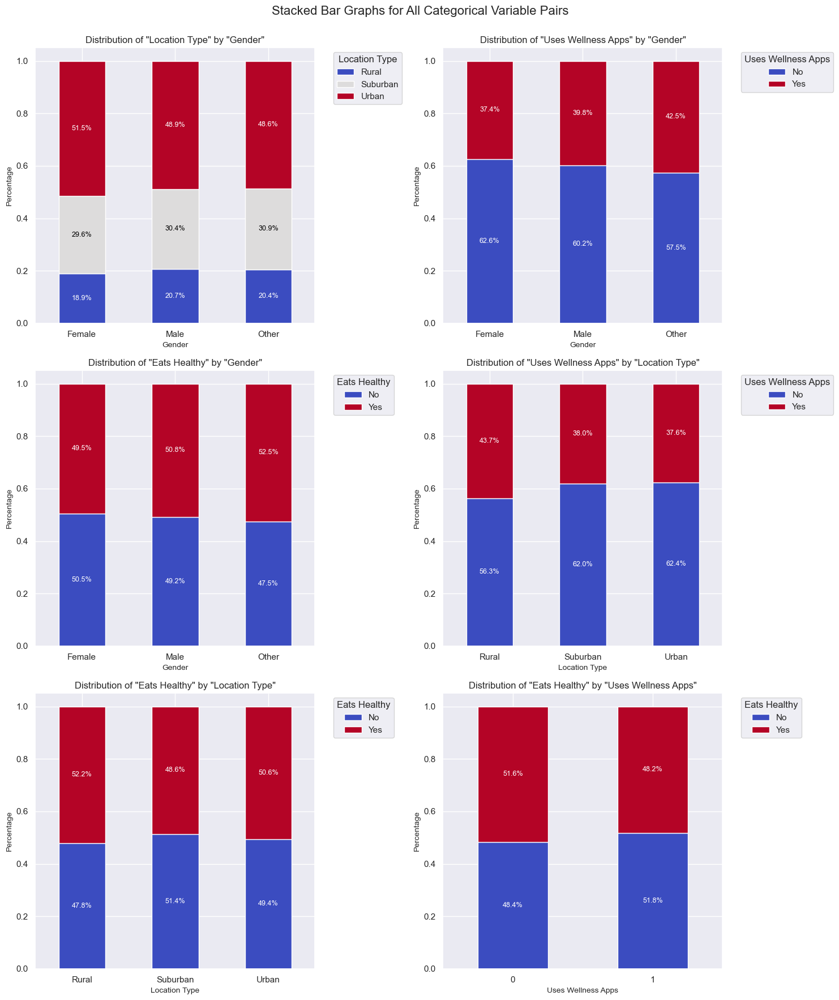


--- Analysis Summary ---
The stacked bar charts above provide insights into the proportional relationships between all pairs of your categorical variables.
Each graph shows how the categories of the y-axis variable are distributed within each category of the x-axis variable.
For example, the first chart shows the percentage breakdown of 'eats_healthy' ('Yes' or 'No') for each gender.
This type of visualization is crucial for identifying potential dependencies or skewed distributions between key demographic and lifestyle features.
For a detailed breakdown of counts and percentages, you can refer to the crosstabulations calculated in the script.


In [32]:
from tabulate import tabulate
from itertools import combinations

# List of categorical variables to analyze
categorical_vars = ['gender', 'location_type', 'uses_wellness_apps', 'eats_healthy']

# Generate all unique pairs of categorical variables
var_pairs = list(combinations(categorical_vars, 2))
print("\n--- Generating Stacked Bar Graphs for all Categorical Pairs ---")
print(f"Total pairs to plot: {len(var_pairs)}")

# Determine the number of subplots needed
n_cols = 2
n_rows = (len(var_pairs) + n_cols - 1) // n_cols
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 6 * n_rows))
axes = axes.flatten()

# Iterate through each pair and create a stacked bar chart
for i, (var1, var2) in enumerate(var_pairs):
    ax = axes[i]

    # Create a crosstab to get the counts of each combination
    stacked_data = pd.crosstab(data[var1], data[var2])

    # Rename columns for clarity if they are binary (0/1)
    if set(stacked_data.columns) == {0, 1}:
        stacked_data = stacked_data.rename(columns={0: 'No', 1: 'Yes'})

    # Calculate the percentage for each category within each group
    stacked_data_percent = stacked_data.apply(lambda x: x / x.sum(), axis=1)

    # Plot the stacked bar chart with a new color palette
    stacked_data_percent.plot(kind='bar', stacked=True, ax=ax, rot=0, cmap='coolwarm')

    # Add percentages on the bars with improved text color
    for p in ax.patches:
        height = p.get_height()
        if height > 0.01:
            # Get the color of the bar
            r, g, b, _ = p.get_facecolor()
            # Calculate luminance to decide text color (black or white)
            luminance = (0.299 * r + 0.587 * g + 0.114 * b)
            text_color = 'white' if luminance < 0.5 else 'black'

            ax.text(p.get_x() + p.get_width() / 2.,
                    p.get_y() + height / 2.,
                    f'{height:.1%}',
                    ha='center',
                    va='center',
                    fontsize=9,
                    color=text_color)

    ax.set_title(f'Distribution of "{var2.replace("_", " ").title()}" by "{var1.replace("_", " ").title()}"', fontsize=12)
    ax.set_xlabel(f'{var1.replace("_", " ").title()}', fontsize=10)
    ax.set_ylabel('Percentage', fontsize=10)
    ax.legend(title=f'{var2.replace("_", " ").title()}', bbox_to_anchor=(1.05, 1), loc='upper left')

# Hide any empty subplots
for j in range(len(var_pairs), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Stacked Bar Graphs for All Categorical Variable Pairs', y=0.98, fontsize=16)
plt.show()

# --- Provide a general summary of the analysis ---
print("\n--- Analysis Summary ---")
print("The stacked bar charts above provide insights into the proportional relationships between all pairs of your categorical variables.")
print("Each graph shows how the categories of the y-axis variable are distributed within each category of the x-axis variable.")
print("For example, the first chart shows the percentage breakdown of 'eats_healthy' ('Yes' or 'No') for each gender.")
print("This type of visualization is crucial for identifying potential dependencies or skewed distributions between key demographic and lifestyle features.")
print("For a detailed breakdown of counts and percentages, you can refer to the crosstabulations calculated in the script.")


### 06. Feature Engineering

#### 6.1. Label Encoding to categorical variables

In [33]:
# Create a new dataset for label encoding to avoid modifying the original 'data' DataFrame
labelEncode_data = cleaned_data.copy()

label_encoder = LabelEncoder()
labelEncode_data['gender'] = label_encoder.fit_transform(labelEncode_data['gender'])
labelEncode_data['location_type'] = label_encoder.fit_transform(labelEncode_data['location_type'])

print("\nCategorical variables 'gender' and 'location_type' have been label encoded.")


Categorical variables 'gender' and 'location_type' have been label encoded.


In [34]:
labelEncode_data.head()

,user_id,age,gender,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,...,stress_level,physical_activity_hours_per_week,location_type,mental_health_score,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day
0,user_1,51,0,4.8,3.4,1.3,1.6,1.6,4.1,2.0,...,10,0.7,2,32,1,1,125.2,13,15,4.0
1,user_2,64,1,3.9,3.5,1.8,0.9,2.0,2.7,3.1,...,6,4.3,1,75,0,1,150.4,19,18,6.5
2,user_3,41,2,10.5,2.1,2.6,0.7,2.2,3.0,2.8,...,5,3.1,1,22,0,0,187.9,7,3,6.9
3,user_4,27,2,8.8,0.0,0.0,0.7,2.5,3.3,1.6,...,5,0.0,0,22,0,1,73.6,7,2,4.8
4,user_5,55,1,5.9,1.7,1.1,1.5,1.6,1.1,3.6,...,7,3.0,2,64,1,1,217.5,8,10,0.0


In [35]:
# 'user_id' is just an identifier, so we can drop it
labelEncode_data = labelEncode_data.drop(columns=["user_id"])
print(f"Shape after encoding: {data.shape}")

Shape after encoding: (1960, 31)


#### 6.2. Dividing the data based on Age - (Creating bins)

In [36]:
Age_bin=labelEncode_data.copy()

# Creating bins for the specified age segments
bins = [13, 19, 26, 36, 51, np.inf]
labels = ['13-18', '19-25', '25-35', '35-50', '50+']
Age_bin['age_segment'] = pd.cut(Age_bin['age'], bins=bins, labels=labels, right=False)

print("\n'age' column has been binned into segments.")
print("Age segments created:")
print(Age_bin['age_segment'].value_counts().sort_index())



'age' column has been binned into segments.
Age segments created:
age_segment
13-18    218
19-25    248
25-35    348
35-50    617
50+      513
Name: count, dtype: int64


In [37]:
if 'age_segment' in Age_bin.columns:
    label_encoder = LabelEncoder()
    Age_bin['age_segment'] = label_encoder.fit_transform(Age_bin['age_segment'])
    print("\n'age_segment' column has been converted to a numerical format using LabelEncoder.")
else:
    print("\n'age_segment' column not found in the dataset. Skipping encoding for this column.")



'age_segment' column has been converted to a numerical format using LabelEncoder.


In [38]:
analysis_data = Age_bin.copy()

y = analysis_data['mental_health_score']
y_bins = pd.qcut(y, q=3, labels=['Low', 'Medium', 'High'])
analysis_data['mental_health_category'] = y_bins


#### 6.3. Creating 5 equi-distance bins for other numeric variables

In [39]:
print("\nCreating 5 equi-distance bins for the following numeric variables:")

# Geting all numeric columns excluding those we've already processed or will not bin
cols_to_exclude_from_binning = [
    'user_id', 'mental_health_score', 'uses_wellness_apps', 'eats_healthy', 'age_segment',
]
numeric_cols_to_bin = [col for col in numeric_cols if col not in cols_to_exclude_from_binning]

print(numeric_cols_to_bin)

for col in numeric_cols_to_bin:
    new_col_name = f'{col}_binned'
    analysis_data[new_col_name] = pd.cut(analysis_data[col], bins=5, labels=False)
    print(f"Created bins for '{col}' and saved to '{new_col_name}'.")


Creating 5 equi-distance bins for the following numeric variables:
['age', 'daily_screen_time_hours', 'phone_usage_hours', 'laptop_usage_hours', 'tablet_usage_hours', 'tv_usage_hours', 'social_media_hours', 'work_related_hours', 'entertainment_hours', 'gaming_hours', 'sleep_duration_hours', 'sleep_quality', 'mood_rating', 'stress_level', 'physical_activity_hours_per_week', 'caffeine_intake_mg_per_day', 'weekly_anxiety_score', 'weekly_depression_score', 'mindfulness_minutes_per_day']
Created bins for 'age' and saved to 'age_binned'.
Created bins for 'daily_screen_time_hours' and saved to 'daily_screen_time_hours_binned'.
Created bins for 'phone_usage_hours' and saved to 'phone_usage_hours_binned'.
Created bins for 'laptop_usage_hours' and saved to 'laptop_usage_hours_binned'.
Created bins for 'tablet_usage_hours' and saved to 'tablet_usage_hours_binned'.
Created bins for 'tv_usage_hours' and saved to 'tv_usage_hours_binned'.
Created bins for 'social_media_hours' and saved to 'social_me

In [40]:
binned_data = analysis_data.copy()
binned_data

,age,gender,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,...,gaming_hours_binned,sleep_duration_hours_binned,sleep_quality_binned,mood_rating_binned,stress_level_binned,physical_activity_hours_per_week_binned,caffeine_intake_mg_per_day_binned,weekly_anxiety_score_binned,weekly_depression_score_binned,mindfulness_minutes_per_day_binned
0,51,0,4.8,3.4,1.3,1.6,1.6,4.1,2.0,1.0,...,2,2,2,2,4,0,1,3,3,0
1,64,1,3.9,3.5,1.8,0.9,2.0,2.7,3.1,1.0,...,1,1,3,2,2,2,2,4,4,0
2,41,2,10.5,2.1,2.6,0.7,2.2,3.0,2.8,4.1,...,2,2,4,2,2,1,2,1,0,0
3,27,2,8.8,0.0,0.0,0.7,2.5,3.3,1.6,1.3,...,0,1,4,4,2,0,0,1,0,0
4,55,1,5.9,1.7,1.1,1.5,1.6,1.1,3.6,0.8,...,0,3,0,3,3,1,2,1,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1955,58,0,5.6,4.0,2.5,0.3,1.5,1.1,1.2,2.1,...,0,2,2,2,4,0,2,4,4,0
1956,62,0,3.9,3.1,1.0,1.5,1.1,2.7,4.1,6.4,...,2,2,4,0,3,1,2,3,3,3
1957,64,0,7.4,3.0,0.0,1.4,0.9,0.8,2.6,4.1,...,3,2,1,4,1,3,1,0,4,1
1958,19,1,4.2,4.4,2.3,0.9,1.4,1.7,1.2,2.0,...,0,2,0,1,3,1,1,0,2,1


#### 6.4. Average mental health score for each age segment

In [41]:
# Calculating the average mental health score for each age segment
average_scores = binned_data.groupby('age_binned', observed=False)['mental_health_score'].mean().reset_index()

print("\nAverage mental health score for each age segment:")
print(average_scores)


Average mental health score for each age segment:
   age_binned  mental_health_score
0           0            49.329114
1           1            49.607038
2           2            50.384615
3           3            49.156328
4           4            49.905473


#### 6.5. Visualizing Binned Variables vs. Target Variable


--- Visualizing Binned Variables vs. Mental Health Category ---


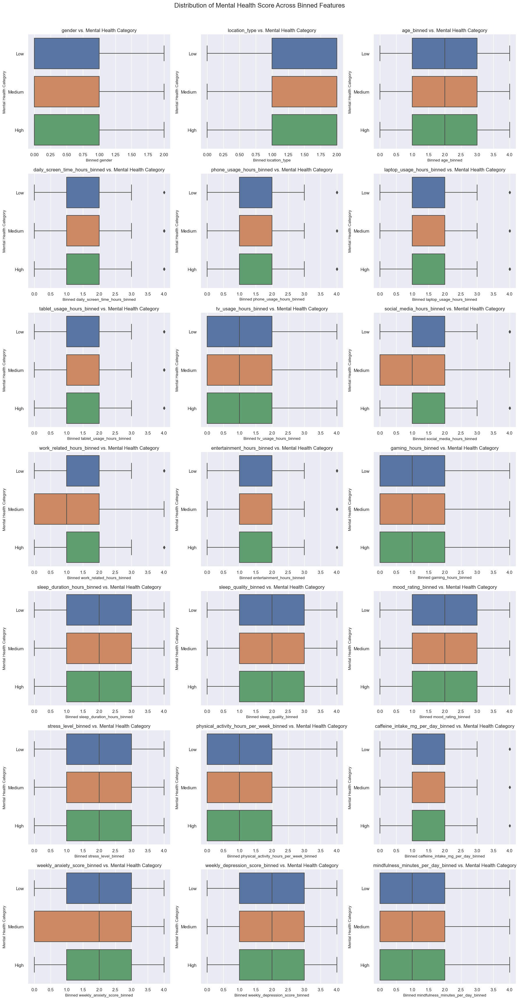


Box plots for all binned numeric variables against the mental health score have been generated.


In [42]:
print("\n--- Visualizing Binned Variables vs. Mental Health Category ---")
# Get all binned columns
binned_cols = [col for col in binned_data.columns if '_binned' in col or col == 'location_type' or col=='gender' ]

n_cols = 3  # Number of columns for subplots
n_rows = (len(binned_cols) + n_cols - 1) // n_cols  # Calculate number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(binned_cols):
    sns.boxplot(x=binned_data[col], y=binned_data['mental_health_category'], ax=axes[i])
    axes[i].set_title(f'{col} vs. Mental Health Category', fontsize=12)
    axes[i].set_xlabel(f'Binned {col}', fontsize=10)
    axes[i].set_ylabel('Mental Health Category', fontsize=10)

# Hide any empty subplots
for j in range(len(binned_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Distribution of Mental Health Score Across Binned Features', y=0.98, fontsize=16)
plt.show()

print("\nBox plots for all binned numeric variables against the mental health score have been generated.")


#### 6.6. Distribution of Mental Health Categories


'mental_health_score' has been binned into 'mental_health_category'.
Value counts for the new category:
mental_health_category
Medium    668
Low       652
High      624
Name: count, dtype: int64


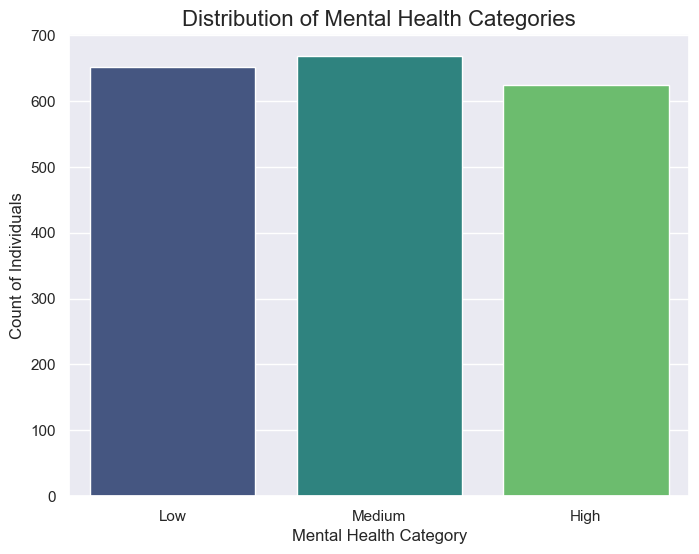


Bar chart for 'mental_health_category' has been generated successfully.
The chart shows the number of individuals in the Low, Medium, and High mental health score categories.


In [43]:
barchart_data = binned_data.copy()

print("\n'mental_health_score' has been binned into 'mental_health_category'.")
print("Value counts for the new category:")
print(barchart_data['mental_health_category'].value_counts())

# Create a bar chart to show the count of each mental health category
plt.figure(figsize=(8, 6))
sns.countplot(x='mental_health_category', data=barchart_data, palette='viridis')
plt.title('Distribution of Mental Health Categories', fontsize=16)
plt.xlabel('Mental Health Category', fontsize=12)
plt.ylabel('Count of Individuals', fontsize=12)
plt.show()

print("\nBar chart for 'mental_health_category' has been generated successfully.")
print("The chart shows the number of individuals in the Low, Medium, and High mental health score categories.")


#### 6.7. Visualizing Binned Variables vs. Mental Health Category


--- Visualizing Binned Variables vs. Mental Health Category ---


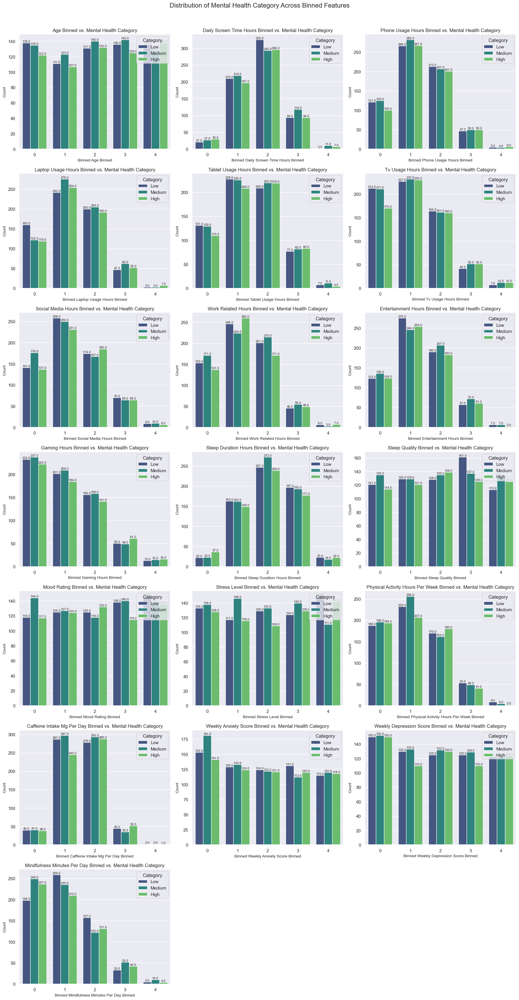


Bar charts for all binned numeric variables against the mental health category have been generated.


In [44]:
print("\n--- Visualizing Binned Variables vs. Mental Health Category ---")

# Get all columns that have been binned
binned_cols = [col for col in barchart_data.columns if '_binned' in col]


n_cols = 3  # Number of columns for subplots
n_rows = (len(binned_cols) + n_cols - 1) // n_cols  # Calculate number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5 * n_rows))
axes = axes.flatten()

for i, col in enumerate(binned_cols):
    ax = axes[i]
    sns.countplot(x=barchart_data[col], hue=barchart_data['mental_health_category'], ax=ax, palette='viridis')
    ax.set_title(f'{col.replace("_", " ").title()} vs. Mental Health Category', fontsize=12)
    ax.set_xlabel(f'Binned {col.replace("_", " ").title()}', fontsize=10)
    ax.set_ylabel('Count', fontsize=10)
    ax.legend(title='Category', loc='upper right')

    # Add exact counts on each bar
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height}', (p.get_x() + p.get_width() / 2., height), ha='center', va='bottom', fontsize=8)


# Hide any empty subplots
for j in range(len(binned_cols), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.suptitle('Distribution of Mental Health Category Across Binned Features', y=0.98, fontsize=16)
plt.show()

print("\nBar charts for all binned numeric variables against the mental health category have been generated.")


#### 6.8. Calculating Mutual Information (on Binned columns)

In [45]:
from sklearn.feature_selection import mutual_info_classif

# Define the target variable (y) and features (X)
y = binned_data['mental_health_category']
X = binned_data.drop(columns=['mental_health_category'])

# --- Estimate Mutual Information for All Features ---
print("\n" + "="*60)
print("--- Mutual Information Scores for All Features ---")
print("="*60)

# Estimate mutual information scores
# The function works well with binned numerical data and categorical data.
mi_scores = mutual_info_classif(X, y, random_state=42)

# Create a DataFrame to display the results
mi_df = pd.DataFrame({'feature': X.columns, 'mutual_info_score': mi_scores})

# Sort the results for easy comparison
mi_df = mi_df.sort_values(by='mutual_info_score', ascending=False)

print("\nMutual Information Scores (Higher value indicates a stronger relationship):")
print(tabulate(mi_df, headers='keys', tablefmt='grid', floatfmt=".4f"))

print("\nMutual Information analysis complete.")



--- Mutual Information Scores for All Features ---

Mutual Information Scores (Higher value indicates a stronger relationship):
+----+-----------------------------------------+---------------------+
|    | feature                                 |   mutual_info_score |
+====+=========================================+=====================+
| 17 | mental_health_score                     |              1.0987 |
+----+-----------------------------------------+---------------------+
| 23 | mindfulness_minutes_per_day             |              0.0312 |
+----+-----------------------------------------+---------------------+
| 36 | sleep_quality_binned                    |              0.0285 |
+----+-----------------------------------------+---------------------+
| 30 | tv_usage_hours_binned                   |              0.0275 |
+----+-----------------------------------------+---------------------+
|  2 | daily_screen_time_hours                 |              0.0194 |
+----+-------------

#### 6.9. Percentage Calculation for Categorical Variables

In [46]:
print("\n" + "="*60)
print("--- Percentage of Occurrence for Categorical Variables ---")
print("="*60)

# List of categorical variables
categorical_vars = ['gender', 'location_type', 'uses_wellness_apps', 'eats_healthy']

# Make sure these columns exist in the binned_data
available_categorical_vars = [col for col in categorical_vars if col in binned_data.columns]

if available_categorical_vars:
    for var in available_categorical_vars:
        # Calculate the value counts and convert to percentages
        value_counts = binned_data[var].value_counts(normalize=True) * 100

        print(f"\nBreakdown for '{var.replace('_', ' ').title()}':")

        # Prepare the data for a table
        percentage_data = []
        for index, value in value_counts.items():
            percentage_data.append([index, f'{value:.2f}%'])

        print(tabulate(percentage_data, headers=["Category", "Percentage"], tablefmt="grid"))
else:
    print("No categorical variables found in the binned dataset.")

print("\nCategorical percentage analysis complete.")


--- Percentage of Occurrence for Categorical Variables ---

Breakdown for 'Gender':
+------------+--------------+
|   Category | Percentage   |
+============+==============+
|          0 | 47.07%       |
+------------+--------------+
|          1 | 43.78%       |
+------------+--------------+
|          2 | 9.16%        |
+------------+--------------+

Breakdown for 'Location Type':
+------------+--------------+
|   Category | Percentage   |
+============+==============+
|          2 | 50.10%       |
+------------+--------------+
|          1 | 30.04%       |
+------------+--------------+
|          0 | 19.86%       |
+------------+--------------+

Breakdown for 'Uses Wellness Apps':
+------------+--------------+
|   Category | Percentage   |
+============+==============+
|          0 | 61.32%       |
+------------+--------------+
|          1 | 38.68%       |
+------------+--------------+

Breakdown for 'Eats Healthy':
+------------+--------------+
|   Category | Percentage   |
+====

In [47]:
binned_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1944 entries, 0 to 1959
Data columns (total 45 columns):
 #   Column                                   Non-Null Count  Dtype   
---  ------                                   --------------  -----   
 0   age                                      1944 non-null   int64   
 1   gender                                   1944 non-null   int32   
 2   daily_screen_time_hours                  1944 non-null   float64 
 3   phone_usage_hours                        1944 non-null   float64 
 4   laptop_usage_hours                       1944 non-null   float64 
 5   tablet_usage_hours                       1944 non-null   float64 
 6   tv_usage_hours                           1944 non-null   float64 
 7   social_media_hours                       1944 non-null   float64 
 8   work_related_hours                       1944 non-null   float64 
 9   entertainment_hours                      1944 non-null   float64 
 10  gaming_hours                             

#### 6.10. Correlation b/w the original variable and binned variables

In [48]:
# Creating a mapping between original and binned variable names
var_pairs = [
    ("daily_screen_time_hours", "daily_screen_time_hours_binned"),
    ("phone_usage_hours", "phone_usage_hours_binned"),
    ("laptop_usage_hours", "laptop_usage_hours_binned"),
    ("tablet_usage_hours", "tablet_usage_hours_binned"),
    ("tv_usage_hours", "tv_usage_hours_binned"),
    ("social_media_hours", "social_media_hours_binned"),
    ("work_related_hours", "work_related_hours_binned"),
    ("entertainment_hours", "entertainment_hours_binned"),
    ("gaming_hours", "gaming_hours_binned"),
    ("sleep_duration_hours", "sleep_duration_hours_binned"),
    ("sleep_quality", "sleep_quality_binned"),
    ("mood_rating", "mood_rating_binned"),
    ("stress_level", "stress_level_binned"),
    ("physical_activity_hours_per_week", "physical_activity_hours_per_week_binned"),
    ("caffeine_intake_mg_per_day", "caffeine_intake_mg_per_day_binned"),
    ("weekly_anxiety_score", "weekly_anxiety_score_binned"),
    ("weekly_depression_score", "weekly_depression_score_binned"),
    ("mindfulness_minutes_per_day", "mindfulness_minutes_per_day_binned")
]

# Calculate correlations
correlation_results = []
for orig, binned in var_pairs:
    if orig in binned_data.columns and binned in binned_data.columns:
        corr = binned_data[orig].corr(binned_data[binned])
        correlation_results.append({"Original": orig, "Binned": binned, "Correlation": corr})

# Convert to DataFrame
corr_df = pd.DataFrame(correlation_results)

print(corr_df)

# Optional: sort by correlation strength
print("\nSorted by correlation:")
print(corr_df.sort_values(by="Correlation", ascending=False))


                            Original                                   Binned  \
0            daily_screen_time_hours           daily_screen_time_hours_binned   
1                  phone_usage_hours                 phone_usage_hours_binned   
2                 laptop_usage_hours                laptop_usage_hours_binned   
3                 tablet_usage_hours                tablet_usage_hours_binned   
4                     tv_usage_hours                    tv_usage_hours_binned   
5                 social_media_hours                social_media_hours_binned   
6                 work_related_hours                work_related_hours_binned   
7                entertainment_hours               entertainment_hours_binned   
8                       gaming_hours                      gaming_hours_binned   
9               sleep_duration_hours              sleep_duration_hours_binned   
10                     sleep_quality                     sleep_quality_binned   
11                       moo

In [49]:
corr_df

,Original,Binned,Correlation
0,daily_screen_time_hours,daily_screen_time_hours_binned,0.931124
1,phone_usage_hours,phone_usage_hours_binned,0.940820
2,laptop_usage_hours,laptop_usage_hours_binned,0.946634
3,tablet_usage_hours,tablet_usage_hours_binned,0.954495
4,tv_usage_hours,tv_usage_hours_binned,0.957084
5,social_media_hours,social_media_hours_binned,0.952960
6,work_related_hours,work_related_hours_binned,0.950753
7,entertainment_hours,entertainment_hours_binned,0.948388
8,gaming_hours,gaming_hours_binned,0.959223
9,sleep_duration_hours,sleep_duration_hours_binned,0.948093


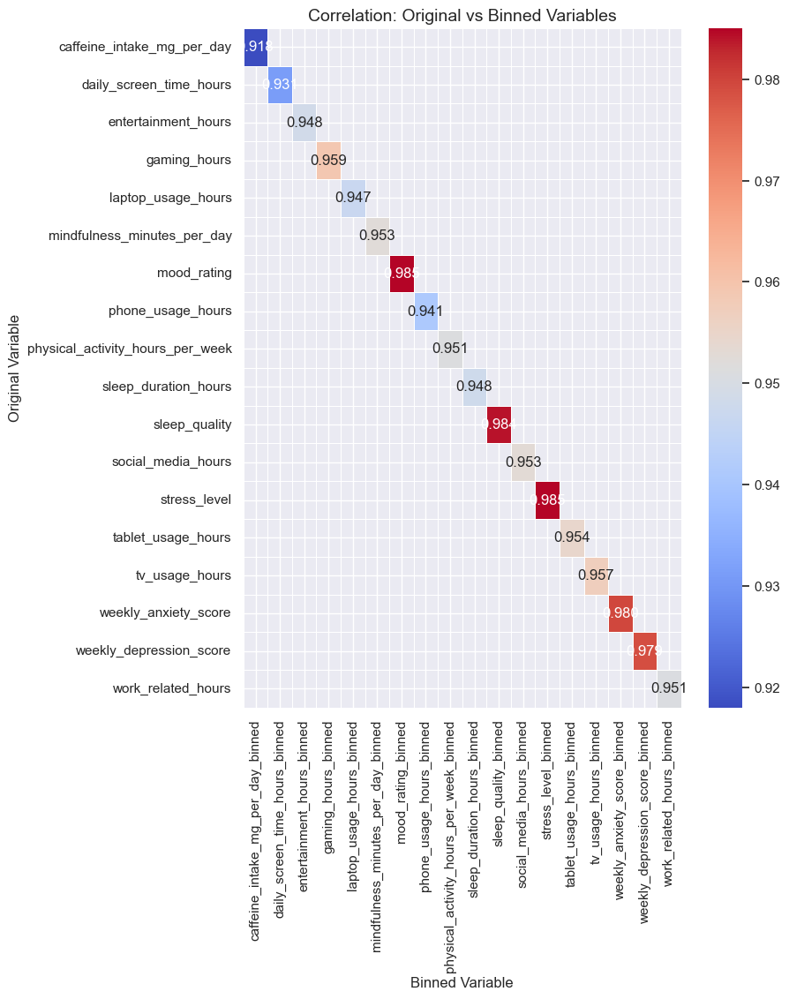

In [50]:
import seaborn as sns
import matplotlib.pyplot as plt

# Use the correlation DataFrame you already created
plt.figure(figsize=(8, 10))
sns.heatmap(
    corr_df.pivot(index="Original", columns="Binned", values="Correlation"),
    annot=True, fmt=".3f", cmap="coolwarm", cbar=True, linewidths=0.5
)
plt.title("Correlation: Original vs Binned Variables", fontsize=14)
plt.ylabel("Original Variable")
plt.xlabel("Binned Variable")
plt.show()

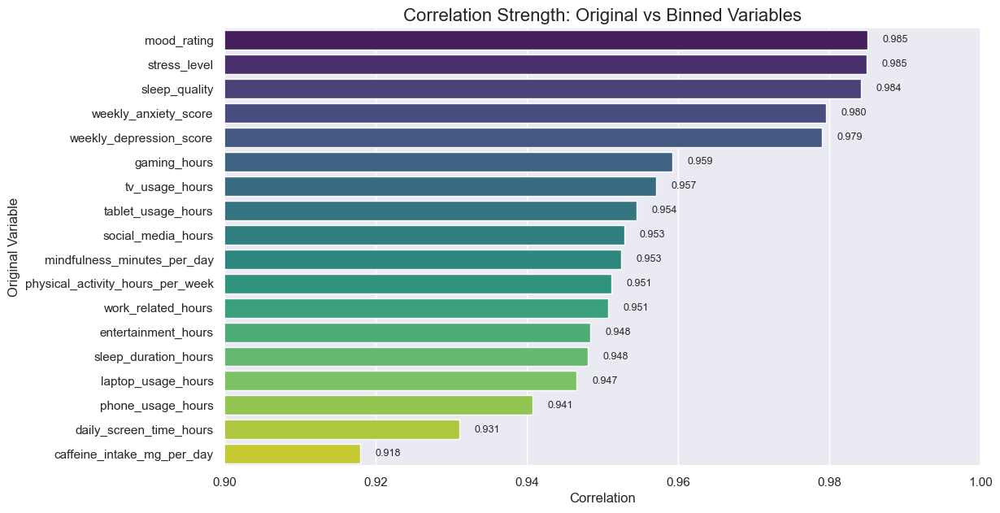

In [51]:
# Sort correlations for better readability
corr_sorted = corr_df.sort_values(by="Correlation", ascending=False)

plt.figure(figsize=(12, 7))
sns.barplot(data=corr_sorted, x="Correlation", y="Original", palette="viridis")

# Add values on bars
for i, val in enumerate(corr_sorted["Correlation"]):
    plt.text(val + 0.002, i, f"{val:.3f}", va="center", fontsize=9)

plt.title("Correlation Strength: Original vs Binned Variables", fontsize=16)
plt.xlabel("Correlation", fontsize=12)
plt.ylabel("Original Variable", fontsize=12)
plt.xlim(0.9, 1.0)  # zoom in since all correlations are high
plt.show()

#### 6.11. Categorical Variable Percentage

In [52]:
def categorical_variable_pct(df, categorical_vars):

    results = {}
    for col in categorical_vars:
        if col in df.columns:
            counts = df[col].value_counts(normalize=True) * 100  # convert to %
            results[col] = counts.round(2)  # round to 2 decimals
    return results

# Example: categorical columns from your dataset
categorical_vars = ["gender", "location_type", "uses_wellness_apps", "eats_healthy", "mental_health_category"]

cat_pct = categorical_variable_pct(binned_data, categorical_vars)

# Display nicely
for col, dist in cat_pct.items():
    print(f"\n{col} distribution (%):")
    print(dist)



gender distribution (%):
gender
0    47.07
1    43.78
2     9.16
Name: proportion, dtype: float64

location_type distribution (%):
location_type
2    50.10
1    30.04
0    19.86
Name: proportion, dtype: float64

uses_wellness_apps distribution (%):
uses_wellness_apps
0    61.32
1    38.68
Name: proportion, dtype: float64

eats_healthy distribution (%):
eats_healthy
1    50.31
0    49.69
Name: proportion, dtype: float64

mental_health_category distribution (%):
mental_health_category
Medium    34.36
Low       33.54
High      32.10
Name: proportion, dtype: float64


#### 6.12. Graph for categorical columns

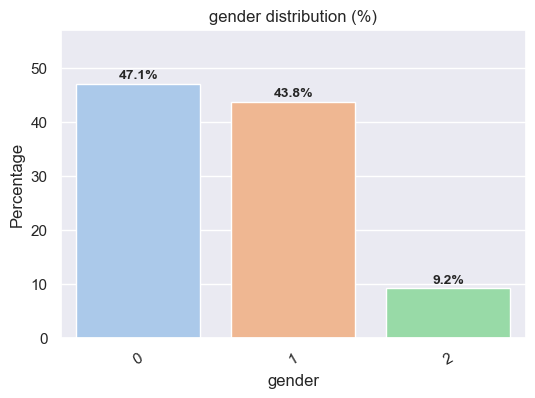

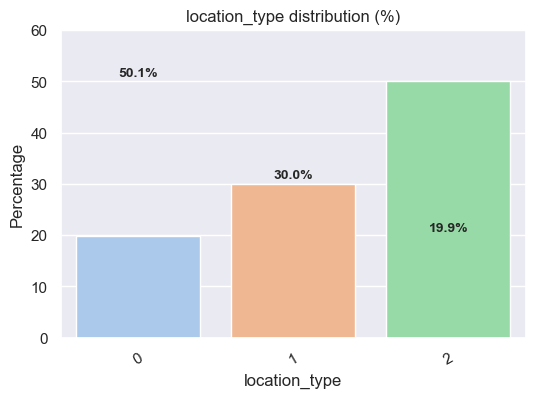

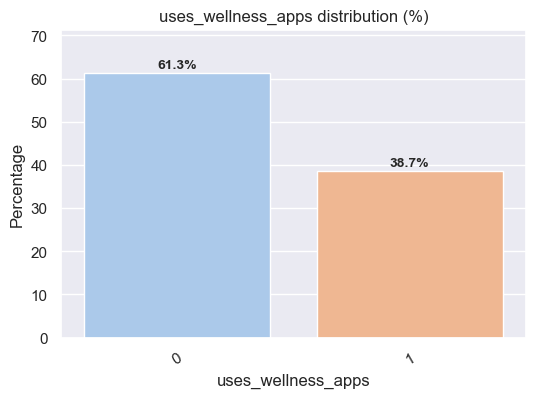

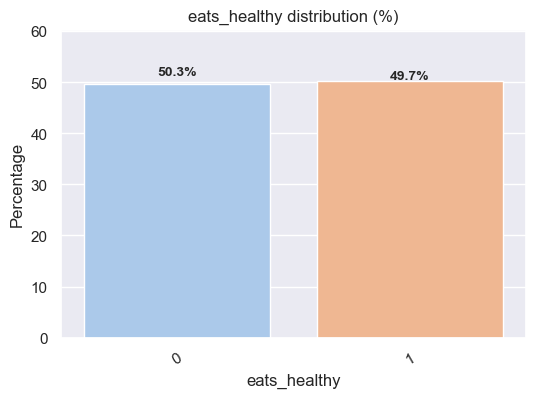

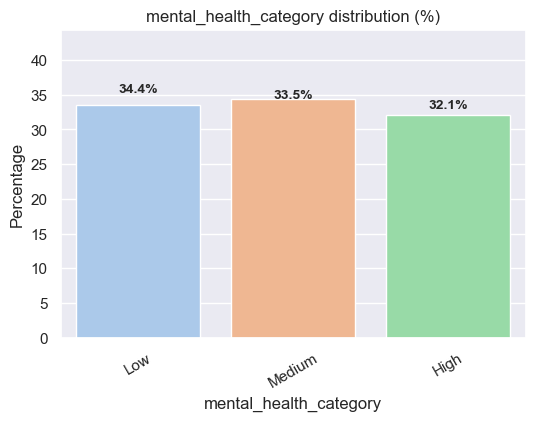

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_categorical_pct(df, categorical_vars):
    for col in categorical_vars:
        if col in df.columns:
            plt.figure(figsize=(6,4))
            pct = df[col].value_counts(normalize=True) * 100
            ax = sns.barplot(x=pct.index, y=pct.values, palette="pastel")

            # Adding percentage labels on top of bars
            for i, v in enumerate(pct.values):
                ax.text(i, v + 1, f"{v:.1f}%", ha='center', fontsize=10, fontweight='bold')

            plt.title(f"{col} distribution (%)")
            plt.ylabel("Percentage")
            plt.xlabel(col)
            plt.xticks(rotation=30)
            plt.ylim(0, pct.values.max() + 10)  # leave some space for labels
            plt.show()


categorical_vars = ["gender", "location_type", "uses_wellness_apps", "eats_healthy", "mental_health_category"]


plot_categorical_pct(binned_data, categorical_vars)


### 07. Feature Transformations

In [54]:
from sklearn.preprocessing import LabelEncoder, MinMaxScaler

scaled_data=binned_data.copy()

original_numerical_cols = [
    'age', 'daily_screen_time_hours', 'phone_usage_hours', 'laptop_usage_hours',
    'tablet_usage_hours', 'tv_usage_hours', 'social_media_hours',
    'work_related_hours', 'entertainment_hours', 'gaming_hours',
    'sleep_duration_hours', 'sleep_quality', 'mood_rating', 'stress_level',
    'physical_activity_hours_per_week',
    'caffeine_intake_mg_per_day', 'weekly_anxiety_score', 'weekly_depression_score',
    'mindfulness_minutes_per_day'
]

# Check if all columns exist in the DataFrame before scaling
cols_to_scale = [col for col in original_numerical_cols if col in scaled_data.columns]
missing_cols = [col for col in original_numerical_cols if col not in scaled_data.columns]

if missing_cols:
    print(f"\nWarning: The following columns were not found in the dataset and will be skipped: {missing_cols}")

if not cols_to_scale:
    print("Error: No valid numerical columns were found to scale.")
    exit()

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Apply the scaler to the selected columns
scaled_data[cols_to_scale] = scaler.fit_transform(scaled_data[cols_to_scale])

scaled_data.head(7)

,age,gender,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,...,gaming_hours_binned,sleep_duration_hours_binned,sleep_quality_binned,mood_rating_binned,stress_level_binned,physical_activity_hours_per_week_binned,caffeine_intake_mg_per_day_binned,weekly_anxiety_score_binned,weekly_depression_score_binned,mindfulness_minutes_per_day_binned
0,0.745098,0,0.360902,0.404762,0.232143,0.64,0.340426,0.706897,0.338983,0.147059,...,2,2,2,2,4,0,1,3,3,0
1,1.000000,1,0.293233,0.416667,0.321429,0.36,0.425532,0.465517,0.525424,0.147059,...,1,1,3,2,2,2,2,4,4,0
2,0.549020,2,0.789474,0.250000,0.464286,0.28,0.468085,0.517241,0.474576,0.602941,...,2,2,4,2,2,1,2,1,0,0
3,0.274510,2,0.661654,0.000000,0.000000,0.28,0.531915,0.568966,0.271186,0.191176,...,0,1,4,4,2,0,0,1,0,0
4,0.823529,1,0.443609,0.202381,0.196429,0.60,0.340426,0.189655,0.610169,0.117647,...,0,3,0,3,3,1,2,1,2,0
5,0.137255,0,0.744361,0.380952,0.482143,0.48,0.702128,0.275862,0.423729,0.485294,...,3,2,1,4,0,1,1,4,3,1
6,0.392157,1,0.436090,0.476190,0.571429,0.76,0.276596,0.155172,0.288136,0.691176,...,1,2,1,0,4,3,2,1,0,1


#### Minor Data cleaning before building the model.

In [55]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder
# --------------- RAW DATA (data) -------------------------
data.drop(columns=['user_id',
    'IForest',
    'LOF',
    'OneClassSVM',
    'EllipticEnvelope',
    'IQR',
    'Common_Outlier'], axis=1, inplace=True)


In [56]:
numerical_cols = data.select_dtypes(include=['number']).columns.tolist()
categorical_cols = data.select_dtypes(include=['object', 'category']).columns.tolist()
scaler = StandardScaler()
data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

le = LabelEncoder()
for col in categorical_cols:
    try:
        # Fit and transform the column
        data[col] = le.fit_transform(data[col])
        print(f"Label Encoded column: {col}")
    except Exception as e:
        print(f"Could not Label Encode column {col}: {e}")

Label Encoded column: gender
Label Encoded column: location_type


In [57]:
#----------------- cleaned_data ------------------------------------

cleaned_data.drop(columns=['user_id'], axis=1, inplace=True)   

numerical_cols = cleaned_data.select_dtypes(include=['number']).columns.tolist()
categorical_cols = cleaned_data.select_dtypes(include=['object', 'category']).columns.tolist()
scaler = StandardScaler()
cleaned_data[numerical_cols] = scaler.fit_transform(cleaned_data[numerical_cols])

le = LabelEncoder()
for col in categorical_cols:
    try:
        # Fit and transform the column
        cleaned_data[col] = le.fit_transform(cleaned_data[col])
        print(f"Label Encoded column: {col}")
    except Exception as e:
        print(f"Could not Label Encode column {col}: {e}")

Label Encoded column: gender
Label Encoded column: location_type


In [58]:
#------------------------ binned_data ----------------------------------

numerical_cols = binned_data.select_dtypes(include=['number']).columns.tolist()
categorical_cols = binned_data.select_dtypes(include=['object', 'category']).columns.tolist()
scaler = StandardScaler()
binned_data[numerical_cols] = scaler.fit_transform(binned_data[numerical_cols])


le = LabelEncoder()
for col in categorical_cols:
    try:
        # Fit and transform the column
        binned_data[col] = le.fit_transform(binned_data[col])
        print(f"Label Encoded column: {col}")
    except Exception as e:
        print(f"Could not Label Encode column {col}: {e}")


Label Encoded column: mental_health_category


## Modeling


#### Definining Utility Functions

In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV, learning_curve
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor, VotingRegressor
from sklearn.svm import SVR, LinearSVR 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from sklearn.preprocessing import StandardScaler
import warnings

# Suppress all warnings for cleaner output (use with caution in production)
warnings.filterwarnings('ignore')

# --- Global Configuration ---
TARGET_COL = 'mental_health_score' 
RANDOM_STATE = 42
N_SPLITS = 3 # Reduced CV folds for faster execution (from 5 or 10)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

# Initialize the main results DataFrame
COLUMNS = [
    'Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Best_Params', 
    'Feature_Count', 'Bins_>25%', 'Bins_5-25%', 'Bins_<-5%', 'Bins_-5- -25%', 
    'Bins_<-25%', 'Bins_<5%', 'Bins_0%'
]
ALL_RESULTS_DF = pd.DataFrame(columns=COLUMNS)


# --- Custom Metrics and Functions ---

def smape(y_true, y_pred):
    """Symmetric Mean Absolute Percentage Error (SMAPE)"""
    numerator = np.abs(y_pred - y_true)
    denominator = (np.abs(y_true) + np.abs(y_pred)) / 2
    return np.mean(numerator / denominator) * 100

def calculate_metrics_and_bins(y_true, y_pred, model_name, model_type, dataset_name, cv_score=None, best_params=None, feature_count=None):
    """Calculates all metrics and error bins and logs results."""
    
    global ALL_RESULTS_DF
    
    # Calculate Metrics
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mape = mean_absolute_percentage_error(y_true, y_pred) * 100
    s_mape = smape(y_true, y_pred)
    
    # Calculate percentage error and Bins
    epsilon = 1e-10 
    percent_error = ((y_pred - y_true) / (y_true + epsilon)) * 100
    
    bins = {
        'Bins_>25%': (percent_error > 25).sum(),
        'Bins_5-25%': ((percent_error >= 5) & (percent_error <= 25)).sum(),
        'Bins_<-5%': (percent_error < -5).sum(),
        'Bins_-5- -25%': ((percent_error <= -5) & (percent_error >= -25)).sum(),
        'Bins_<-25%': (percent_error < -25).sum(),
        'Bins_<5%': ((percent_error >= 0) & (percent_error < 5)).sum(),
        'Bins_0%': (percent_error == 0).sum(),
    }
    
    # Prepare results for the DataFrame
    new_row = pd.Series({
        'Model': model_name,
        'Type': model_type,
        'Dataset': dataset_name,
        'MAPE': mape,
        'SMAPE': s_mape,
        'RMSE': rmse,
        'CV_Score': cv_score,
        'Best_Params': str(best_params),
        'Feature_Count': feature_count,
        **bins
    })
    
    ALL_RESULTS_DF = pd.concat([ALL_RESULTS_DF, new_row.to_frame().T], ignore_index=True)
    
    return y_true, y_pred, mape, bins


def plot_learning_curve(model, X, y, model_name, model_type, dataset_name, scoring='neg_root_mean_squared_error'):
    """Generates and plots a learning curve."""
    
    # Generate 5 data points for the curve
    train_sizes, train_scores, test_scores = learning_curve(
        model, X, y, cv=N_SPLITS, n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 5), scoring=scoring
    )

    # Convert negative RMSE to positive RMSE
    train_scores_mean = np.mean(-train_scores, axis=1)
    test_scores_mean = np.mean(-test_scores, axis=1)
    
    plt.figure(figsize=(8, 5))
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score (RMSE)")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation score (RMSE)")
    
    plt.title(f'Learning Curve: {model_name} ({model_type} - {dataset_name})')
    plt.xlabel("Training Examples")
    plt.ylabel("Root Mean Squared Error (RMSE)")
    plt.legend(loc="best")
    plt.grid()
    plt.show()


def plot_results(y_true, y_pred, model, X_test_df, y_test, model_name, model_type, dataset_name, bins, X_train_fit, y_train_fit, feature_count):
    """Generates Scatter Plot, Error Bin Graph, and Learning Curve."""
    
    # Create a single figure for the Scatter and Error Bin plots
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plt.suptitle(f'{model_name} ({model_type}) - Dataset: {dataset_name} (Features: {feature_count})', fontsize=16)

    # --- 1. Scatter Plot (Actual vs. Predicted) ---
    axes[0].scatter(y_true, y_pred, alpha=0.6, edgecolors='w', linewidth=0.5)
    min_val = min(y_true.min(), y_pred.min())
    max_val = max(y_true.max(), y_pred.max())
    axes[0].plot([min_val, max_val], [min_val, max_val], 'r--', label='Ideal Fit')
    axes[0].set_xlabel('Actual Values', fontsize=12)
    axes[0].set_ylabel('Predicted Values', fontsize=12)
    axes[0].set_title('Scatter Plot (Actual vs. Predicted)')
    axes[0].legend()
    axes[0].grid(True, linestyle='--', alpha=0.6)

    # --- 2. Error Bin Graph ---
    bin_labels = list(bins.keys())
    bin_values = list(bins.values())
    
    axes[1].barh(bin_labels, bin_values, color=sns.color_palette("viridis", len(bin_labels)))
    axes[1].set_xlabel('Number of Samples', fontsize=12)
    axes[1].set_title('Error Percentage Bins')
    
    for i, v in enumerate(bin_values):
        axes[1].text(v + 0.5, i, str(v), color='black', va='center')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    
    # --- 3. Learning Curve (Separate Plot) ---
    # Note: Use the full training set (X_train_fit, y_train_fit) for the learning curve generation
    plot_learning_curve(model, X_train_fit, y_train_fit, model_name, model_type, dataset_name)


def plot_final_summary_charts(model_key):
    """Plots the overall MAPE for all variations of the current model across all datasets."""
    
    df_model = ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == model_key].copy()
    
    if df_model.empty:
        return

    # Create a combined identifier for easier plotting
    df_model['Run'] = df_model['Dataset'] + '_' + df_model['Type']
    
    plt.figure(figsize=(14, 7))
    sns.barplot(x='Run', y='MAPE', data=df_model, palette='Spectral')
    plt.title(f'Mean Absolute Percentage Error (MAPE) Comparison for {model_key}', fontsize=16)
    plt.xlabel('Run (Dataset_Type)', fontsize=12)
    plt.ylabel('MAPE (%)', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Add MAPE values on top of bars
    for index, row in df_model.iterrows():
        plt.text(index, row['MAPE'] + 0.1, f"{row['MAPE']:.2f}", color='black', ha="center")
        
    plt.tight_layout()
    plt.show()

def display_best_params(model_key):
    """Displays the best parameters found for the Tuned models."""
    df_params = ALL_RESULTS_DF[(ALL_RESULTS_DF['Model'] == model_key) & (ALL_RESULTS_DF['Type'] == 'Tuned')][['Dataset', 'Best_Params']].copy()
    print(f"\n--- Best Parameters for Tuned {model_key} Models ---")
    print(df_params.reset_index(drop=True))


# --- Placeholder DataFrames (REPLACE THIS WITH YOUR ACTUAL DATA) ---
np.random.seed(RANDOM_STATE)
N = 500
feature_names = [f'F_{i}' for i in range(10)]
X_common = pd.DataFrame(np.random.rand(N, 10), columns=feature_names)

# Define target variables with meaningful names
y_data = X_common['F_0'] * 5 + X_common['F_1'] * 2 + np.random.randn(N) * 0.5
y_cleaned = X_common['F_2'] * 8 - X_common['F_3'] * 3 + np.random.randn(N) * 1.0
y_binned = X_common['F_4'] * 1 + np.random.randn(N) * 2.0

# Assign the target column 'mental_health_score' to each dataframe
data = X_common.copy()
data[TARGET_COL] = y_data
cleaned_data = X_common.copy()
cleaned_data[TARGET_COL] = y_cleaned
binned_data = X_common.copy()
binned_data[TARGET_COL] = y_binned

# List of datasets to iterate over
DATASETS = {
    'data': data,
    'cleaned_data': cleaned_data,
    'binned_data': binned_data
}


# --- 2. Optimized Model Configuration ---
MODEL_CONFIGS = {
    'LinearRegression': {
        'model': LinearRegression(),
        'rfecv_estimator': LinearRegression(),
        'params': {}, 
        'type': 'Linear'
    },
    'Ridge': {
        'model': Ridge(random_state=RANDOM_STATE),
        'rfecv_estimator': Ridge(random_state=RANDOM_STATE),
        'params': {'alpha': [0.1, 1.0]},
        'type': 'Linear'
    },
    'Lasso': {
        'model': Lasso(random_state=RANDOM_STATE, max_iter=100), 
        'rfecv_estimator': Lasso(random_state=RANDOM_STATE, max_iter=100), 
        'params': {'alpha': [0.01, 0.1]},
        'type': 'Linear'
    },
    'ElasticNet': {
        'model': ElasticNet(random_state=RANDOM_STATE, max_iter=100), 
        'rfecv_estimator': ElasticNet(random_state=RANDOM_STATE, max_iter=100), 
        'params': {'alpha': [0.1, 1.0], 'l1_ratio': [0.5, 0.9]},
        'type': 'Linear'
    },
    'DecisionTree': {
        'model': DecisionTreeRegressor(random_state=RANDOM_STATE),
        'rfecv_estimator': DecisionTreeRegressor(random_state=RANDOM_STATE),
        'params': {'max_depth': [5, 10]},
        'type': 'Tree'
    },
    'RandomForest': {
        'model': RandomForestRegressor(random_state=RANDOM_STATE, n_jobs=-1),
        'rfecv_estimator': RandomForestRegressor(random_state=RANDOM_STATE),
        'params': {'n_estimators': [50, 100], 'max_depth': [5]}, 
        'type': 'Tree'
    },
    'ExtraTrees': {
        'model': ExtraTreesRegressor(random_state=RANDOM_STATE, n_jobs=-1),
        'rfecv_estimator': ExtraTreesRegressor(random_state=RANDOM_STATE),
        'params': {'n_estimators': [50, 100], 'max_depth': [5]}, 
        'type': 'Tree'
    },
    # Gradient Boosting is fully included in the RFECV loop below
    'GradientBoosting': {
        'model': GradientBoostingRegressor(random_state=RANDOM_STATE),
        'rfecv_estimator': GradientBoostingRegressor(random_state=RANDOM_STATE),
        'params': {'n_estimators': [50, 100], 'learning_rate': [0.1]}, 
        'type': 'Tree'
    },
    'SVR': {
        'model': SVR(),
        'rfecv_estimator': LinearSVR(random_state=RANDOM_STATE, max_iter=5000, dual=False,loss='squared_epsilon_insensitive'),
        'params': {'C': [0.1, 1.0], 'kernel': ['rbf']}, 
        'type': 'Kernel'
    },
    'KNN': {
        'model': KNeighborsRegressor(n_jobs=-1),
        'rfecv_estimator': DecisionTreeRegressor(random_state=RANDOM_STATE, max_depth=3),
        'params': {'n_neighbors': [3, 5], 'weights': ['distance']}, 
        'type': 'Distance'
    }
}

# --- 3. The Core Modeling Function ---

def run_all_model_variations(model_key):
    """
    Executes Normal, Tuned, RFECV, and Averaged Ensemble variations
    for a given model across all datasets.
    """
    config = MODEL_CONFIGS[model_key]
    base_model = config['model']
    rfecv_estimator = config['rfecv_estimator']
    param_grid = config['params']
    
    print(f"--- Starting Modeling for: {model_key} ---")

    for dataset_name, df in DATASETS.items():
        print(f"\n--- Processing Dataset: {dataset_name} ---")
        
        X = df.drop(columns=[TARGET_COL])
        y = df[TARGET_COL]
        
        # Scaling is applied to the features
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X)
        X_scaled = pd.DataFrame(X_scaled, columns=X.columns)
        
        X_train, X_test, y_train, y_test = train_test_split(
            X_scaled, y, test_size=0.2, random_state=RANDOM_STATE
        )
        
        # Local variable to store best params for RFECV/Ensemble
        best_params = base_model.get_params()
        cv_score = None
        
        # --- 1. Normal Model ---
        print("  1. Training Normal Model...")
        model_normal = base_model.__class__().set_params(**base_model.get_params())
        model_normal.fit(X_train, y_train)
        y_pred_normal = model_normal.predict(X_test)
        
        # Calculate CV score and log metrics
        cv_score = cross_val_score(model_normal, X_train, y_train, cv=N_SPLITS, scoring='neg_root_mean_squared_error').mean() * -1
        
        y_true, y_pred, mape, bins = calculate_metrics_and_bins(
            y_test, y_pred_normal, model_key, 'Normal', dataset_name, cv_score=cv_score, feature_count=X_train.shape[1]
        )
        # Plot Scatter, Bins, and Learning Curve
        plot_results(y_true, y_pred, model_normal, X_test, y_test, model_key, 'Normal', dataset_name, bins, X_train, y_train, X_train.shape[1])

        # --- 2. Tuned Model (GridSearchCV) ---
        if param_grid:
            print("  2. Tuning Model with GridSearchCV...")
            grid_search = GridSearchCV(base_model, param_grid, cv=N_SPLITS, scoring='neg_root_mean_squared_error', n_jobs=-1)
            grid_search.fit(X_train, y_train)
            
            model_tuned = grid_search.best_estimator_
            best_params = grid_search.best_params_ # Store best params for later use
            cv_score_tuned = grid_search.best_score_ * -1
            
            y_pred_tuned = model_tuned.predict(X_test)
            
            y_true, y_pred, mape, bins = calculate_metrics_and_bins(
                y_test, y_pred_tuned, model_key, 'Tuned', dataset_name, cv_score=cv_score_tuned, best_params=best_params, feature_count=X_train.shape[1]
            )
            plot_results(y_true, y_pred, model_tuned, X_test, y_test, model_key, 'Tuned', dataset_name, bins, X_train, y_train, X_train.shape[1])
        else:
            # If no tuning, copy Normal results for "Tuned" category (for comparison purposes)
            print("  2. Skipping Tuning. Copying Normal results.")
            model_tuned = model_normal
            cv_score_tuned = cv_score
            y_pred_tuned = y_pred_normal
            
            y_true, y_pred, mape, bins = calculate_metrics_and_bins(
                y_test, y_pred_tuned, model_key, 'Tuned', dataset_name, cv_score=cv_score_tuned, best_params=None, feature_count=X_train.shape[1]
            )
            plot_results(y_true, y_pred, model_tuned, X_test, y_test, model_key, 'Tuned', dataset_name, bins, X_train, y_train, X_train.shape[1])


        # --- 3. RFECV Feature Selection + Model ---
        # *** THIS IS WHERE GRADIENT BOOSTING RFECV IS EXECUTED ***
        print("  3. Running RFECV Feature Selection...")
        # Note: Using the non-tuned version of the model for RFECV initialization for robustness
        selector = RFECV(
            rfecv_estimator,
            step=1,
            cv=KFold(N_SPLITS, shuffle=True, random_state=RANDOM_STATE),
            scoring='neg_root_mean_squared_error',
            n_jobs=-1
        )
        selector.fit(X_train, y_train)
        
        X_train_rfe = X_train.loc[:, selector.support_]
        X_test_rfe = X_test.loc[:, selector.support_]
        selected_features = X_train_rfe.columns.tolist()
        
        # Retrain RFE model using the best found parameters (best_params)
        model_rfe = base_model.__class__().set_params(**best_params)
            
        model_rfe.fit(X_train_rfe, y_train)
        y_pred_rfe = model_rfe.predict(X_test_rfe)
        
        cv_score_rfe = cross_val_score(model_rfe, X_train_rfe, y_train, cv=N_SPLITS, scoring='neg_root_mean_squared_error').mean() * -1
        
        y_true, y_pred, mape, bins = calculate_metrics_and_bins(
            y_test, y_pred_rfe, model_key, 'RFECV', dataset_name, cv_score=cv_score_rfe, feature_count=len(selected_features)
        )
        plot_results(y_true, y_pred, model_rfe, X_test_rfe, y_test, model_key, 'RFECV', dataset_name, bins, X_train_rfe, y_train, len(selected_features))

        # --- 4. Averaged Ensemble Model ---
        print("  4. Creating Averaged Ensemble...")
        # Use the best tuned model + two fast ensemble models (50 estimators for speed)
        estimators = [
            (model_key, model_tuned),
            ('GB', GradientBoostingRegressor(n_estimators=50, random_state=RANDOM_STATE)),
            ('ET', ExtraTreesRegressor(n_estimators=50, random_state=RANDOM_STATE, n_jobs=-1))
        ]
        
        model_avg_ensemble = VotingRegressor(estimators=estimators, n_jobs=-1)
        model_avg_ensemble.fit(X_train, y_train)
        y_pred_avg_ensemble = model_avg_ensemble.predict(X_test)

        cv_score_avg = cross_val_score(model_avg_ensemble, X_train, y_train, cv=N_SPLITS, scoring='neg_root_mean_squared_error', n_jobs=-1).mean() * -1
        
        y_true, y_pred, mape, bins = calculate_metrics_and_bins(
            y_test, y_pred_avg_ensemble, model_key, 'Averaged_Ensemble', dataset_name, cv_score=cv_score_avg, feature_count=X_train.shape[1]
        )
        plot_results(y_true, y_pred, model_avg_ensemble, X_test, y_test, model_key, 'Averaged_Ensemble', dataset_name, bins, X_train, y_train, X_train.shape[1])
    
    print(f"--- Finished Modeling for: {model_key} ---")
    
    # After all datasets are done for the current model, plot the final MAPE bar chart
    plot_final_summary_charts(model_key)



# FINAL EXECUTION BLOCK

### 1. LinearRegression

--- Starting Modeling for: LinearRegression ---

--- Processing Dataset: data ---
  1. Training Normal Model...


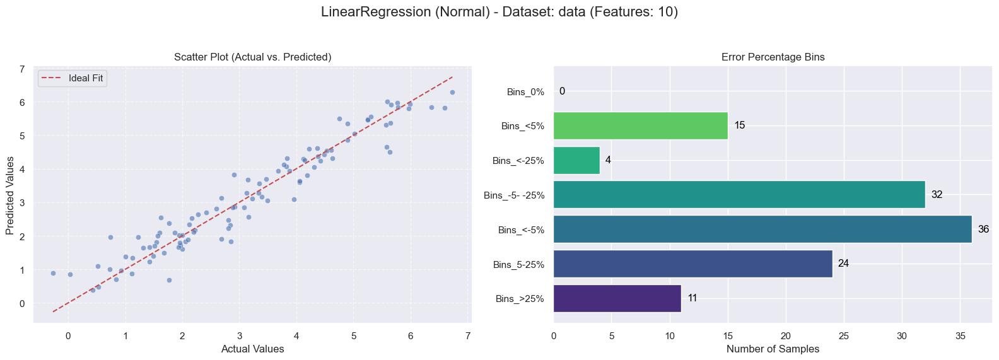

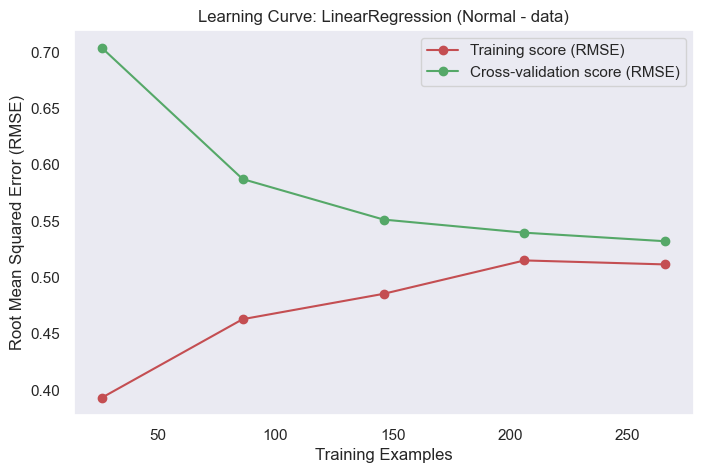

  2. Skipping Tuning. Copying Normal results.


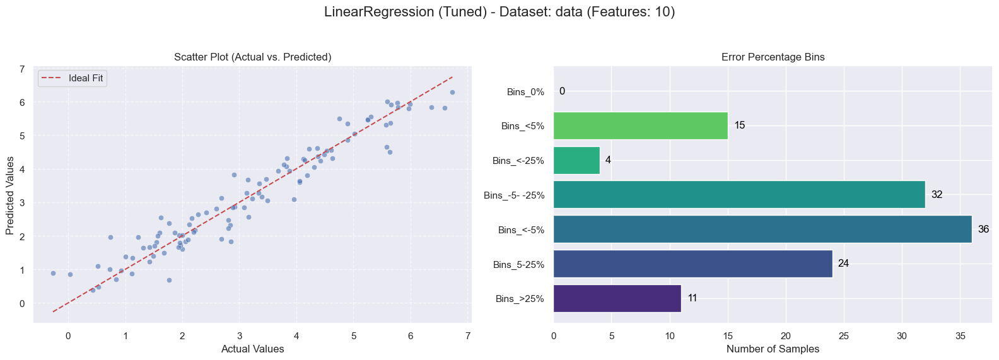

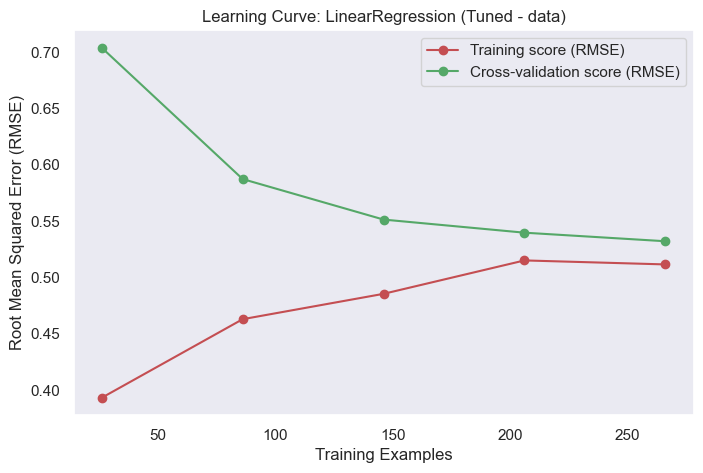

  3. Running RFECV Feature Selection...


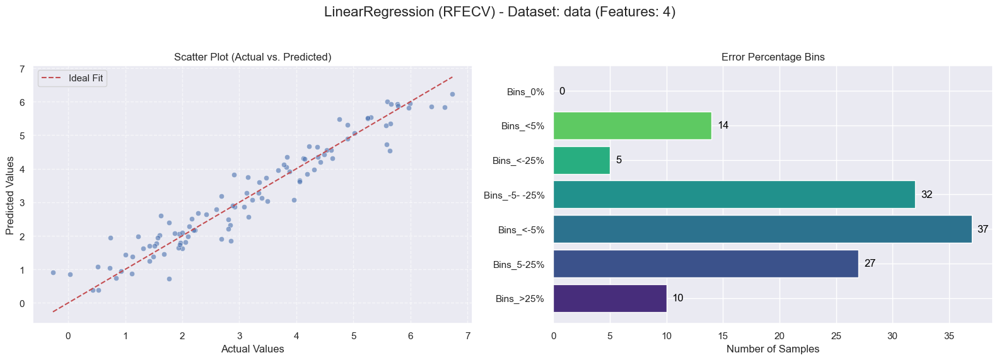

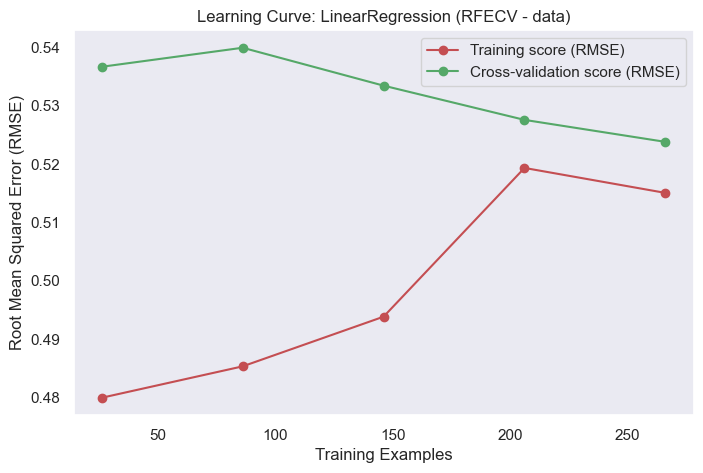

  4. Creating Averaged Ensemble...


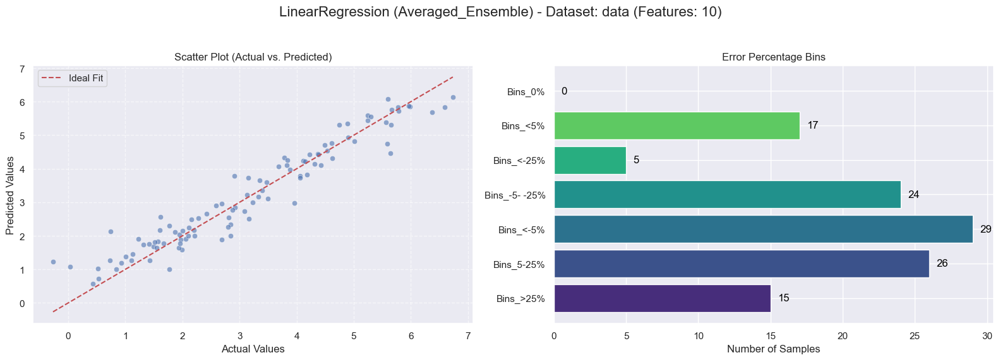

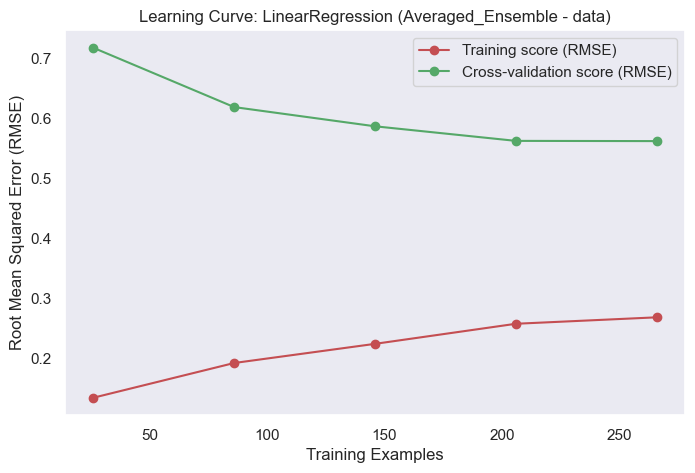


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


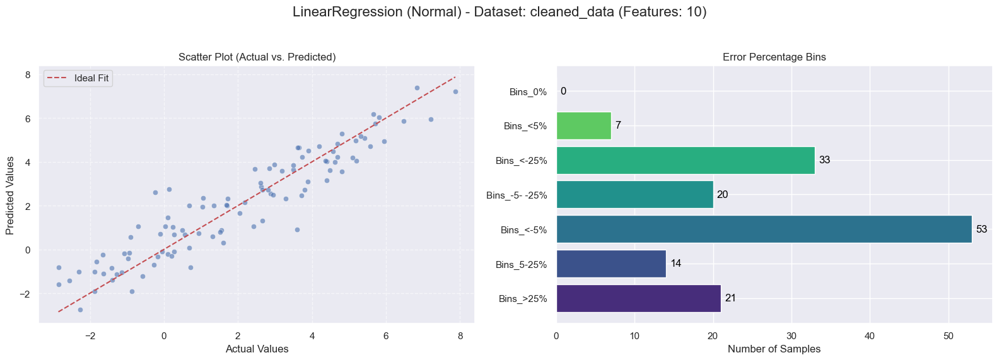

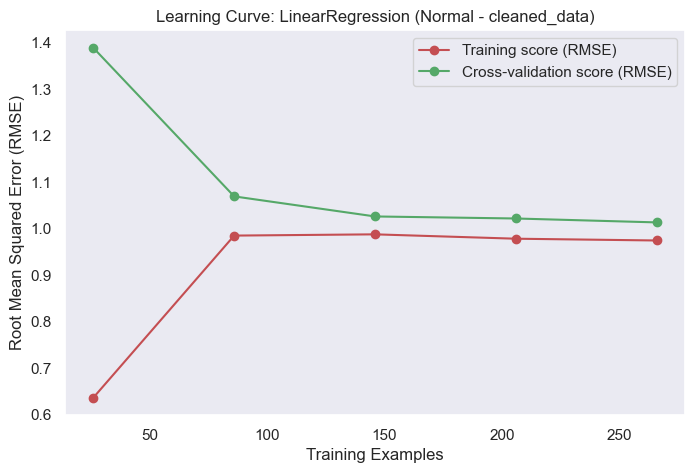

  2. Skipping Tuning. Copying Normal results.


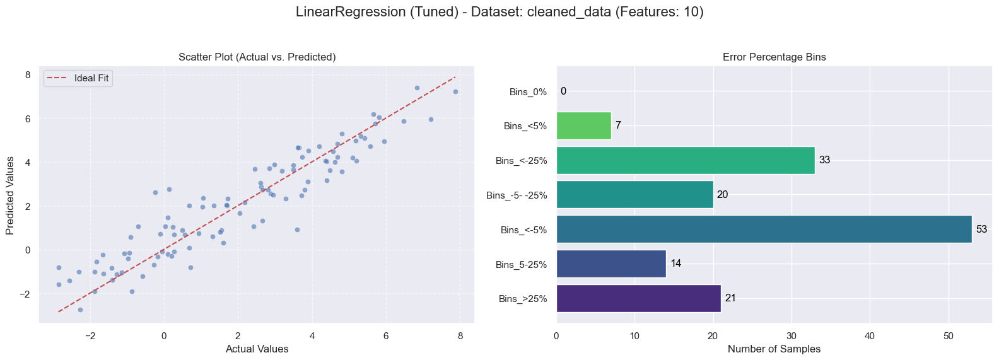

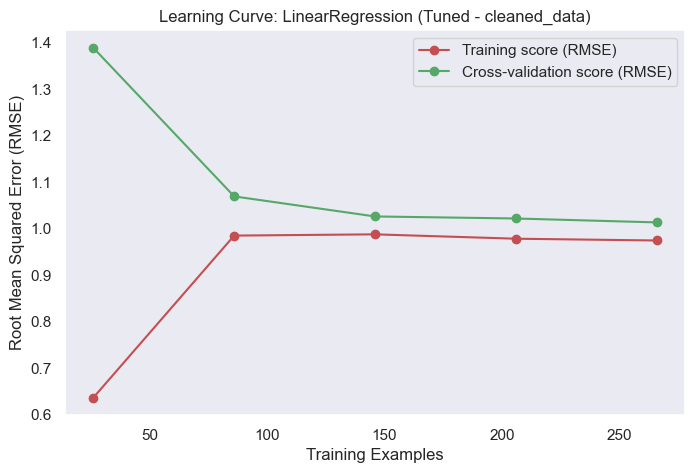

  3. Running RFECV Feature Selection...


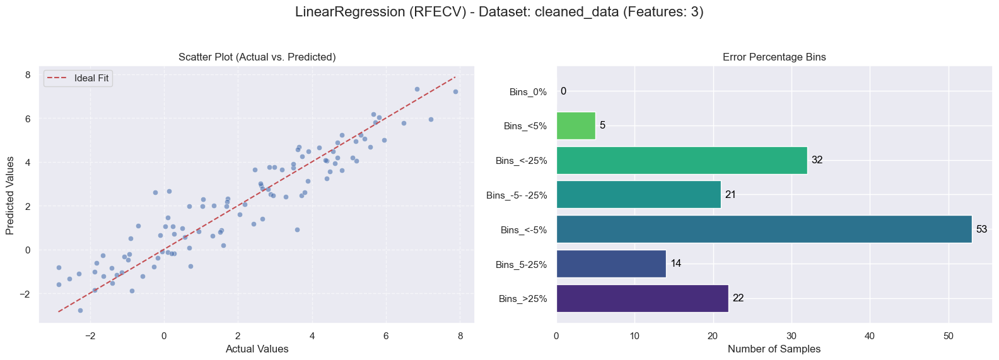

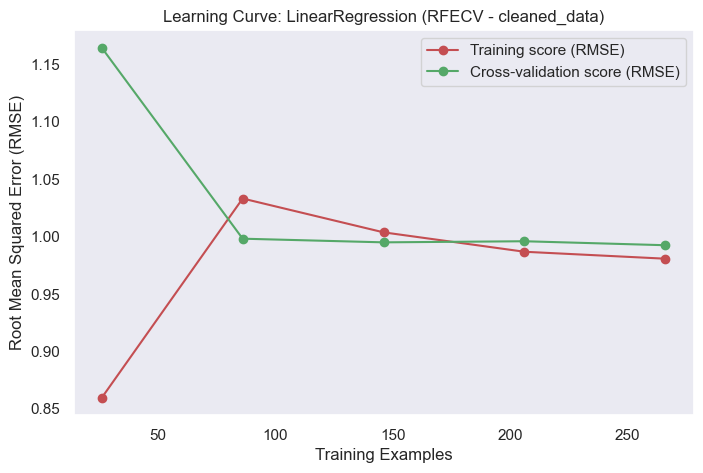

  4. Creating Averaged Ensemble...


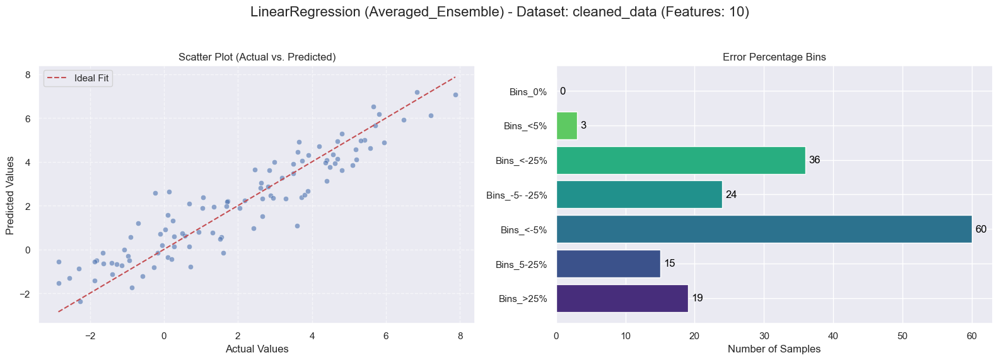

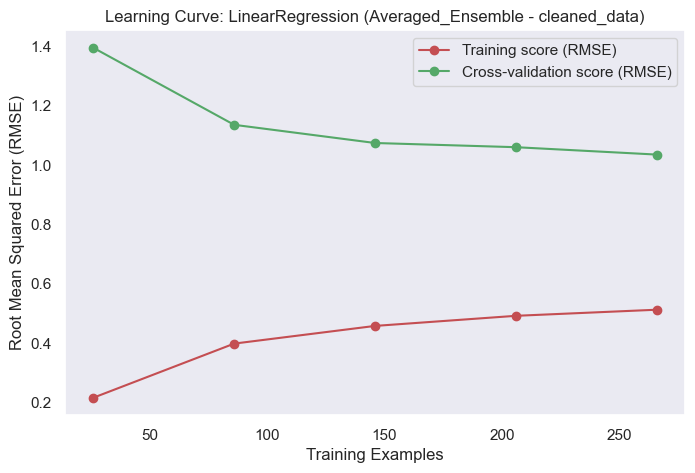


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


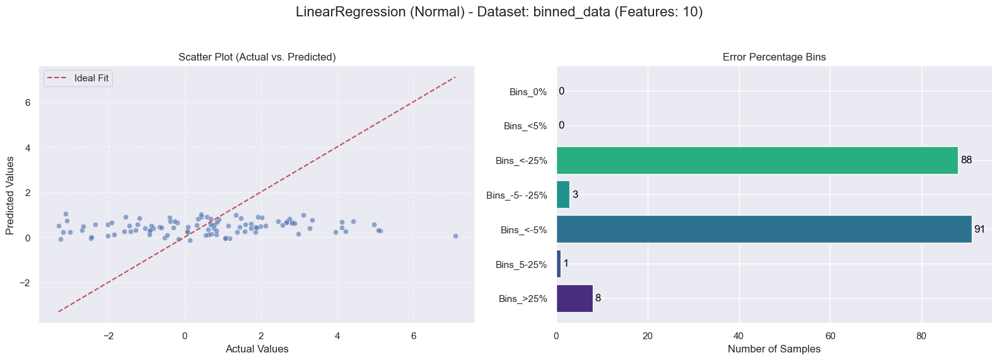

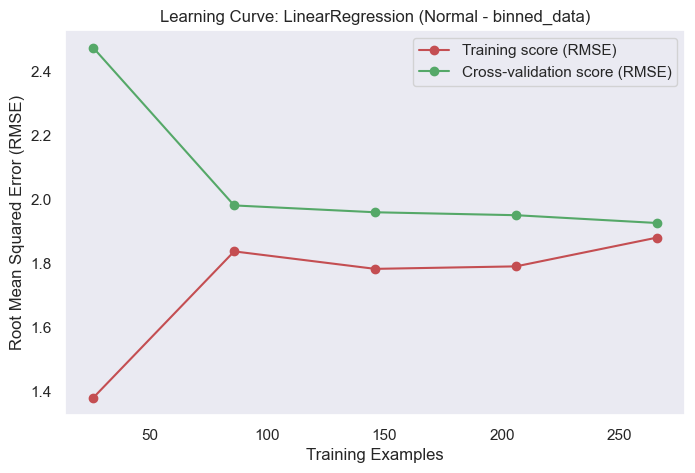

  2. Skipping Tuning. Copying Normal results.


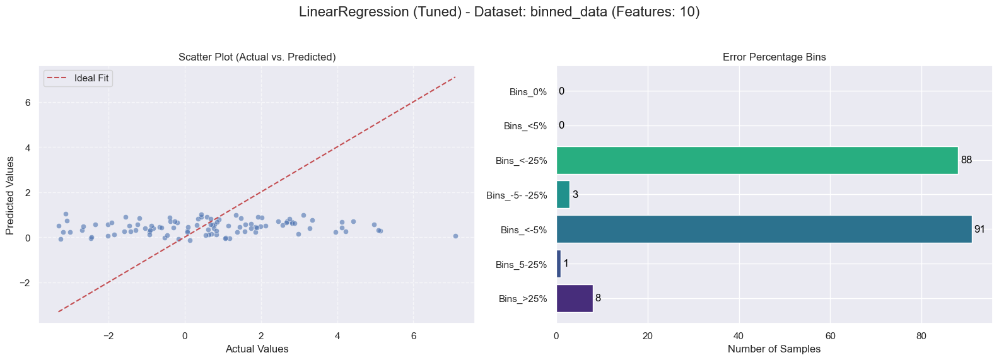

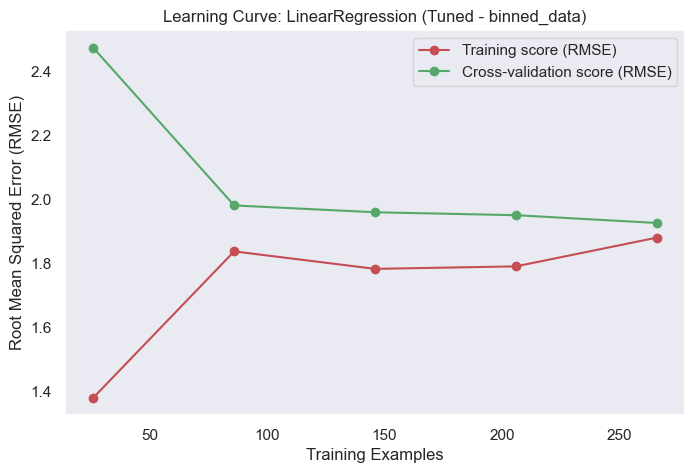

  3. Running RFECV Feature Selection...


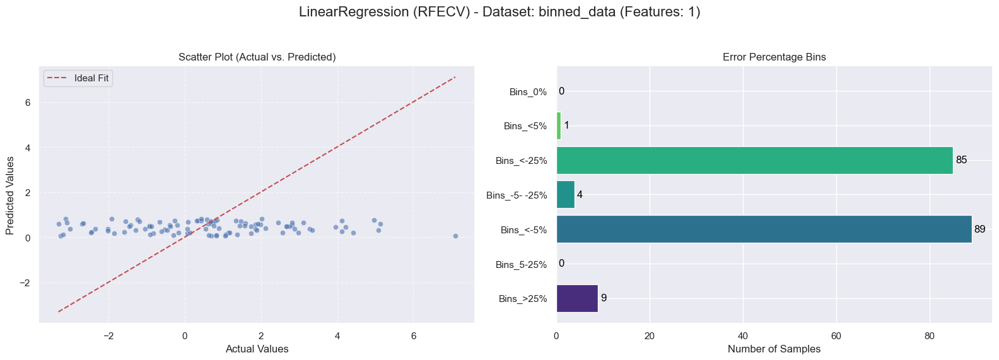

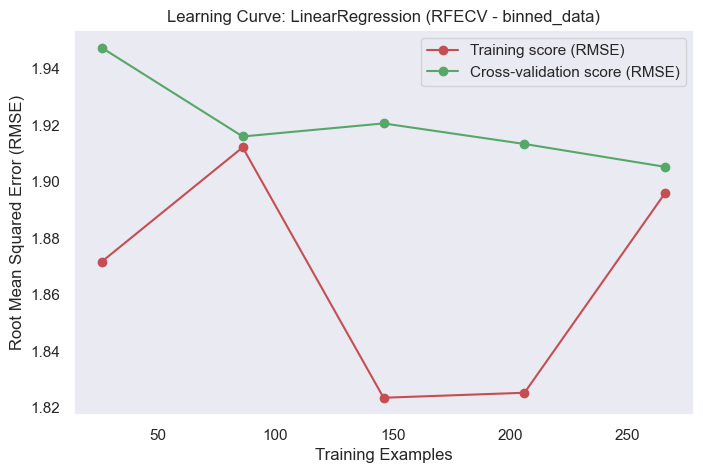

  4. Creating Averaged Ensemble...


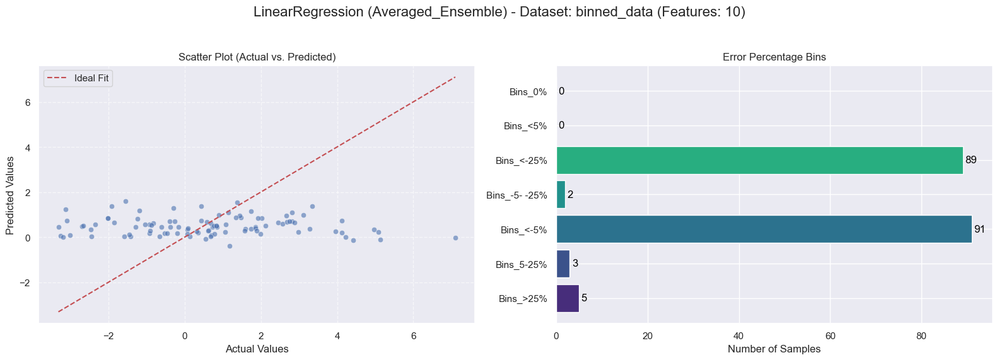

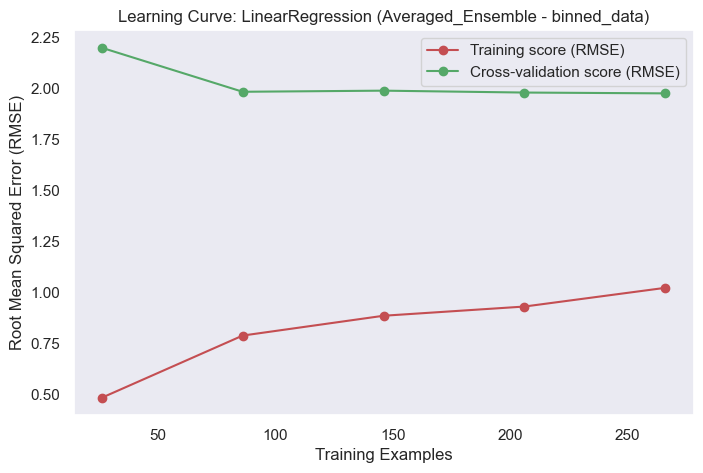

--- Finished Modeling for: LinearRegression ---


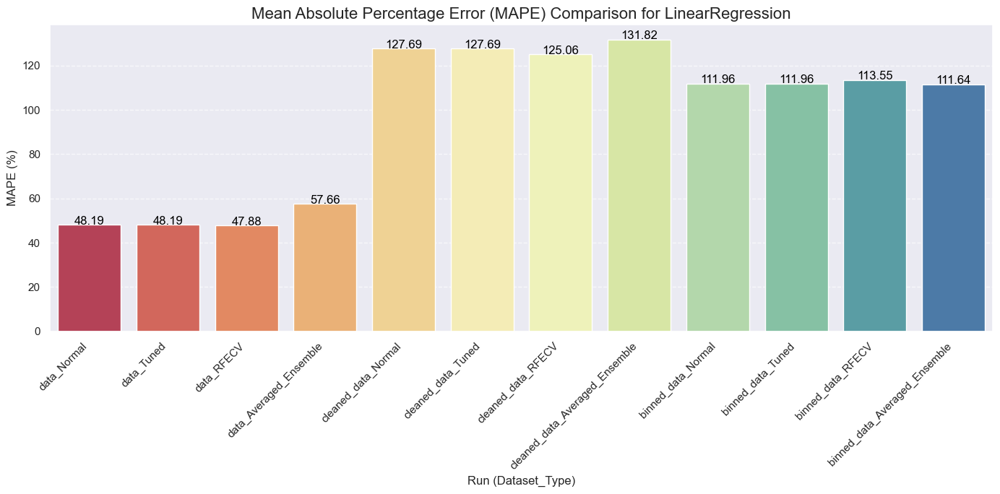





           CONSOLIDATED RESULTS FOR LinearRegression

--- Best Parameters for Tuned LinearRegression Models ---
        Dataset Best_Params
0          data        None
1  cleaned_data        None
2   binned_data        None
               Model               Type       Dataset        MAPE       SMAPE  \
11  LinearRegression  Averaged_Ensemble   binned_data  111.636132   142.83699   
8   LinearRegression             Normal   binned_data  111.963051  145.981009   
10  LinearRegression              RFECV   binned_data  113.548776   147.53409   
9   LinearRegression              Tuned   binned_data  111.963051  145.981009   
7   LinearRegression  Averaged_Ensemble  cleaned_data  131.817443   60.921329   
4   LinearRegression             Normal  cleaned_data   127.69194   57.323257   
6   LinearRegression              RFECV  cleaned_data  125.055869   56.664755   
5   LinearRegression              Tuned  cleaned_data   127.69194   57.323257   
3   LinearRegression  Averaged_Ensemble    

In [60]:
MODEL_NAME = 'LinearRegression' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))

### 2. Ridge

--- Starting Modeling for: Ridge ---

--- Processing Dataset: data ---
  1. Training Normal Model...


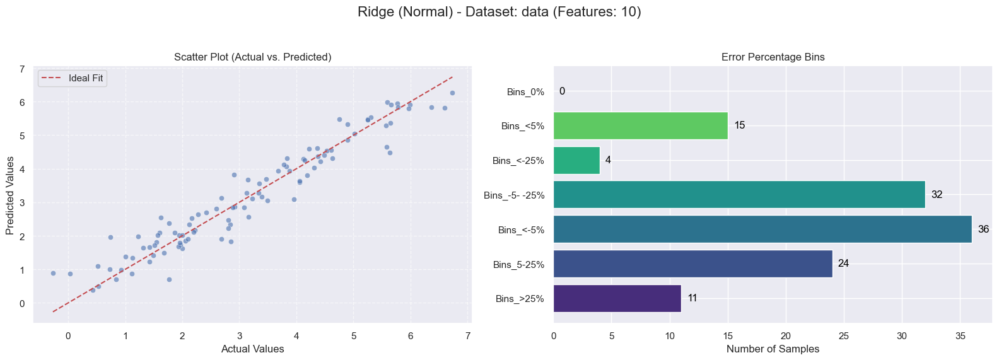

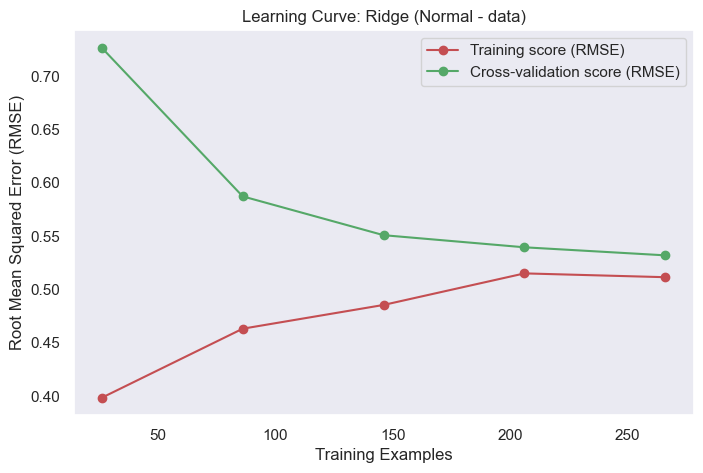

  2. Tuning Model with GridSearchCV...


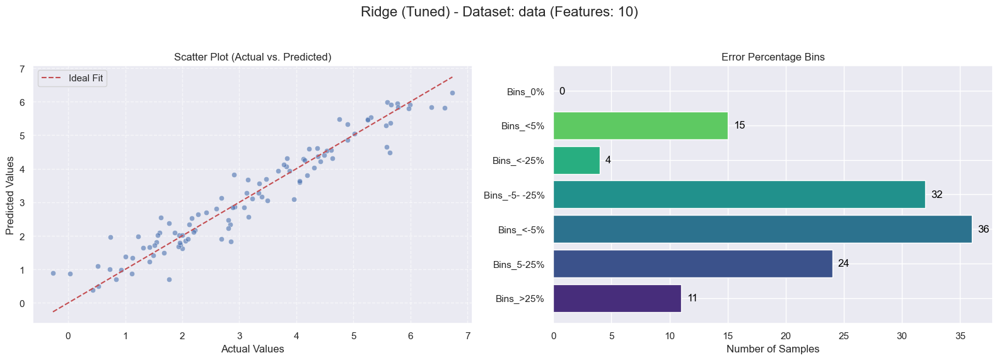

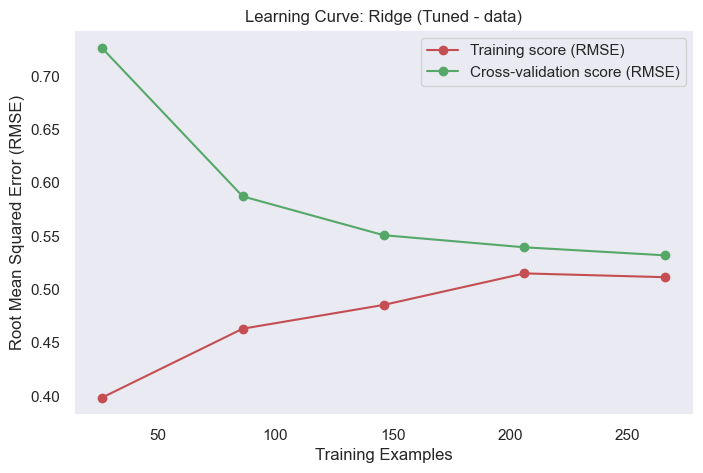

  3. Running RFECV Feature Selection...


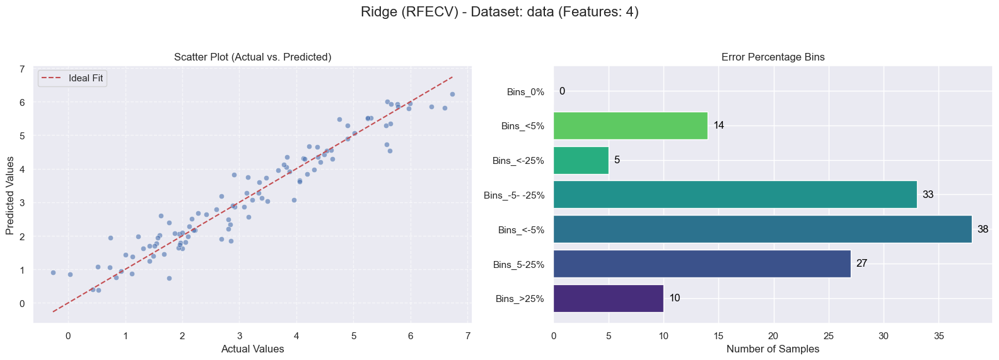

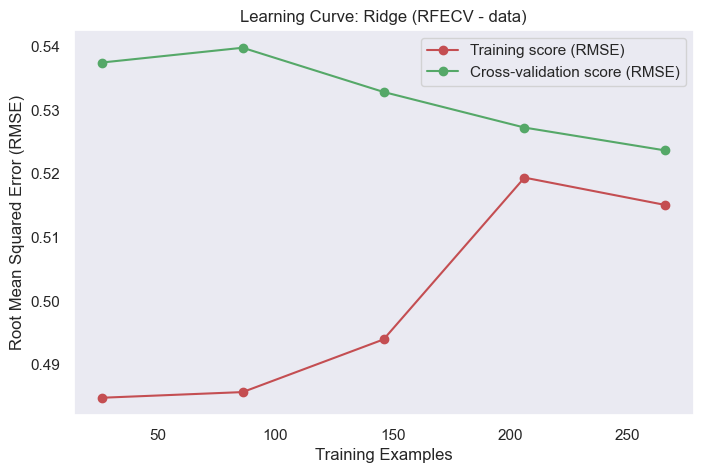

  4. Creating Averaged Ensemble...


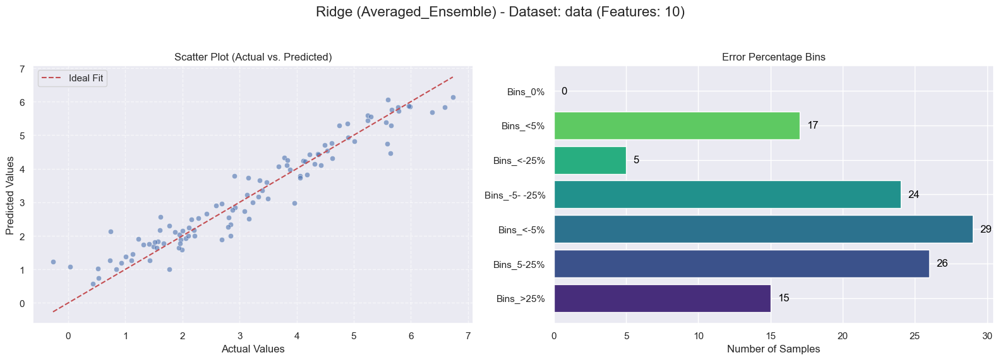

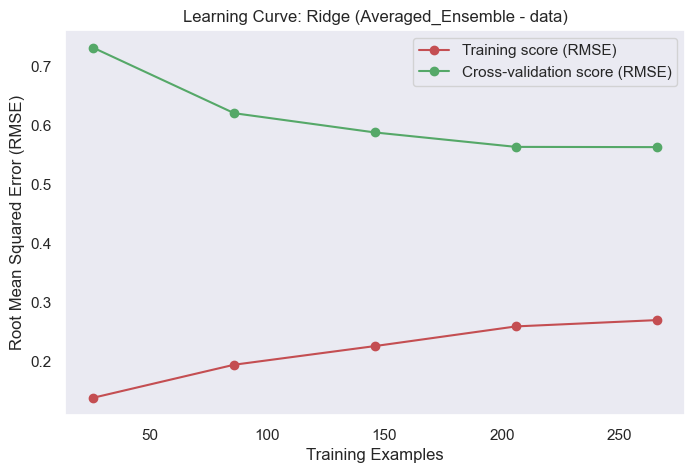


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


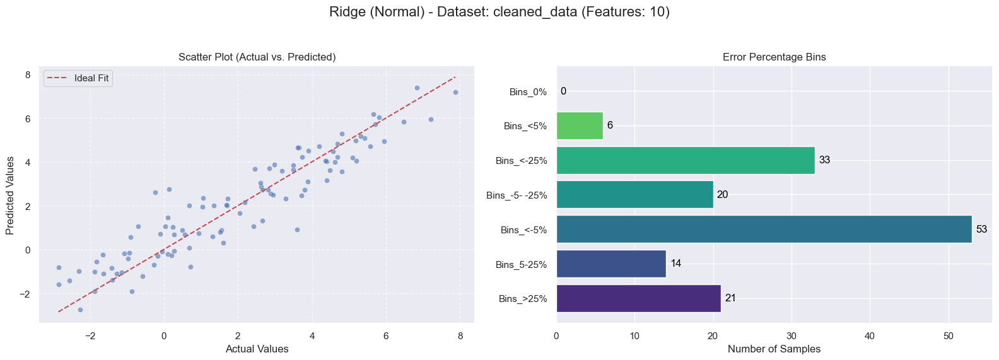

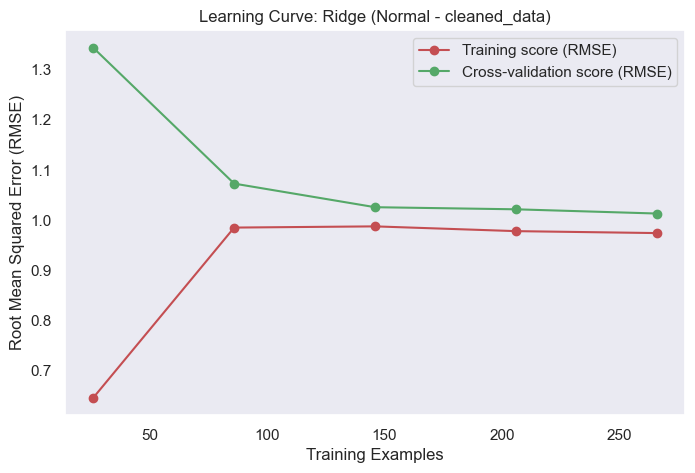

  2. Tuning Model with GridSearchCV...


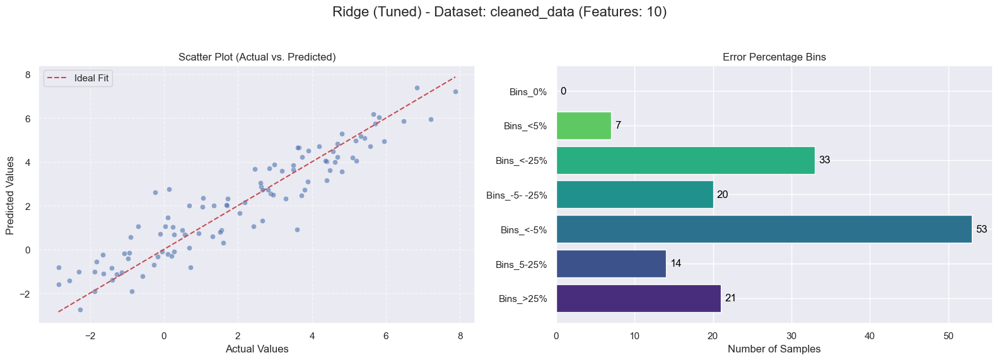

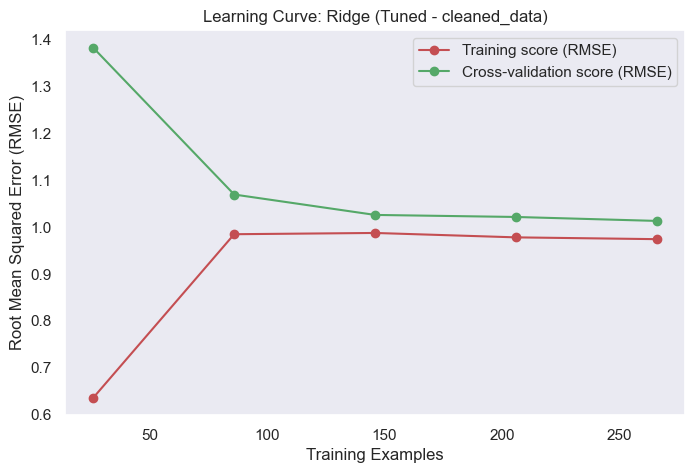

  3. Running RFECV Feature Selection...


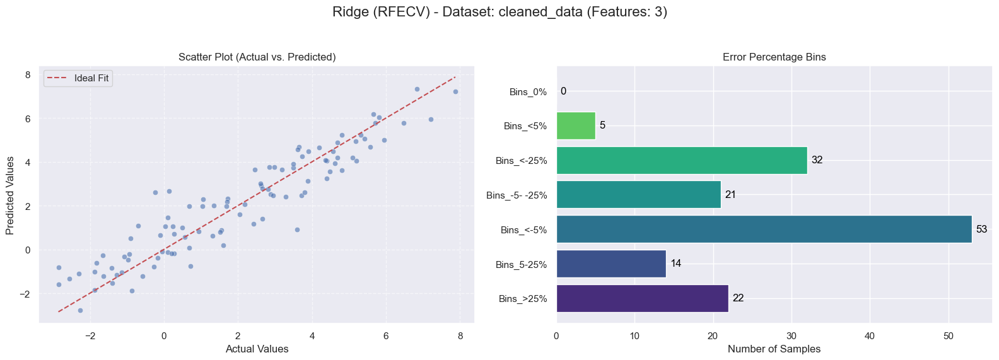

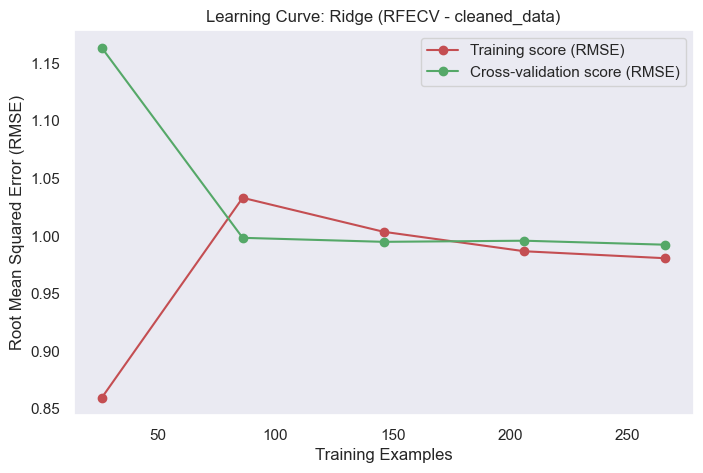

  4. Creating Averaged Ensemble...


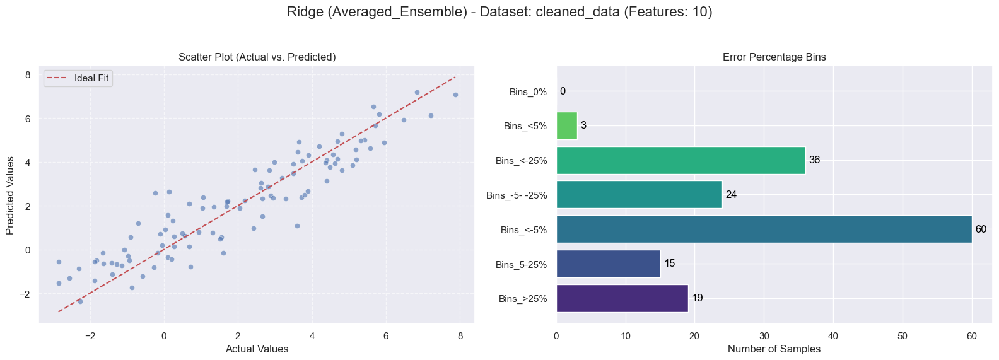

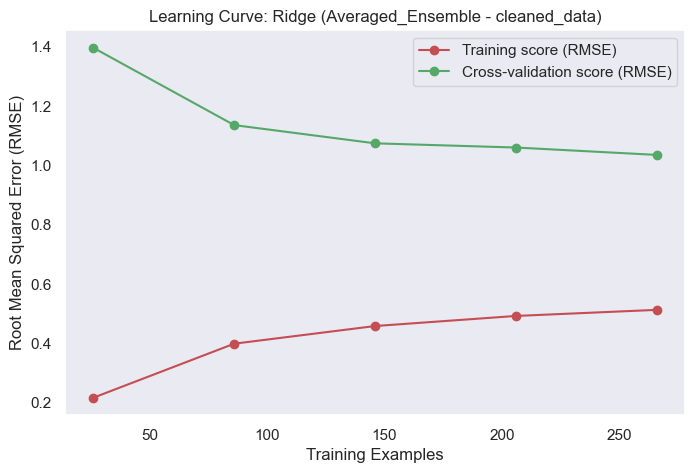


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


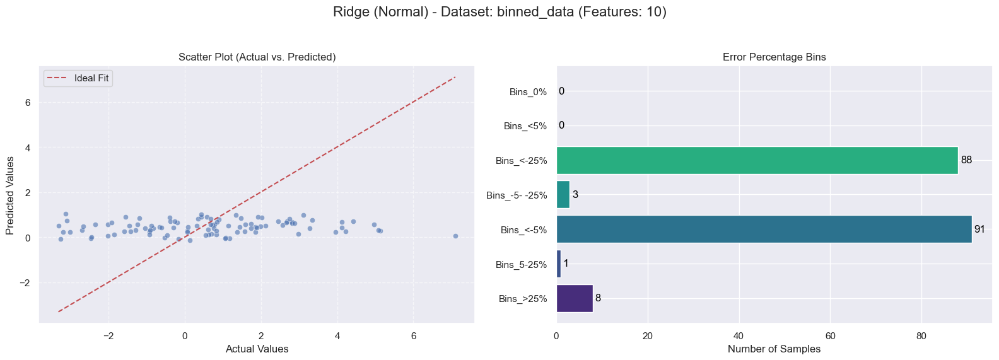

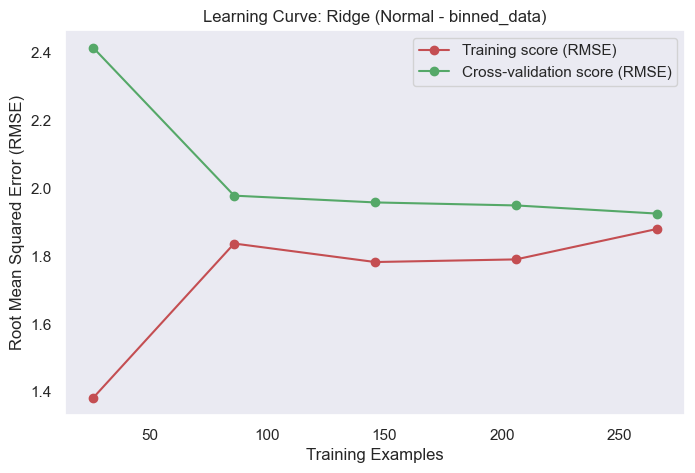

  2. Tuning Model with GridSearchCV...


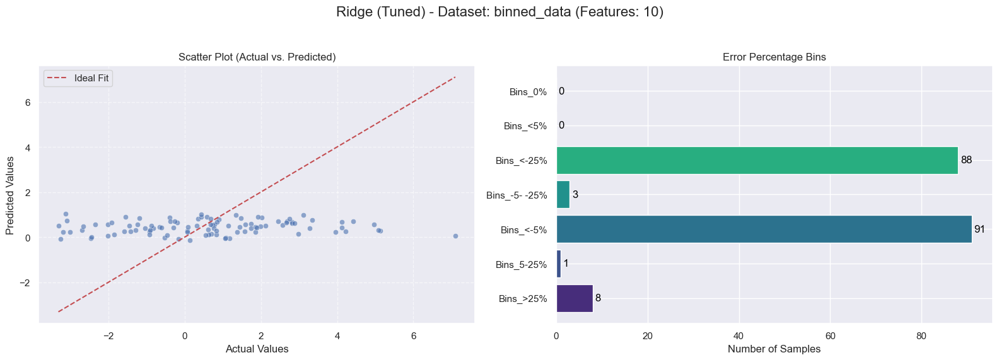

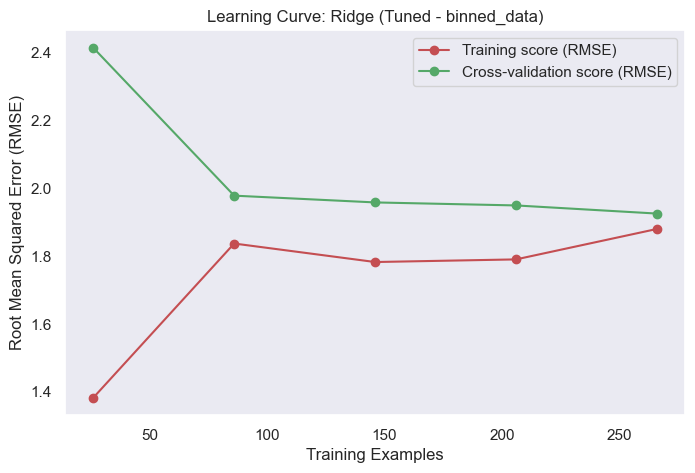

  3. Running RFECV Feature Selection...


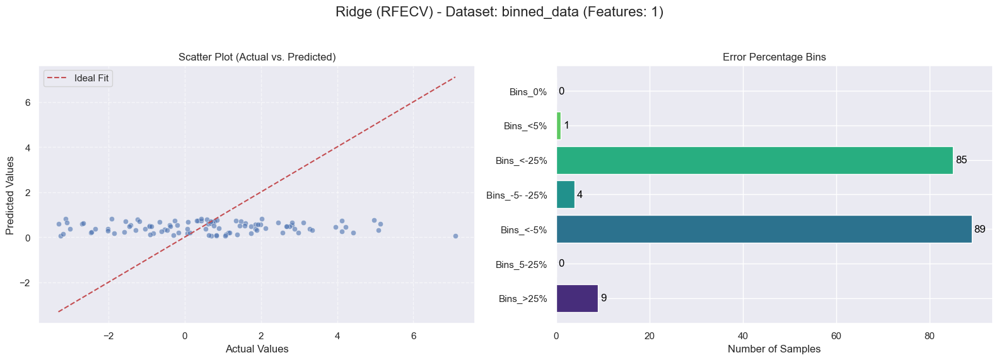

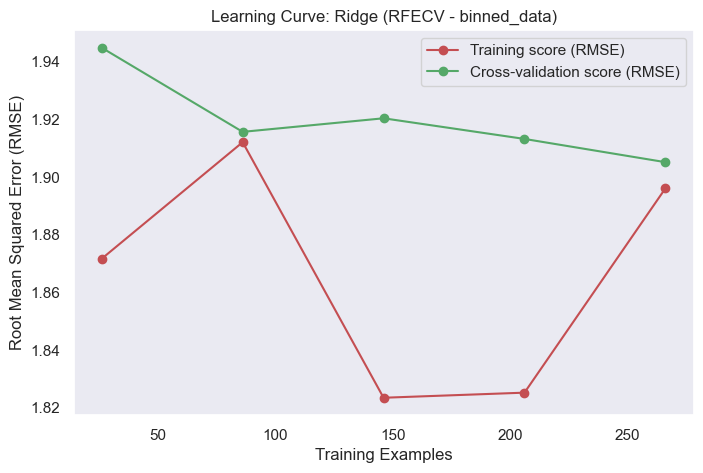

  4. Creating Averaged Ensemble...


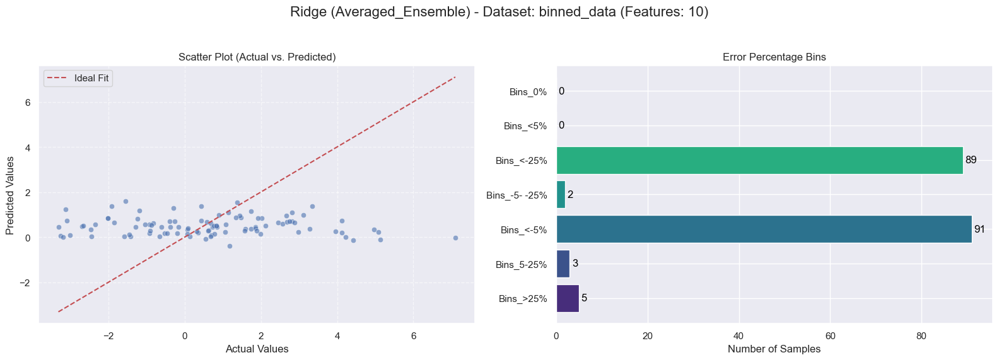

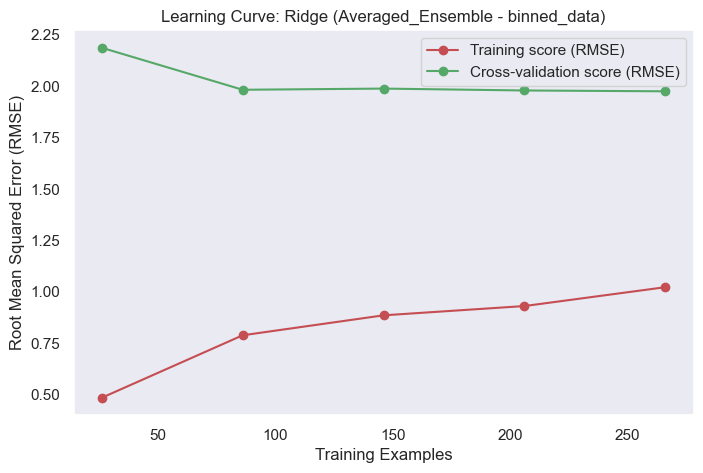

--- Finished Modeling for: Ridge ---


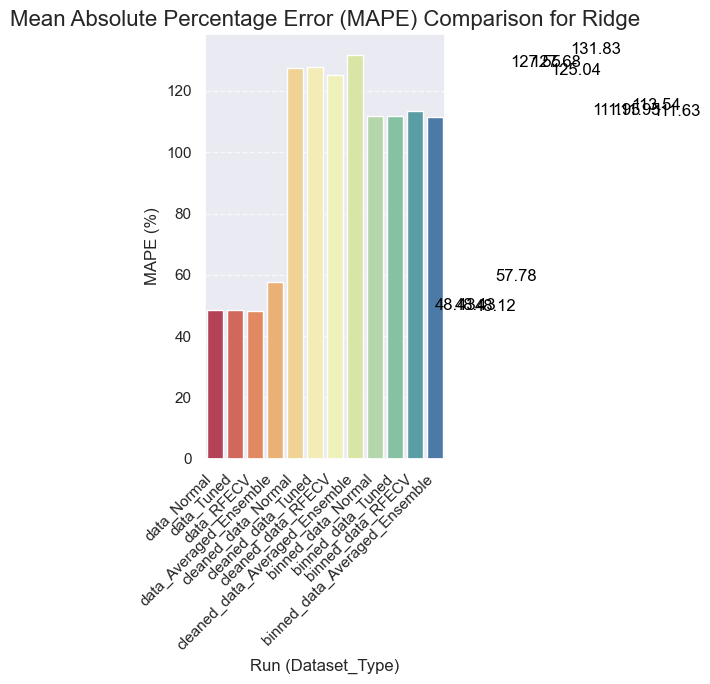





           CONSOLIDATED RESULTS FOR Ridge

--- Best Parameters for Tuned Ridge Models ---
        Dataset     Best_Params
0          data  {'alpha': 1.0}
1  cleaned_data  {'alpha': 0.1}
2   binned_data  {'alpha': 1.0}
    Model               Type       Dataset        MAPE       SMAPE      RMSE  \
23  Ridge  Averaged_Ensemble   binned_data  111.633587  142.831394  2.213004   
20  Ridge             Normal   binned_data  111.945473  145.997035  2.141937   
22  Ridge              RFECV   binned_data  113.543196  147.517335  2.172461   
21  Ridge              Tuned   binned_data  111.945473  145.997035  2.141937   
19  Ridge  Averaged_Ensemble  cleaned_data  131.827689   60.925584  0.985703   
16  Ridge             Normal  cleaned_data  127.549988    57.31739  0.937849   
18  Ridge              RFECV  cleaned_data  125.043957    56.66316  0.926529   
17  Ridge              Tuned  cleaned_data  127.676641   57.321826  0.937113   
15  Ridge  Averaged_Ensemble          data   57.778111   1

In [61]:
MODEL_NAME = 'Ridge' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))

### 3. DecisionTree

--- Starting Modeling for: DecisionTree ---

--- Processing Dataset: data ---
  1. Training Normal Model...


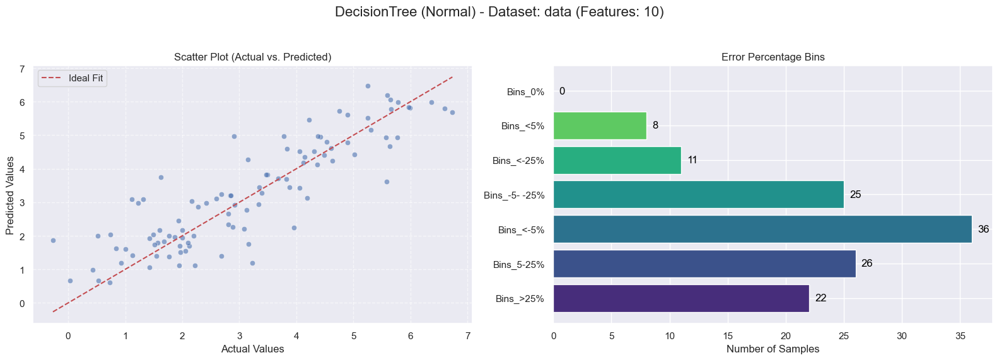

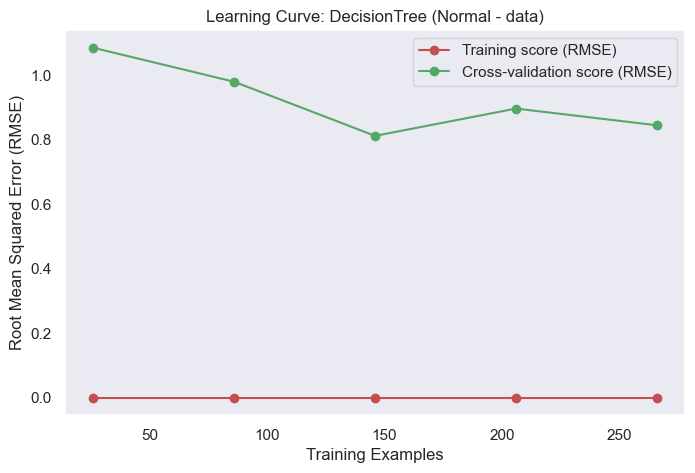

  2. Tuning Model with GridSearchCV...


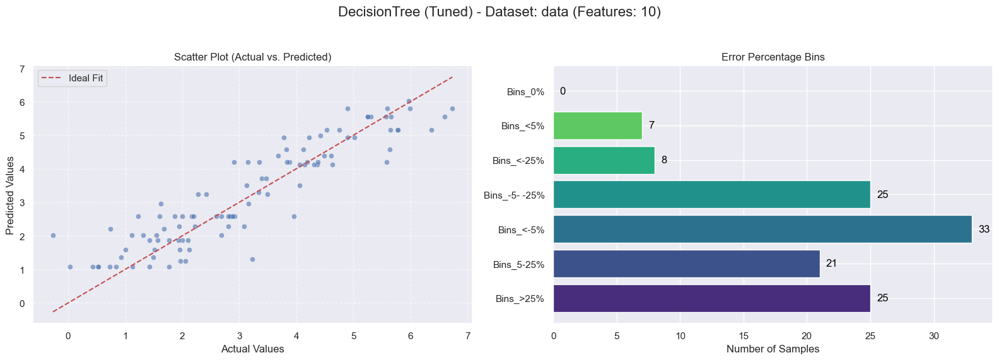

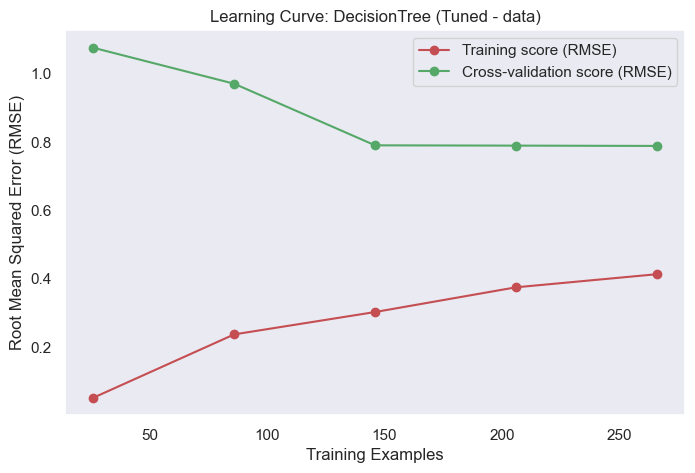

  3. Running RFECV Feature Selection...


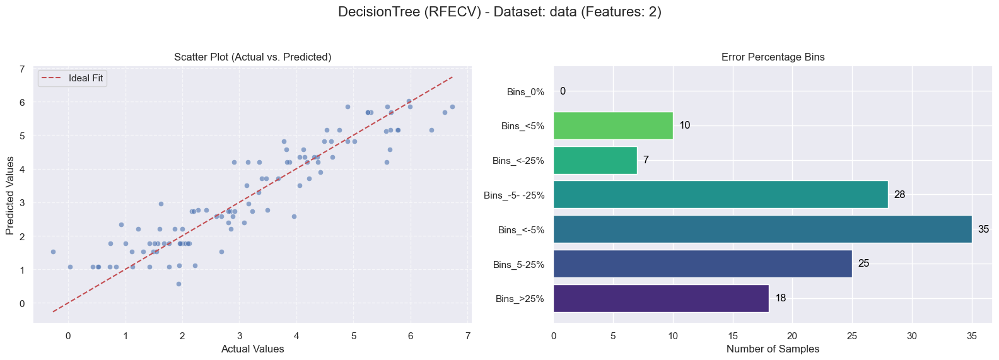

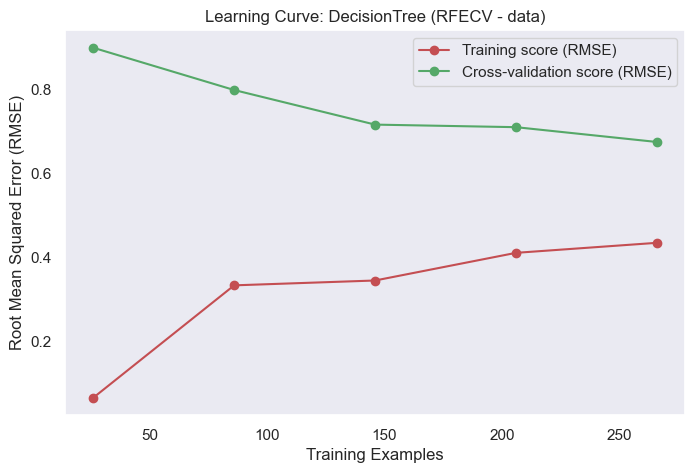

  4. Creating Averaged Ensemble...


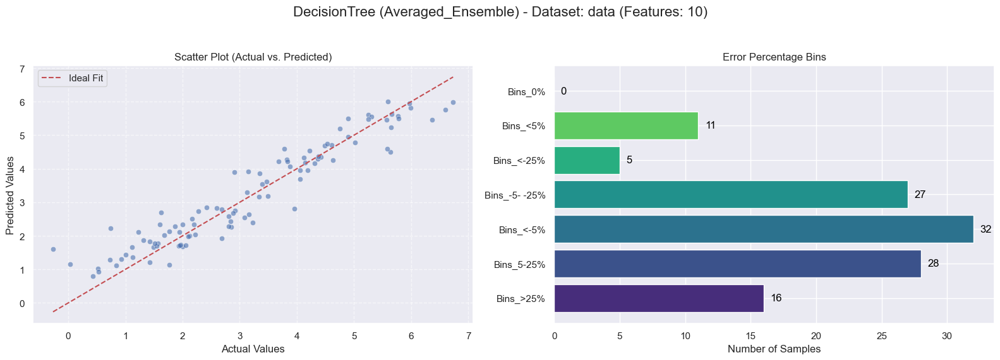

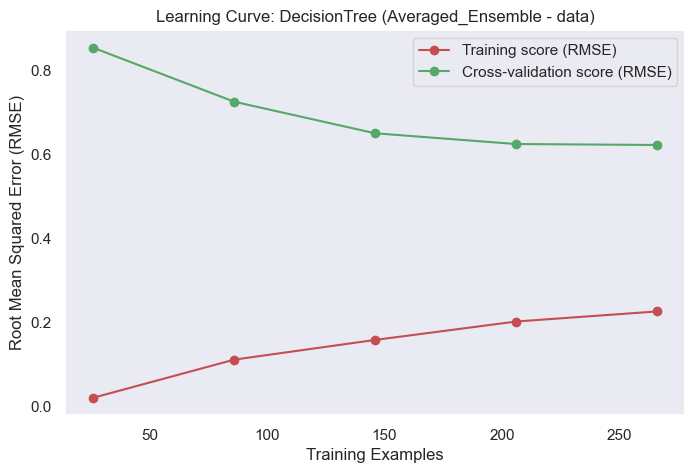


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


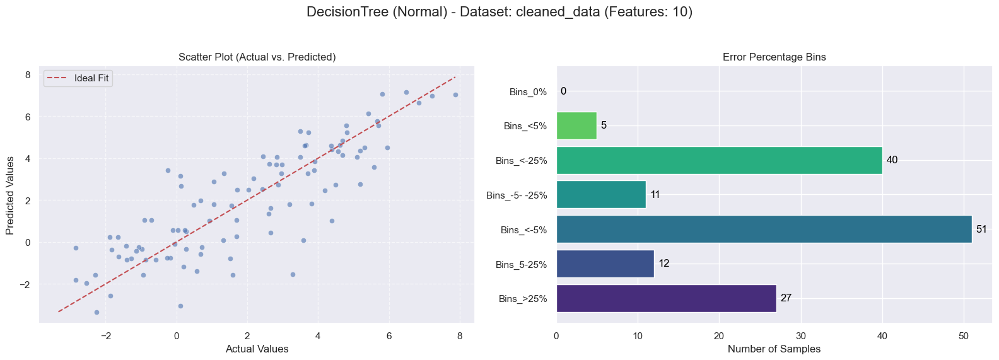

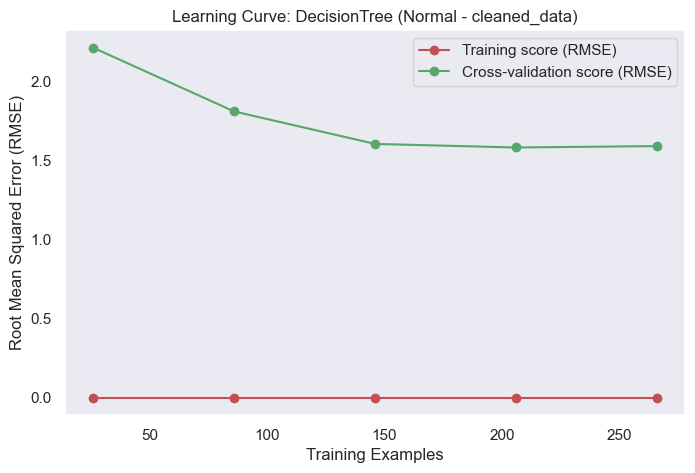

  2. Tuning Model with GridSearchCV...


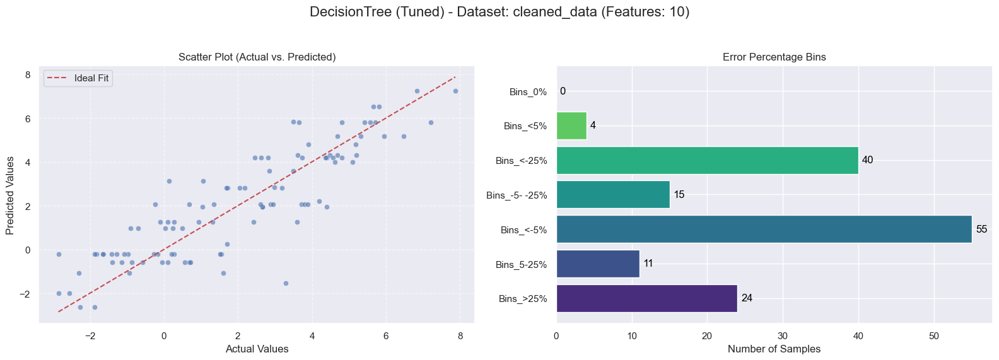

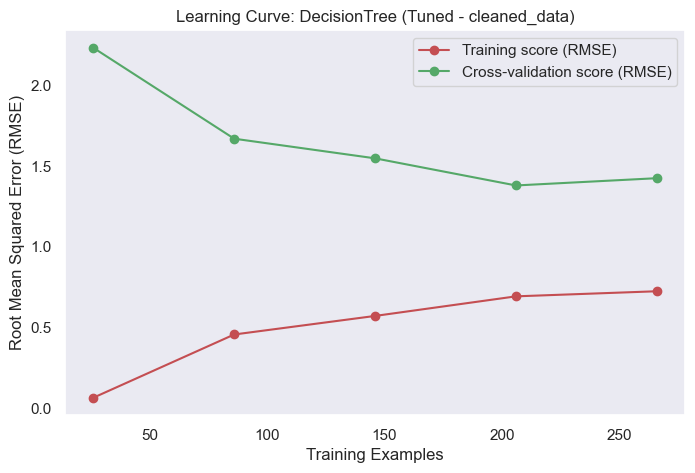

  3. Running RFECV Feature Selection...


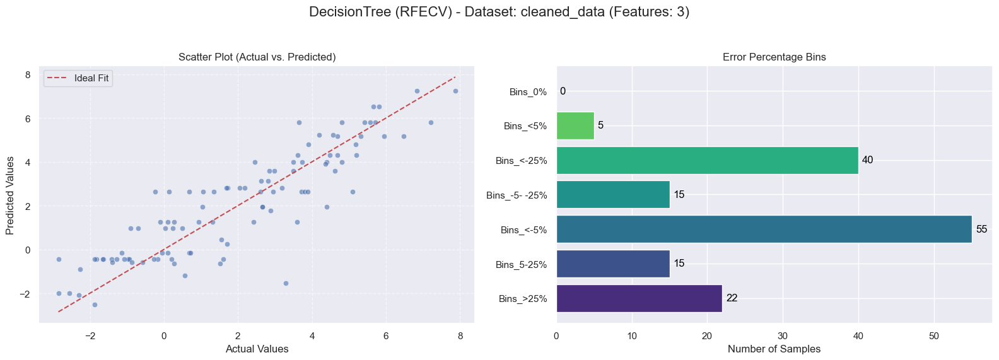

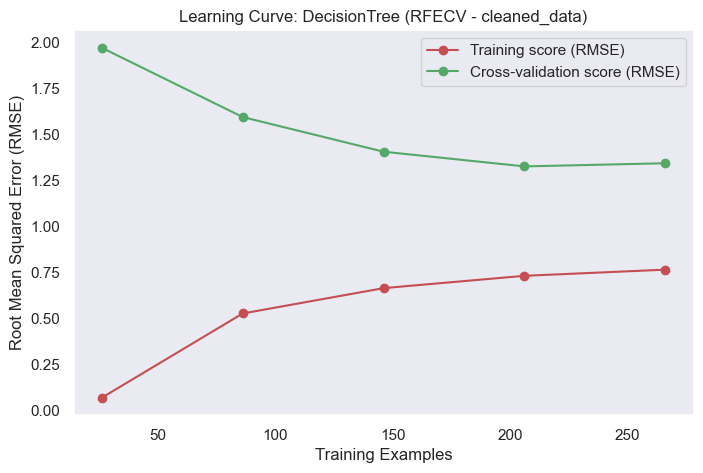

  4. Creating Averaged Ensemble...


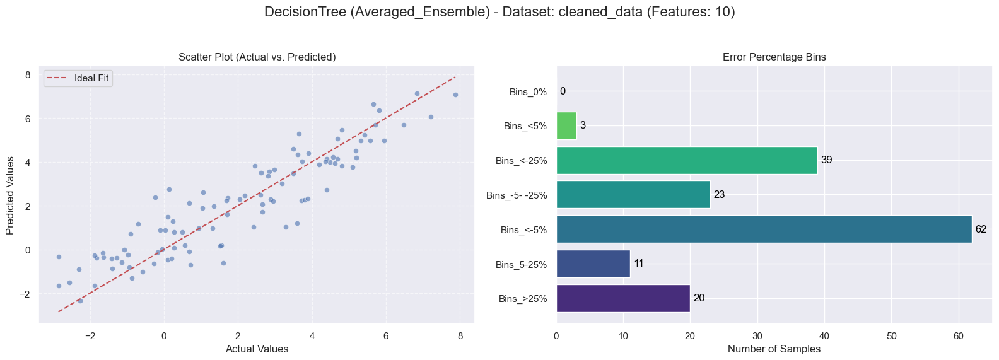

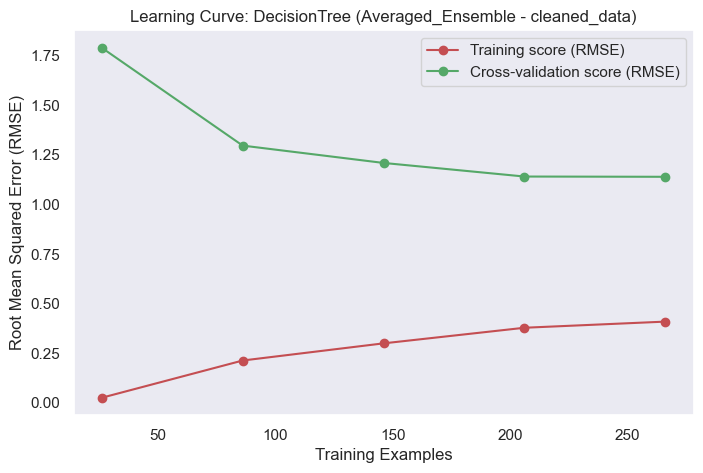


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


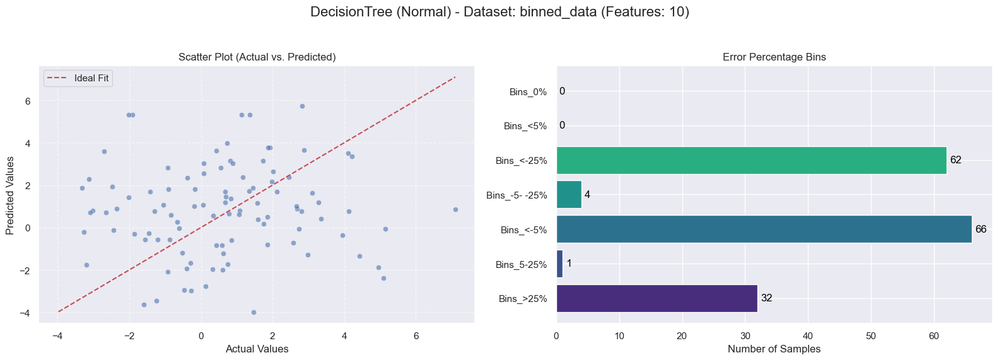

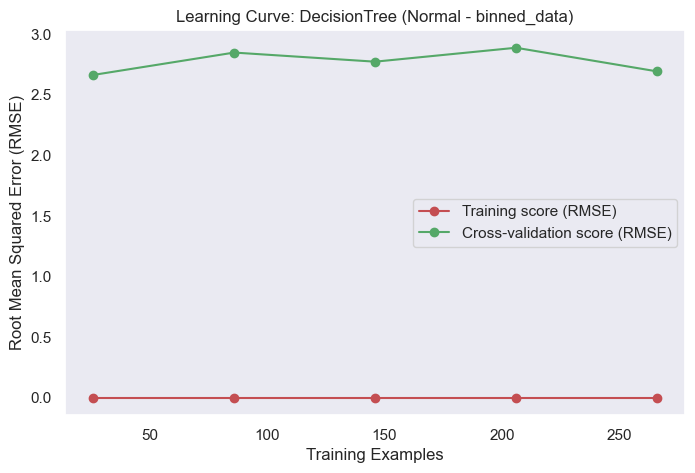

  2. Tuning Model with GridSearchCV...


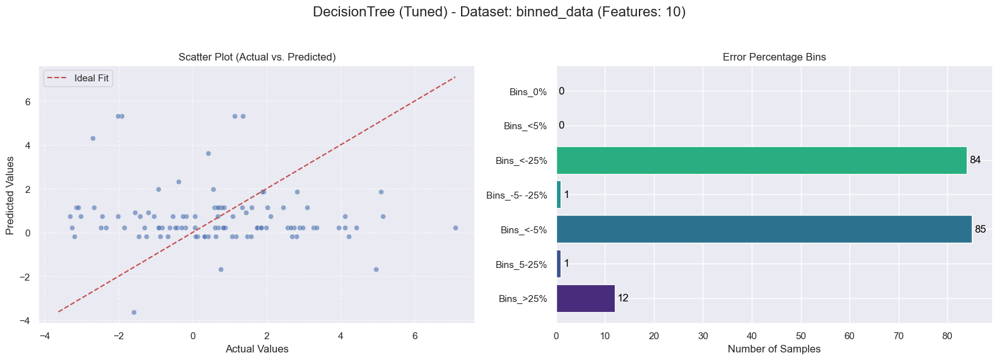

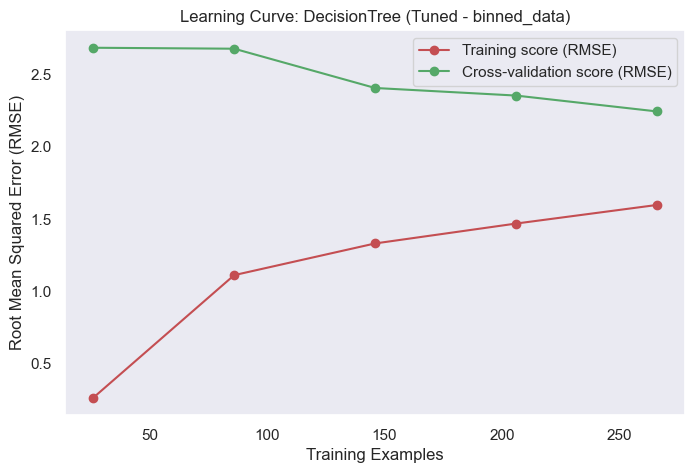

  3. Running RFECV Feature Selection...


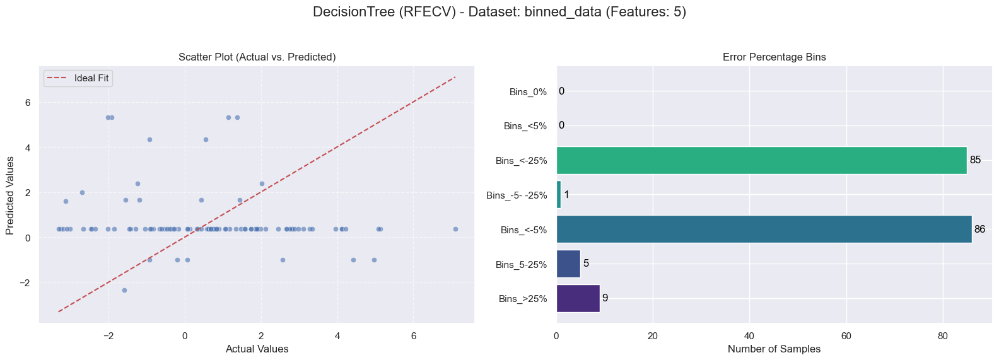

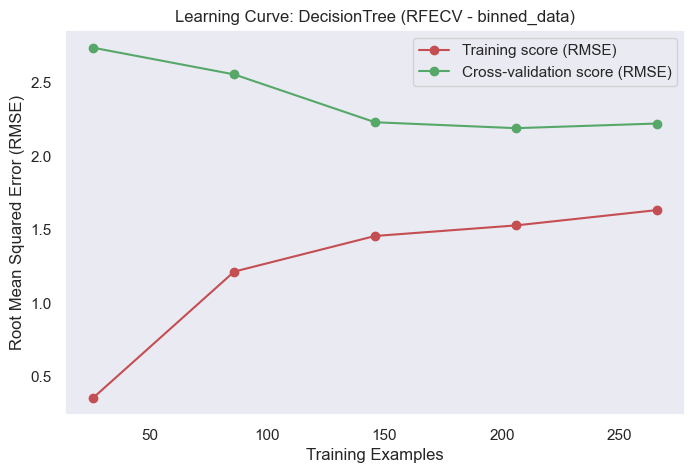

  4. Creating Averaged Ensemble...


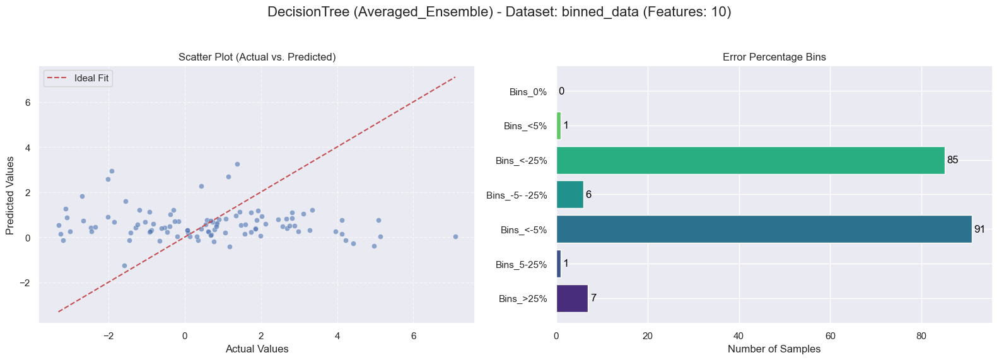

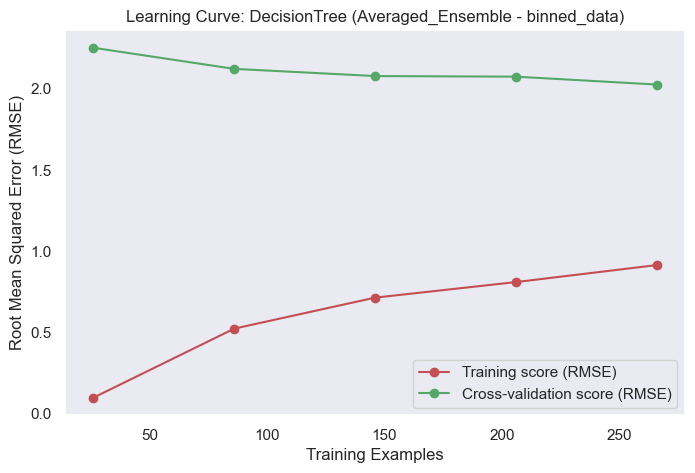

--- Finished Modeling for: DecisionTree ---


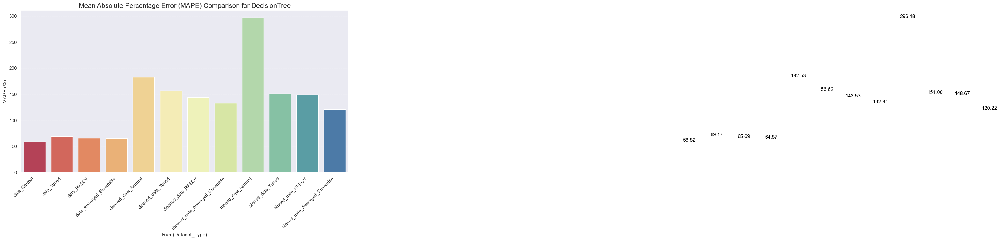





           CONSOLIDATED RESULTS FOR DecisionTree

--- Best Parameters for Tuned DecisionTree Models ---
        Dataset       Best_Params
0          data  {'max_depth': 5}
1  cleaned_data  {'max_depth': 5}
2   binned_data  {'max_depth': 5}
           Model               Type       Dataset        MAPE       SMAPE  \
35  DecisionTree  Averaged_Ensemble   binned_data  120.218358  142.769848   
32  DecisionTree             Normal   binned_data  296.184398  135.059691   
34  DecisionTree              RFECV   binned_data  148.672542  145.489997   
33  DecisionTree              Tuned   binned_data  151.003729  153.387385   
31  DecisionTree  Averaged_Ensemble  cleaned_data  132.808935   66.920534   
28  DecisionTree             Normal  cleaned_data  182.527018   75.528559   
30  DecisionTree              RFECV  cleaned_data  143.527055   70.292617   
29  DecisionTree              Tuned  cleaned_data    156.6166    74.36496   
27  DecisionTree  Averaged_Ensemble          data   64.868123  

In [62]:
MODEL_NAME = 'DecisionTree' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))

### 4. Lasso

--- Starting Modeling for: Lasso ---

--- Processing Dataset: data ---
  1. Training Normal Model...


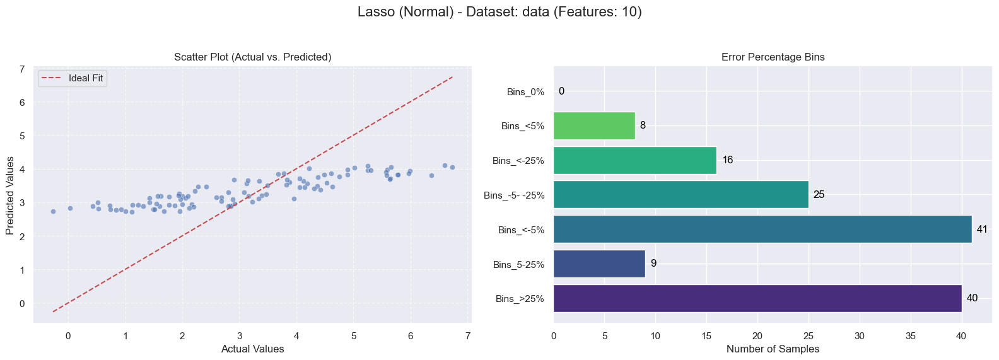

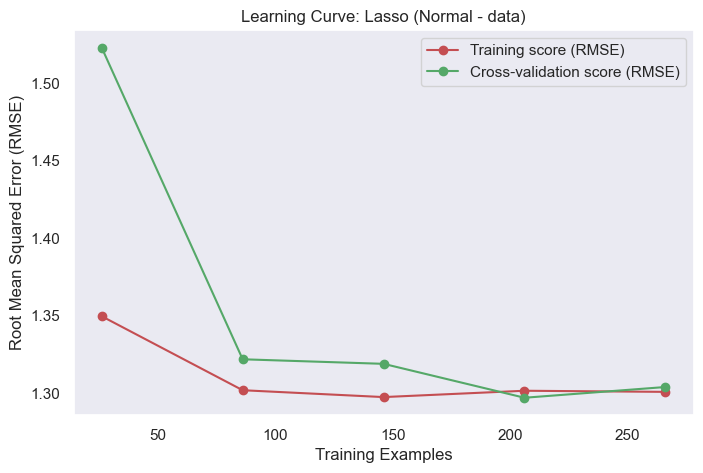

  2. Tuning Model with GridSearchCV...


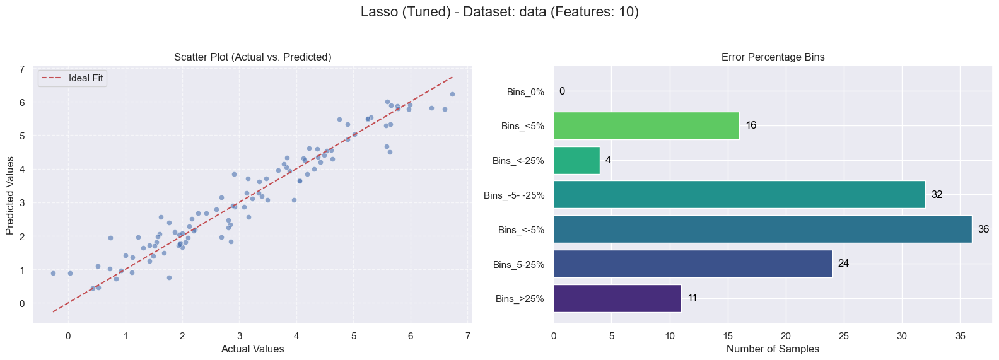

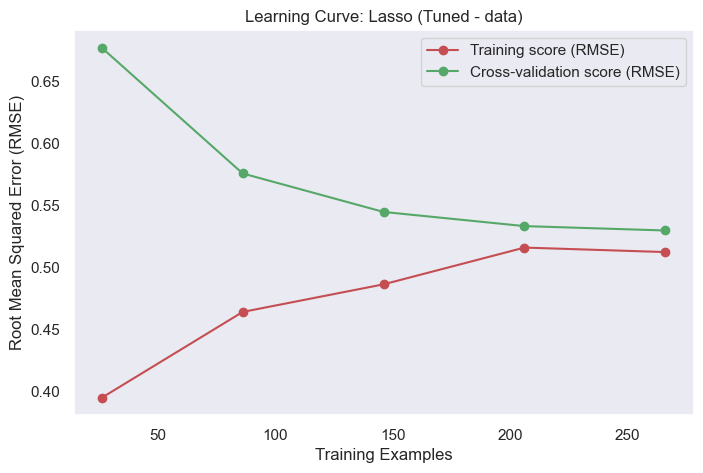

  3. Running RFECV Feature Selection...


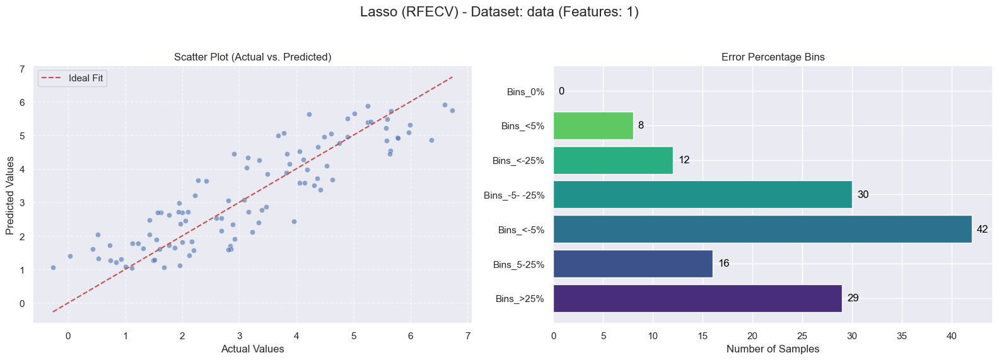

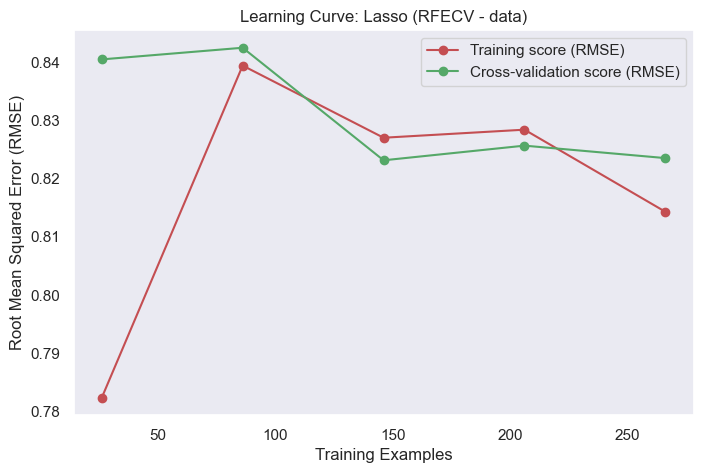

  4. Creating Averaged Ensemble...


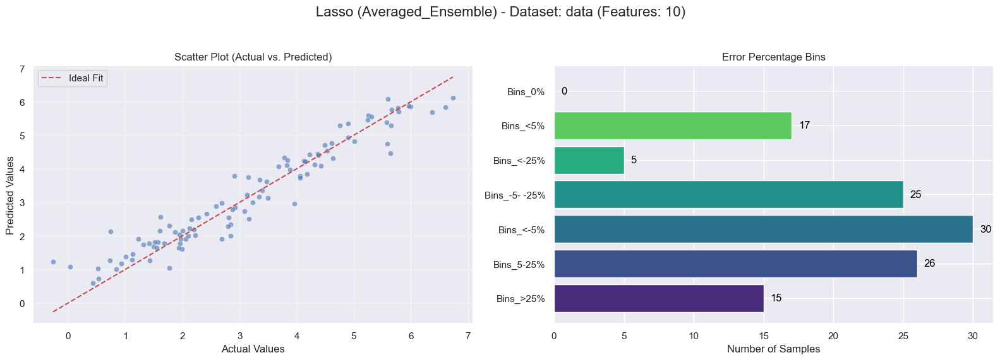

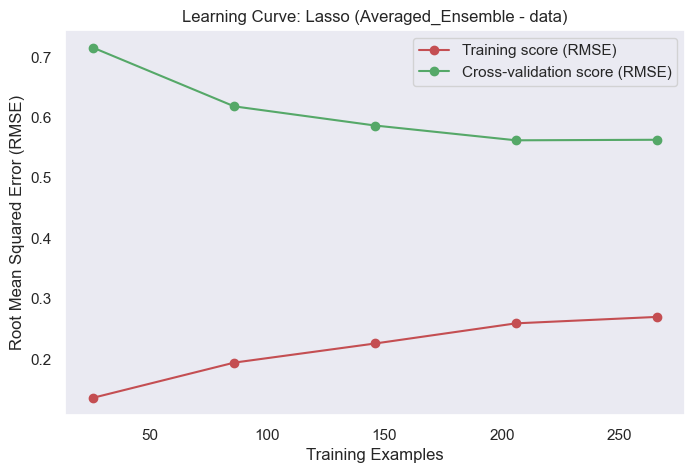


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


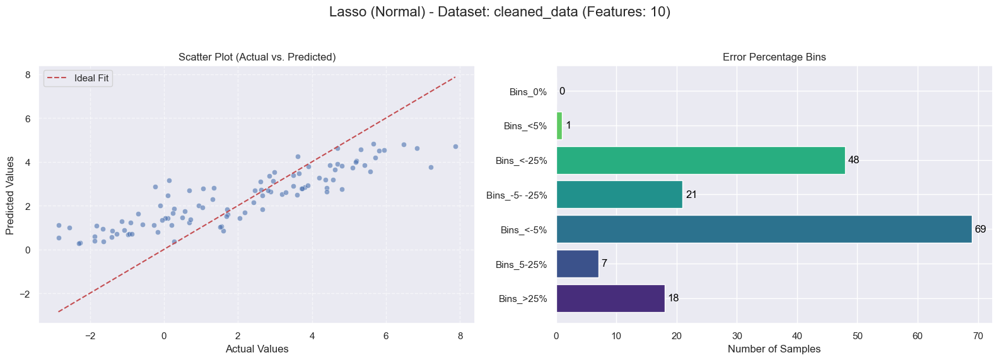

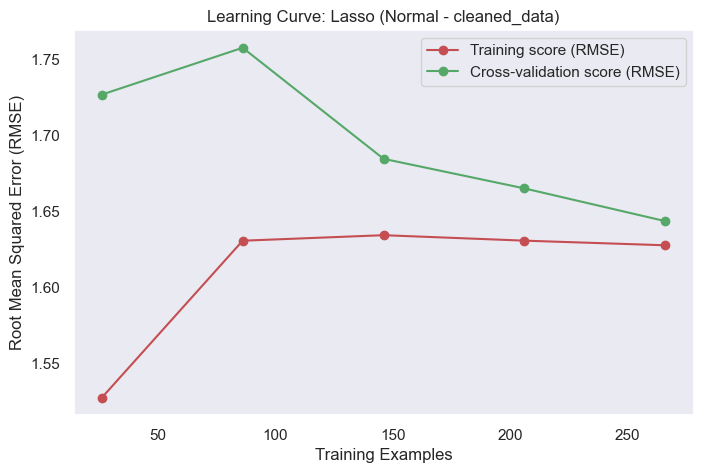

  2. Tuning Model with GridSearchCV...


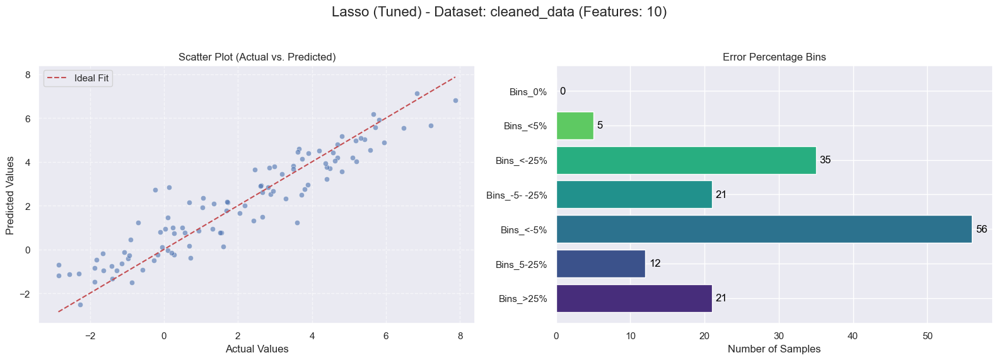

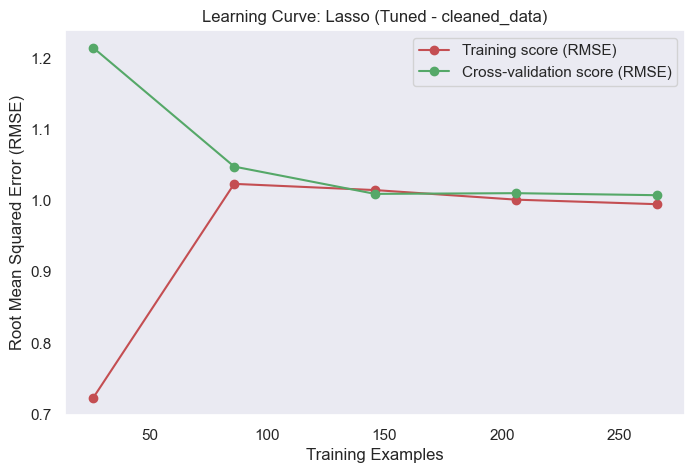

  3. Running RFECV Feature Selection...


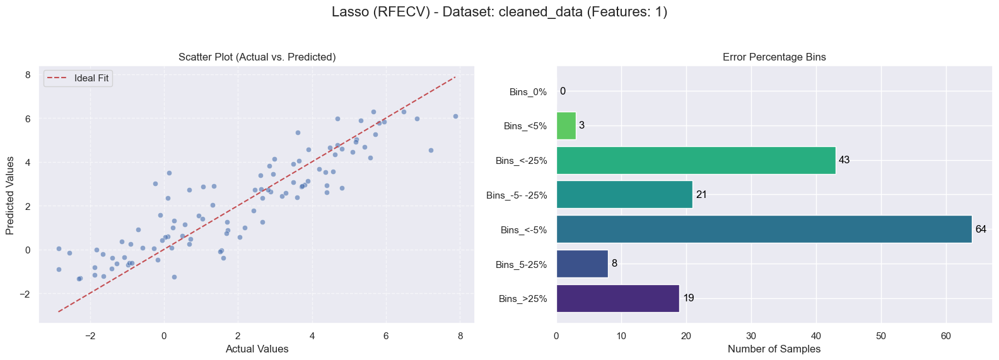

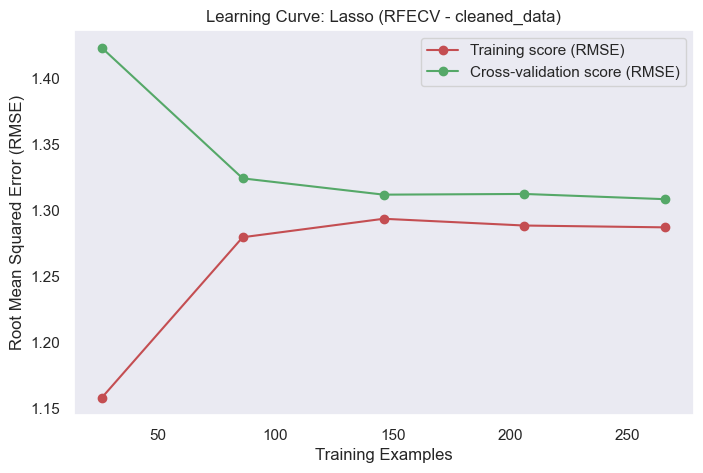

  4. Creating Averaged Ensemble...


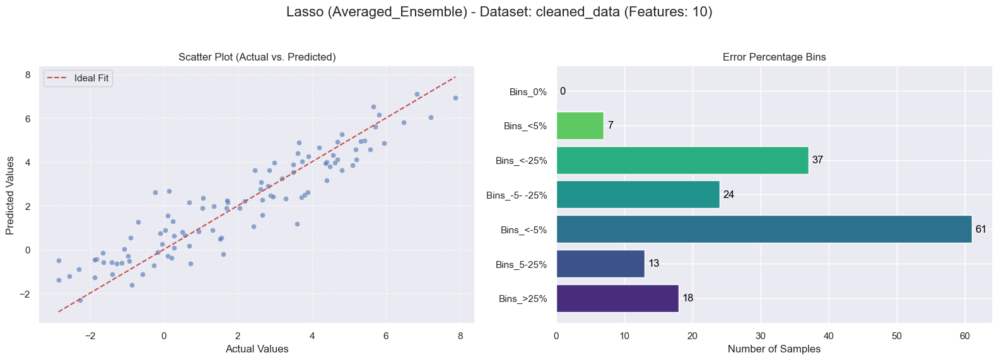

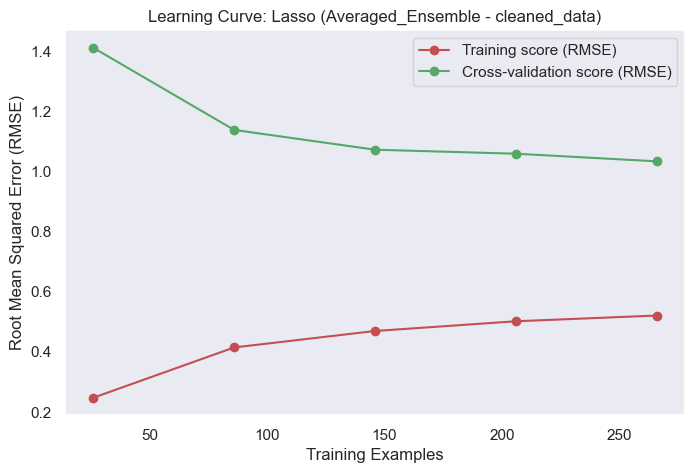


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


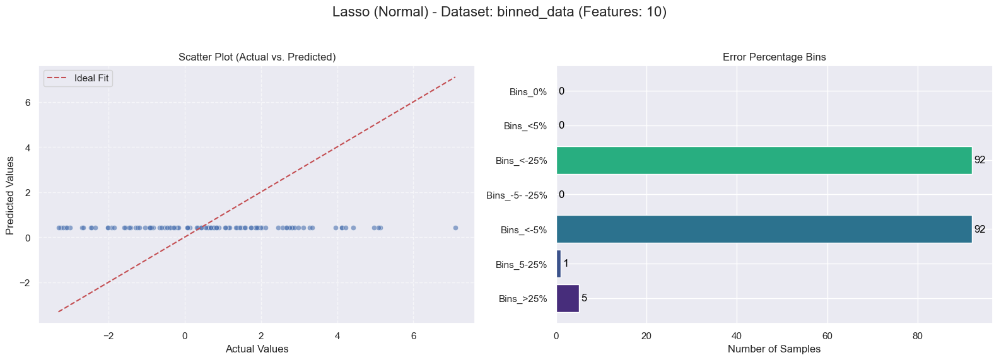

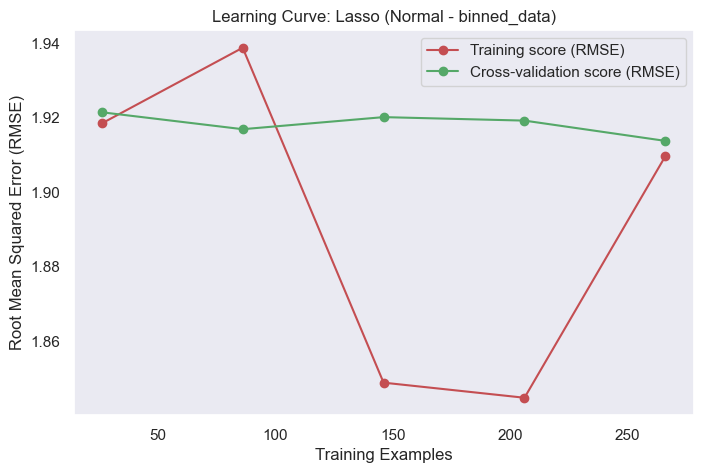

  2. Tuning Model with GridSearchCV...


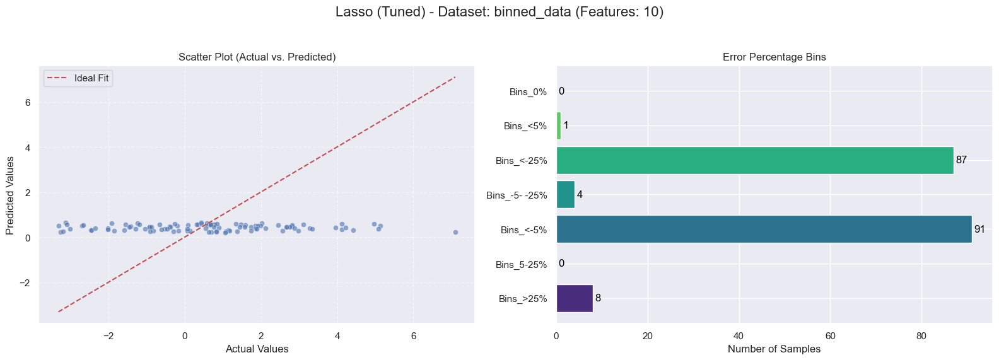

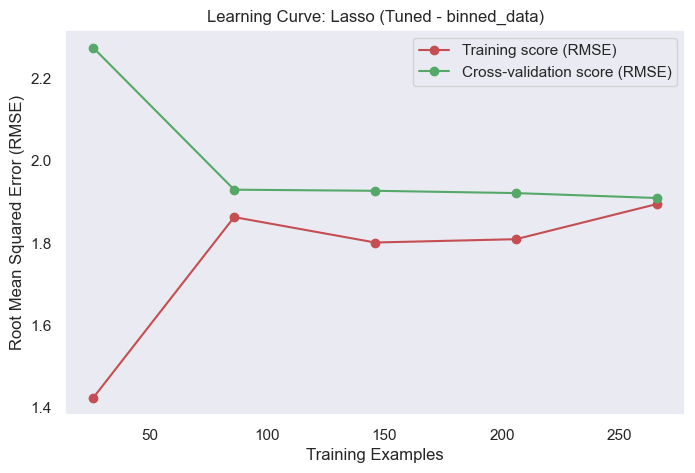

  3. Running RFECV Feature Selection...


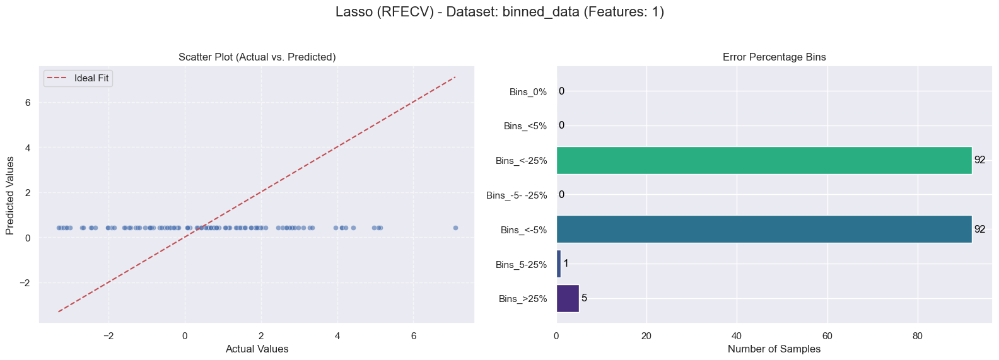

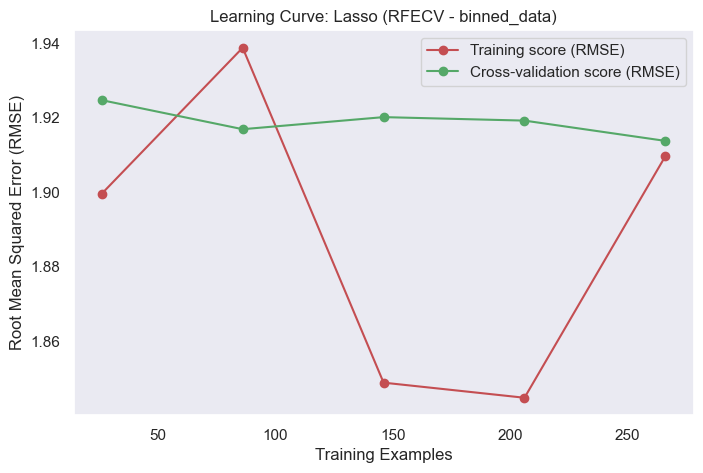

  4. Creating Averaged Ensemble...


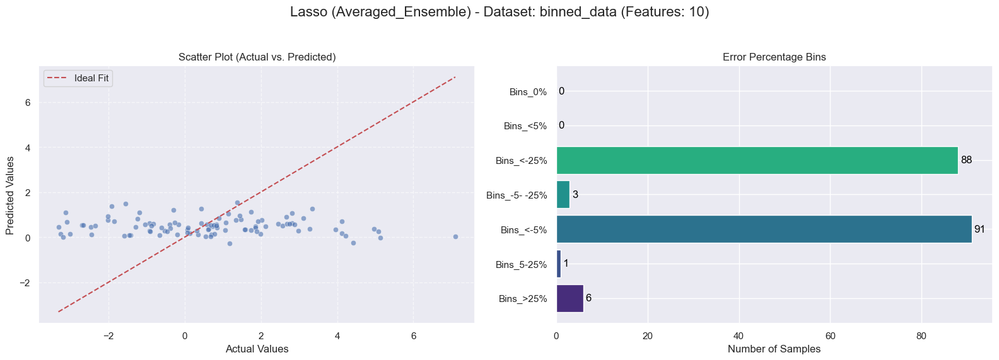

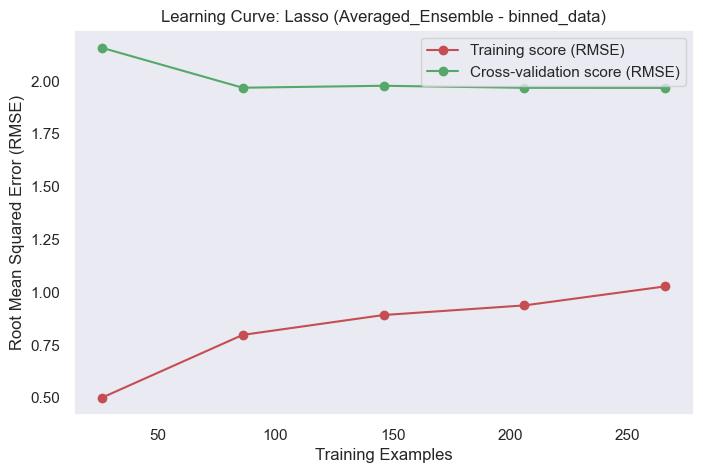

--- Finished Modeling for: Lasso ---


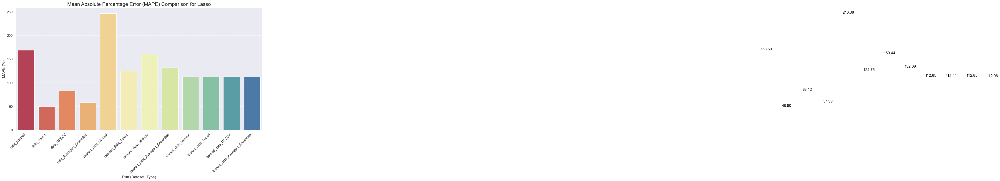





           CONSOLIDATED RESULTS FOR Lasso

--- Best Parameters for Tuned Lasso Models ---
        Dataset      Best_Params
0          data  {'alpha': 0.01}
1  cleaned_data   {'alpha': 0.1}
2   binned_data   {'alpha': 0.1}
    Model               Type       Dataset        MAPE       SMAPE      RMSE  \
47  Lasso  Averaged_Ensemble   binned_data  112.059847  142.500904   2.21808   
44  Lasso             Normal   binned_data  112.851571  144.185831  2.160701   
46  Lasso              RFECV   binned_data  112.851571  144.185831  2.160701   
45  Lasso              Tuned   binned_data  112.410369  145.009075  2.162497   
43  Lasso  Averaged_Ensemble  cleaned_data  132.091524   61.734342  0.989813   
40  Lasso             Normal  cleaned_data  246.383941   85.553442  1.610525   
42  Lasso              RFECV  cleaned_data  160.436427   70.029529  1.181763   
41  Lasso              Tuned  cleaned_data  124.746766    58.59427  0.944626   
39  Lasso  Averaged_Ensemble          data   57.989134

In [63]:
MODEL_NAME = 'Lasso' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 5. ElasticNet

--- Starting Modeling for: ElasticNet ---

--- Processing Dataset: data ---
  1. Training Normal Model...


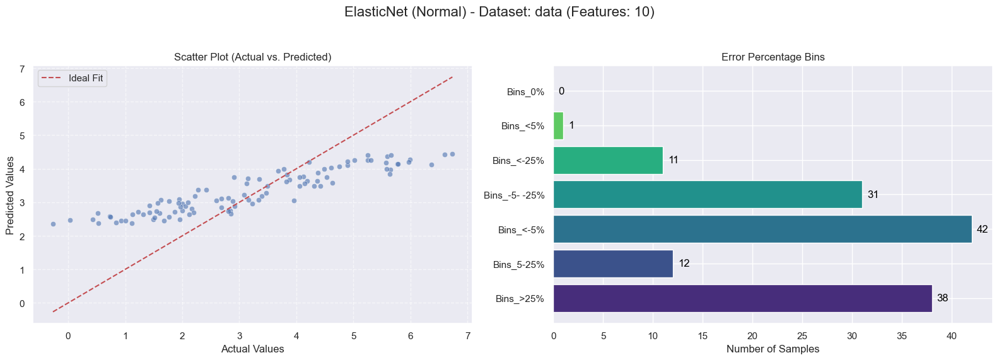

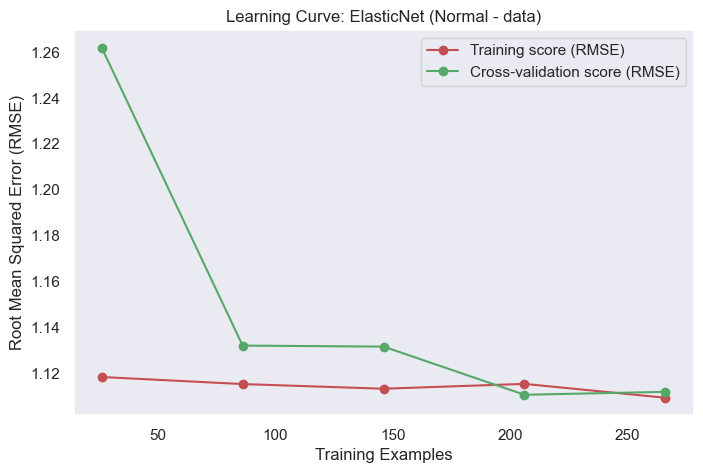

  2. Tuning Model with GridSearchCV...


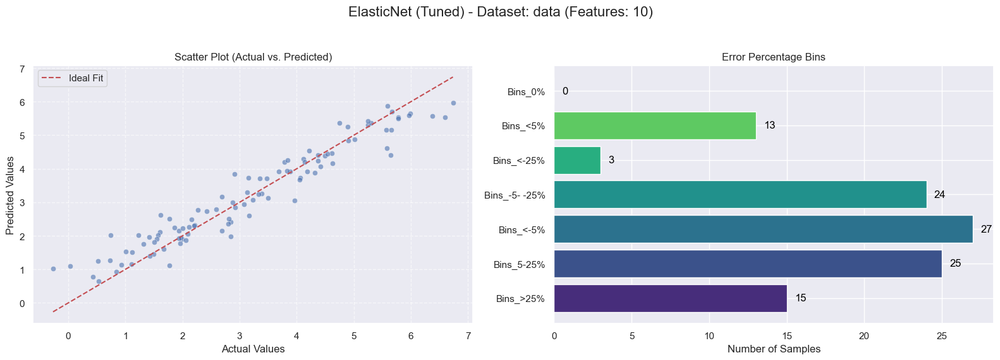

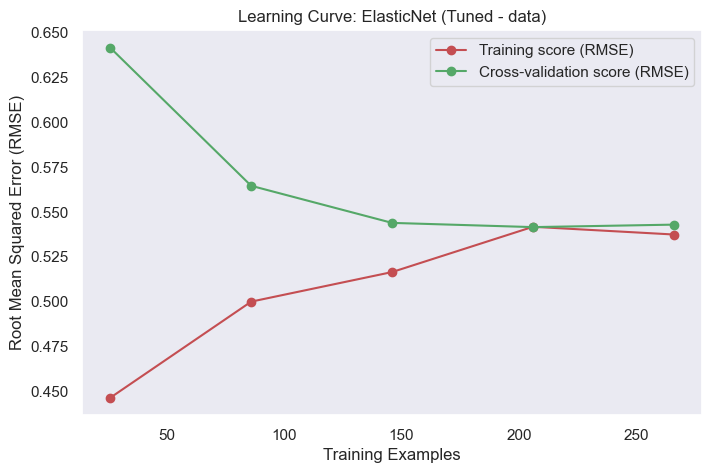

  3. Running RFECV Feature Selection...


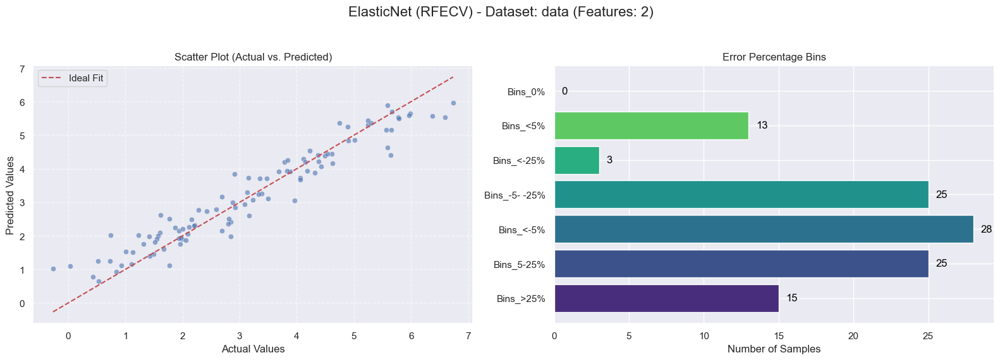

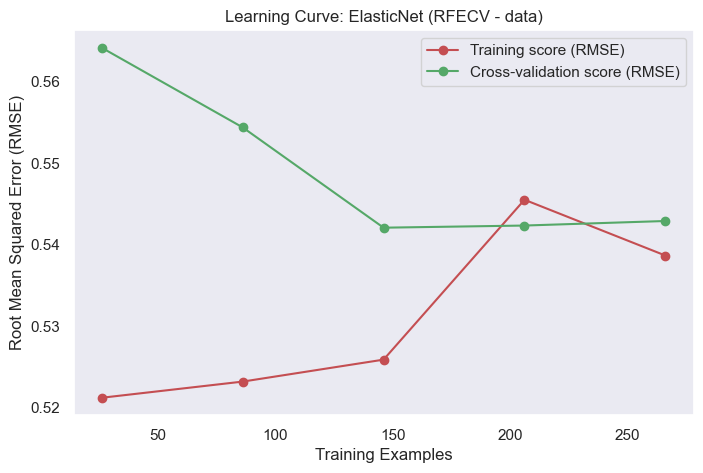

  4. Creating Averaged Ensemble...


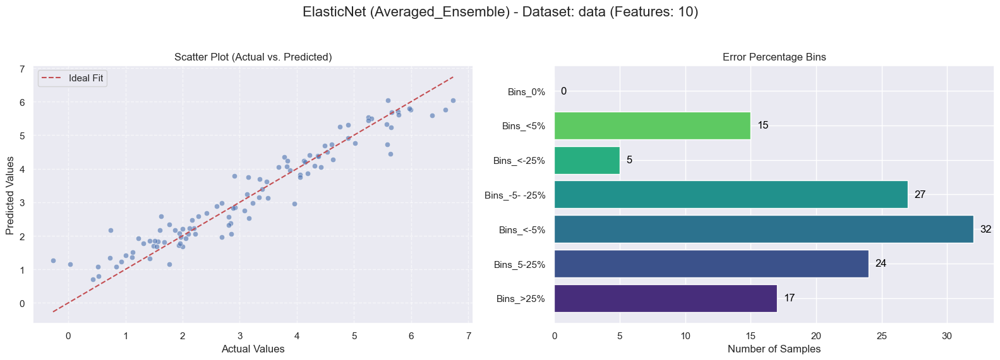

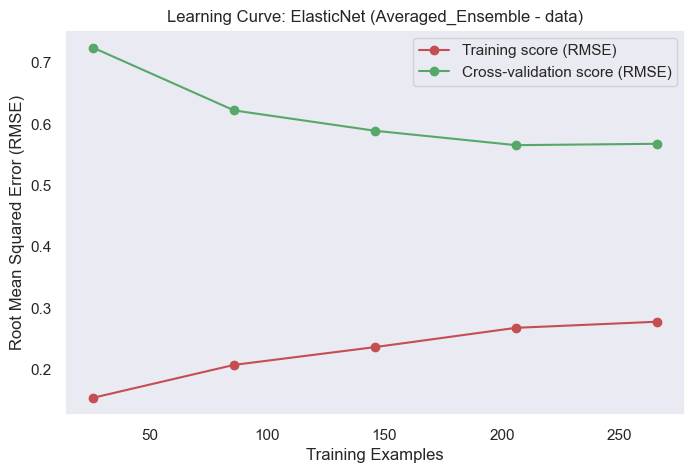


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


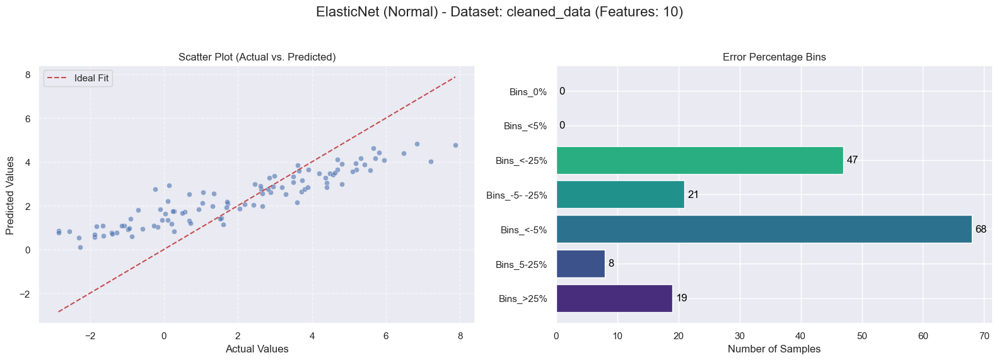

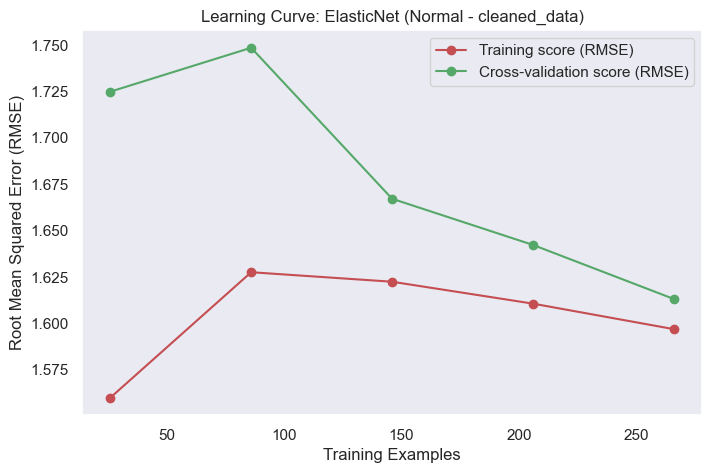

  2. Tuning Model with GridSearchCV...


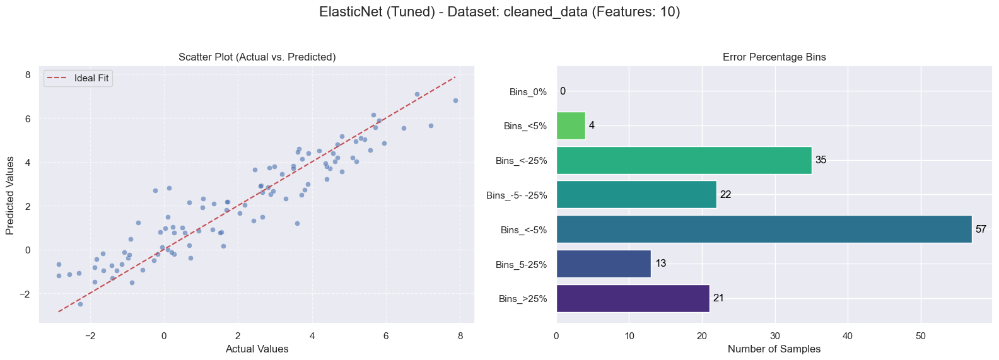

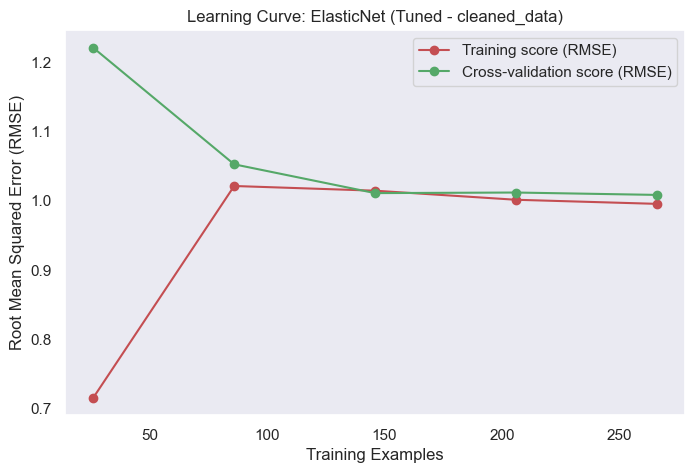

  3. Running RFECV Feature Selection...


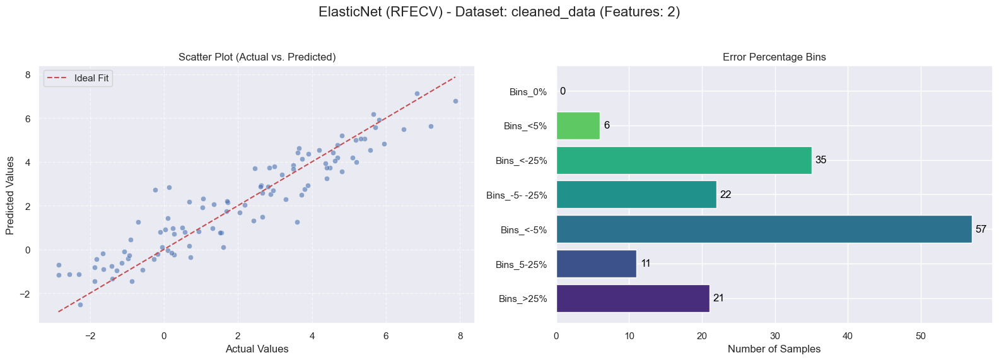

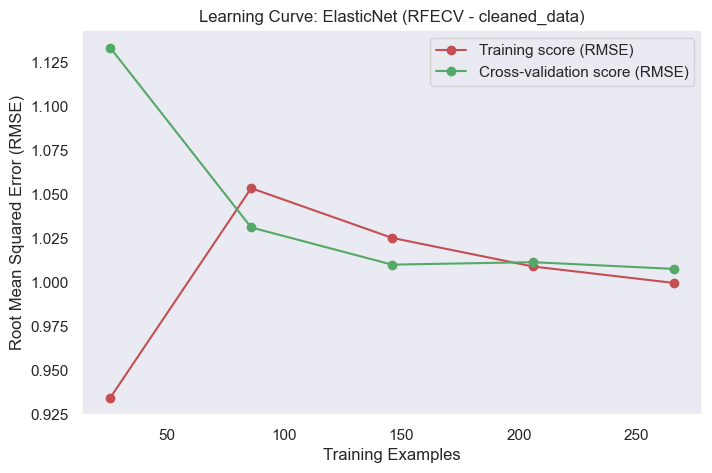

  4. Creating Averaged Ensemble...


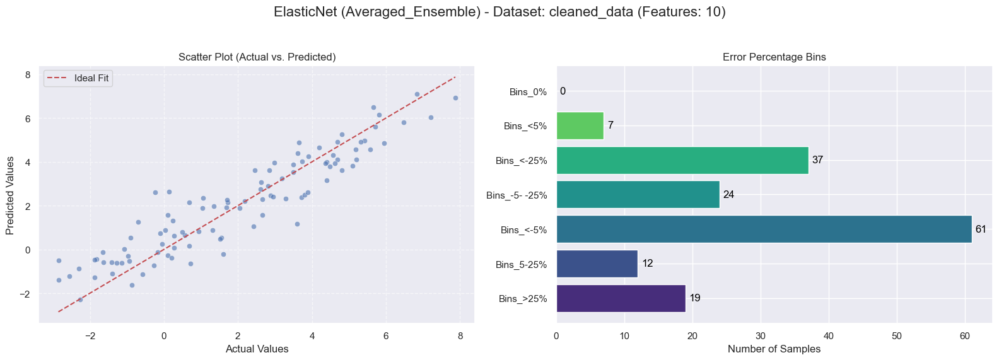

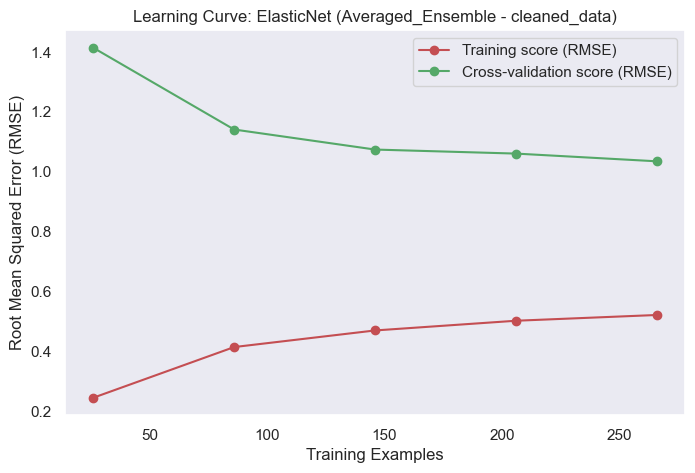


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


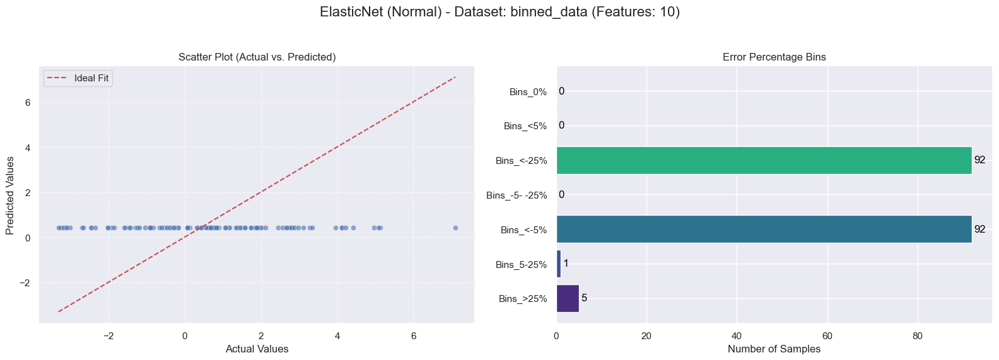

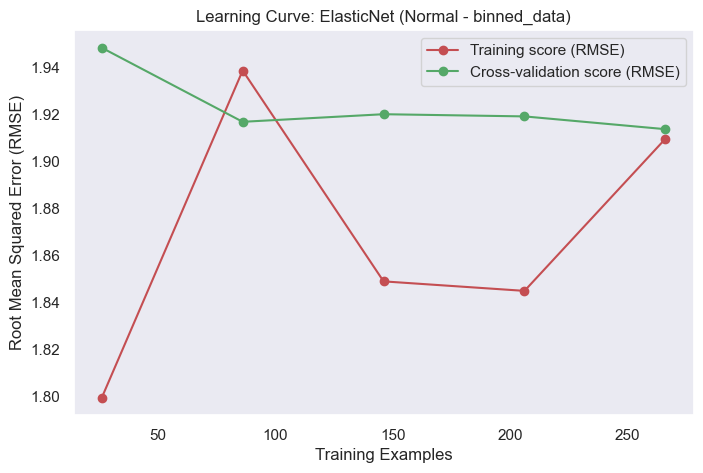

  2. Tuning Model with GridSearchCV...


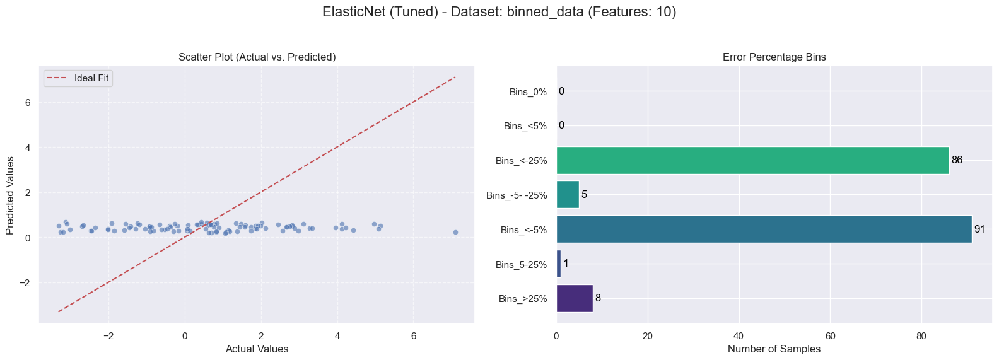

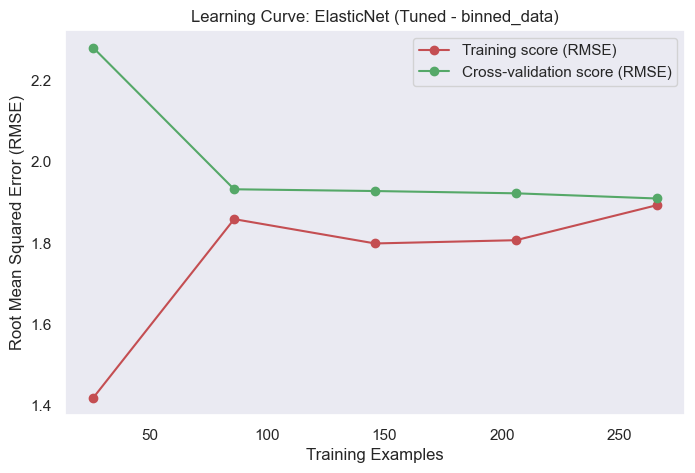

  3. Running RFECV Feature Selection...


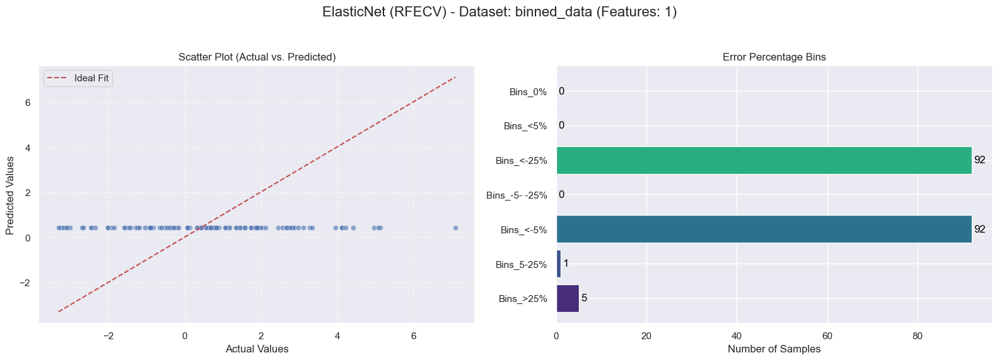

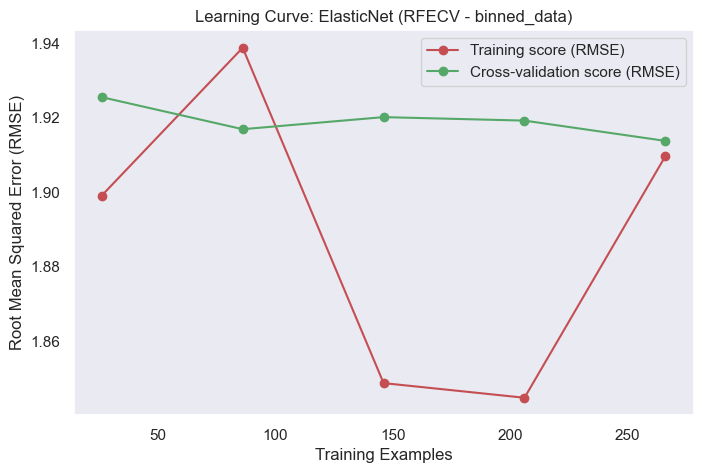

  4. Creating Averaged Ensemble...


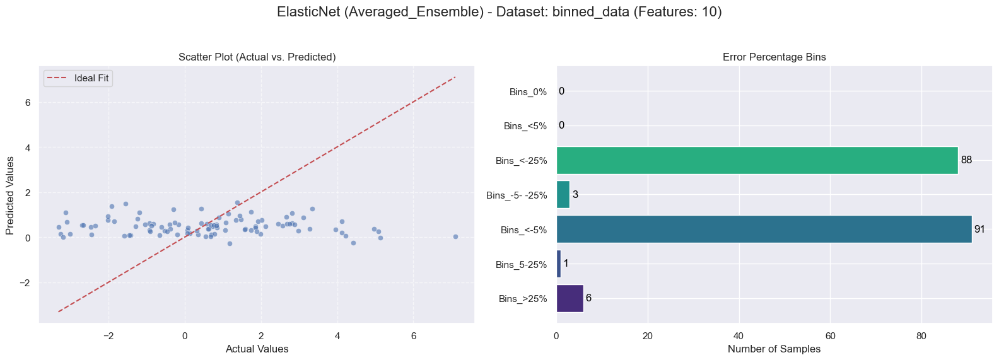

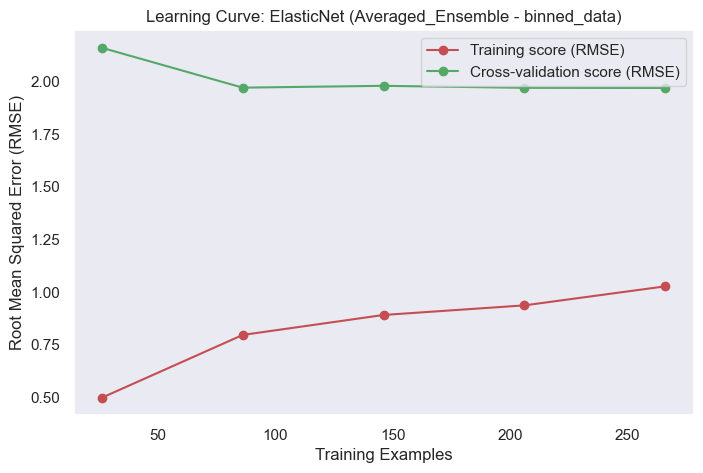

--- Finished Modeling for: ElasticNet ---


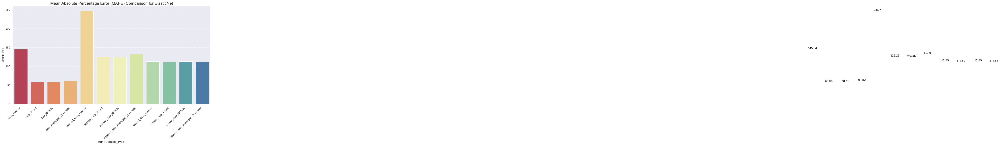





           CONSOLIDATED RESULTS FOR ElasticNet

--- Best Parameters for Tuned ElasticNet Models ---
        Dataset                      Best_Params
0          data  {'alpha': 0.1, 'l1_ratio': 0.5}
1  cleaned_data  {'alpha': 0.1, 'l1_ratio': 0.9}
2   binned_data  {'alpha': 0.1, 'l1_ratio': 0.9}
         Model               Type       Dataset        MAPE       SMAPE  \
59  ElasticNet  Averaged_Ensemble   binned_data  111.877065   142.38775   
56  ElasticNet             Normal   binned_data  112.851571  144.185831   
58  ElasticNet              RFECV   binned_data  112.851571  144.185831   
57  ElasticNet              Tuned   binned_data  111.887391  144.903102   
55  ElasticNet  Averaged_Ensemble  cleaned_data  132.358972   61.762112   
52  ElasticNet             Normal  cleaned_data  246.772888    85.10754   
54  ElasticNet              RFECV  cleaned_data  124.461219   58.709934   
53  ElasticNet              Tuned  cleaned_data  125.350721   58.764805   
51  ElasticNet  Averaged_

In [64]:
MODEL_NAME = 'ElasticNet' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 6. RandomForest

--- Starting Modeling for: RandomForest ---

--- Processing Dataset: data ---
  1. Training Normal Model...


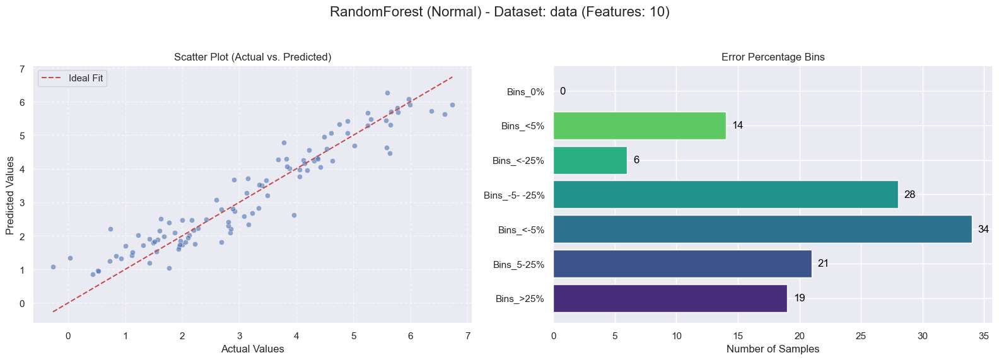

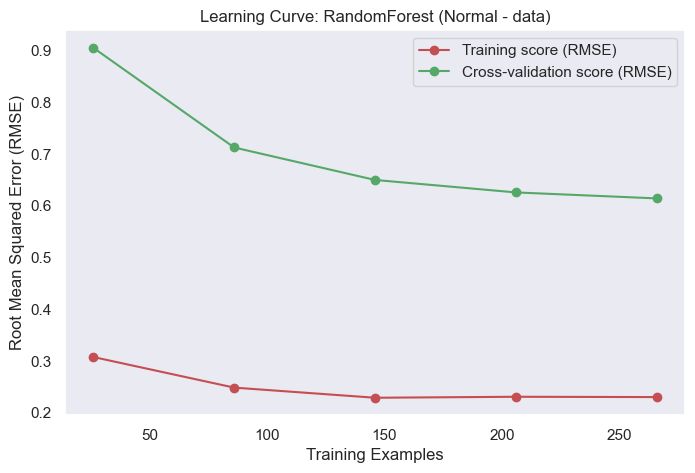

  2. Tuning Model with GridSearchCV...


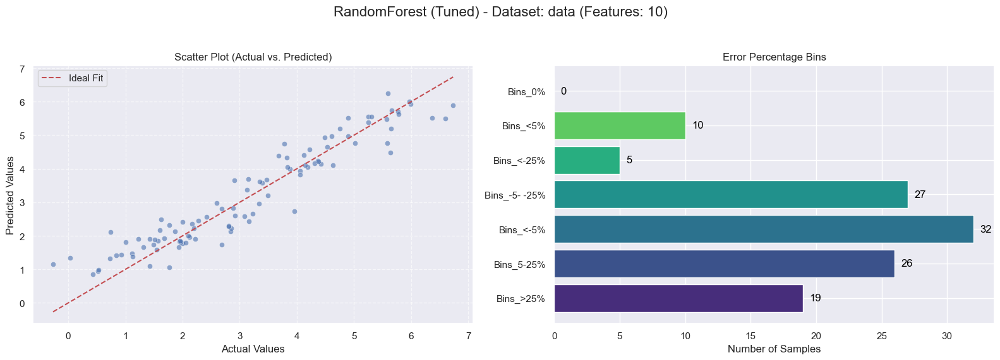

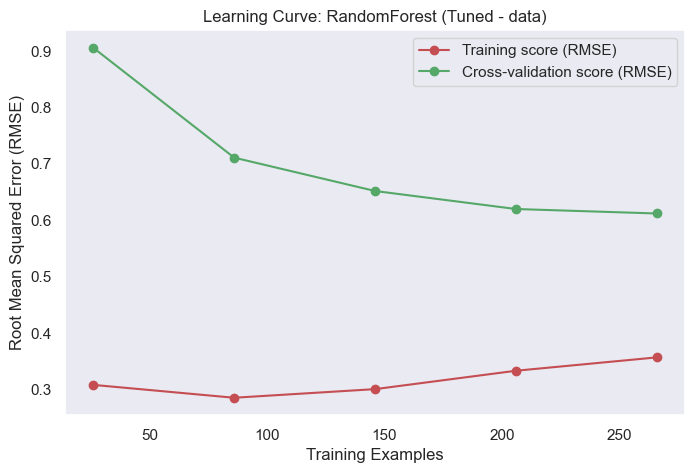

  3. Running RFECV Feature Selection...


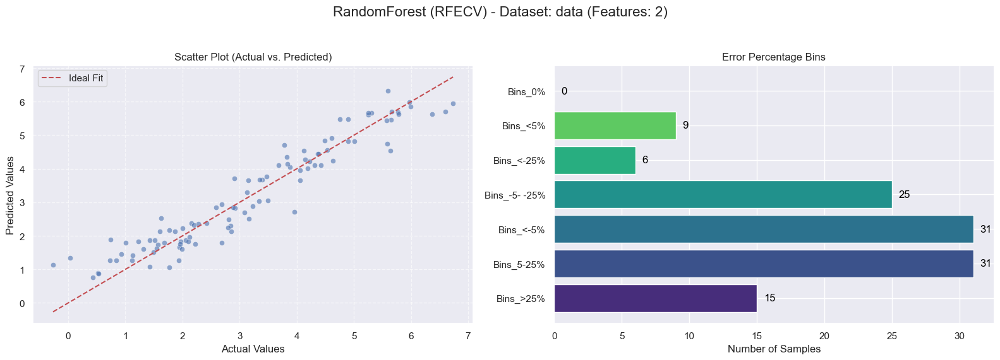

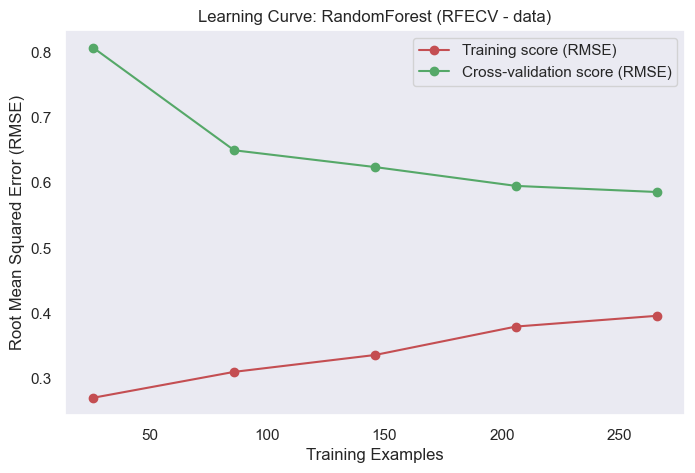

  4. Creating Averaged Ensemble...


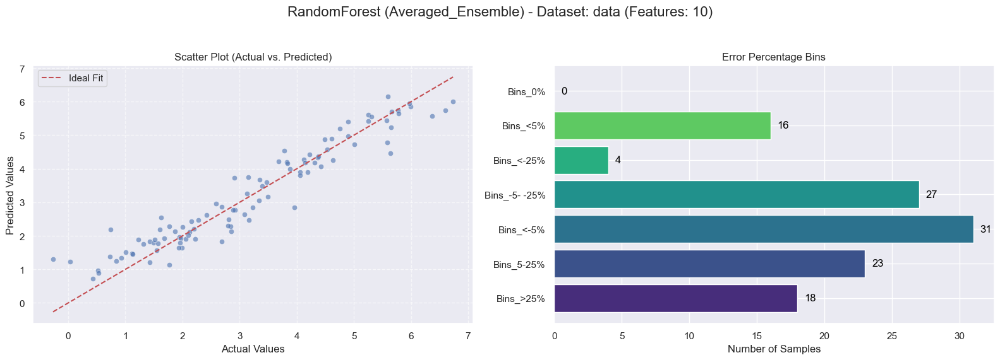

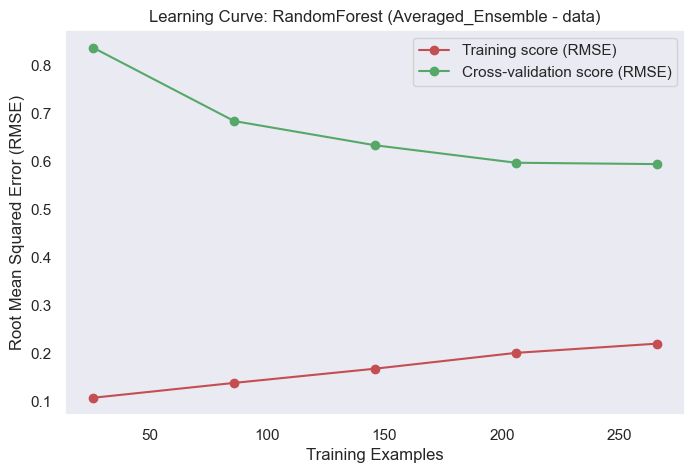


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


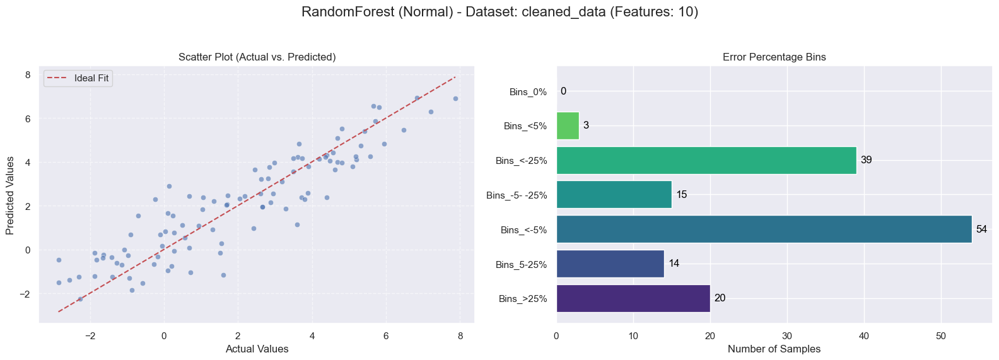

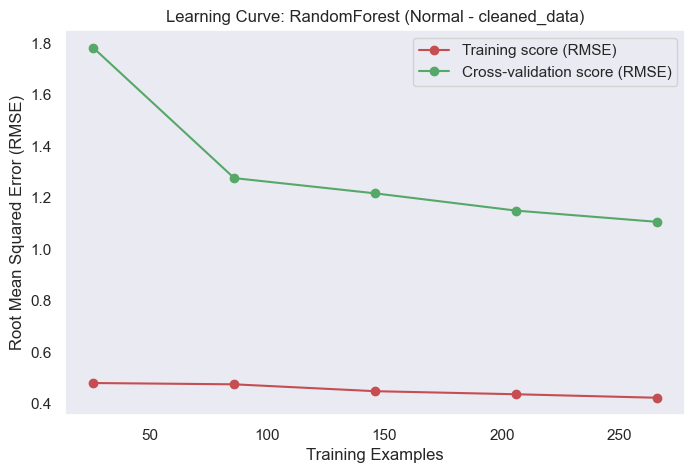

  2. Tuning Model with GridSearchCV...


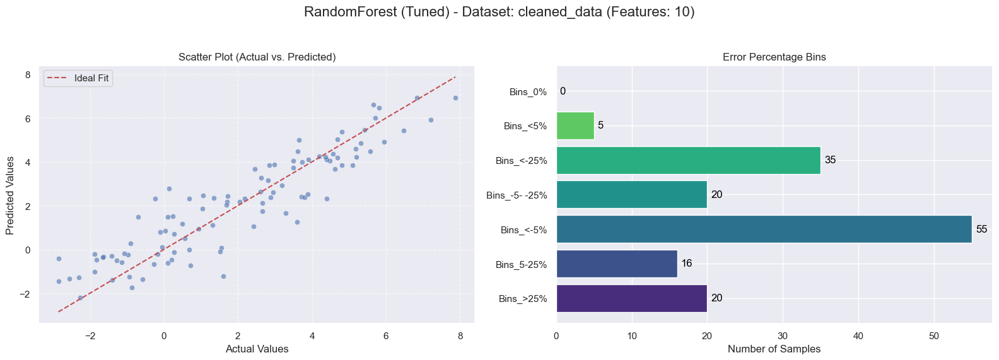

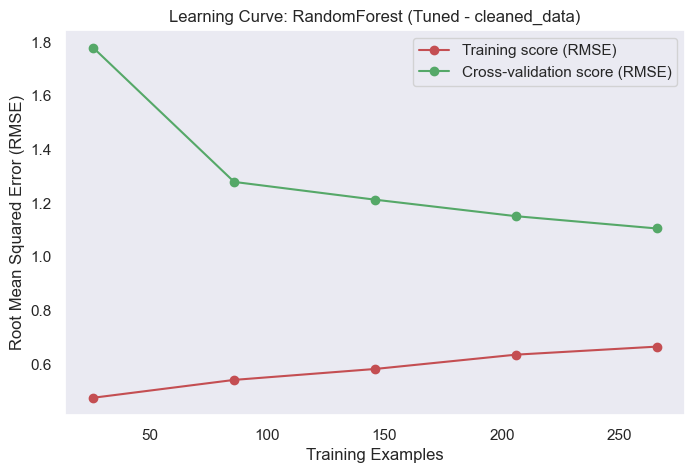

  3. Running RFECV Feature Selection...


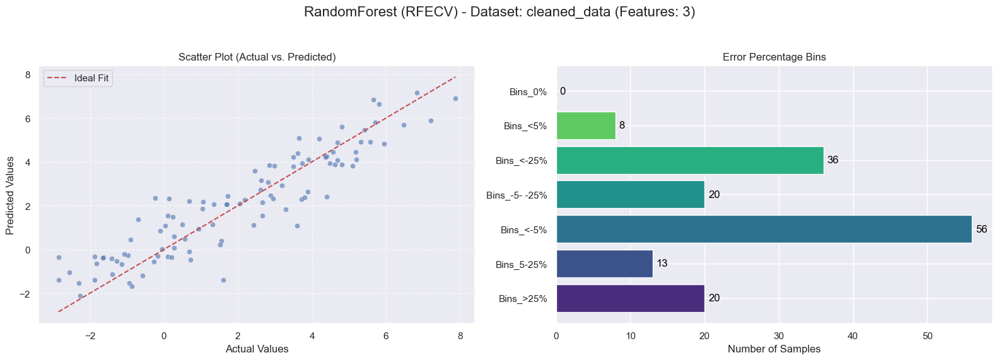

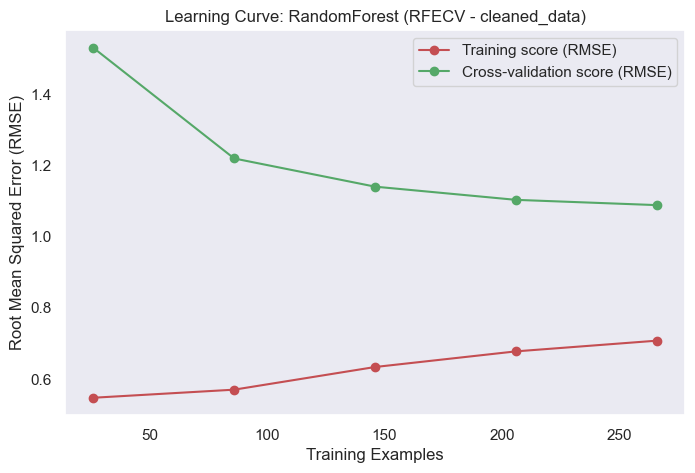

  4. Creating Averaged Ensemble...


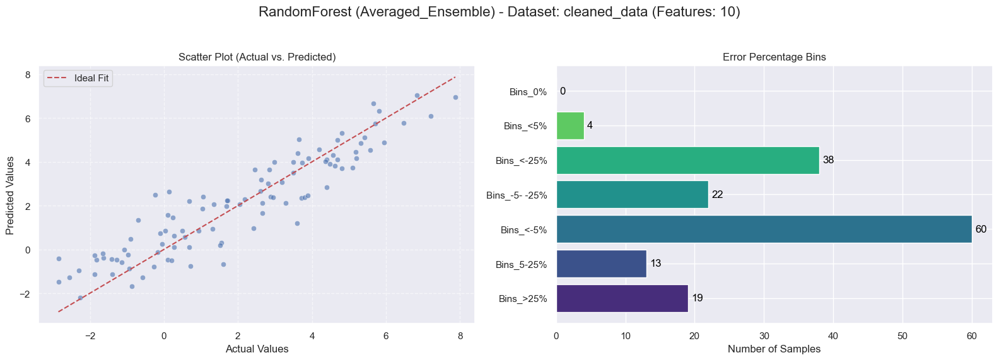

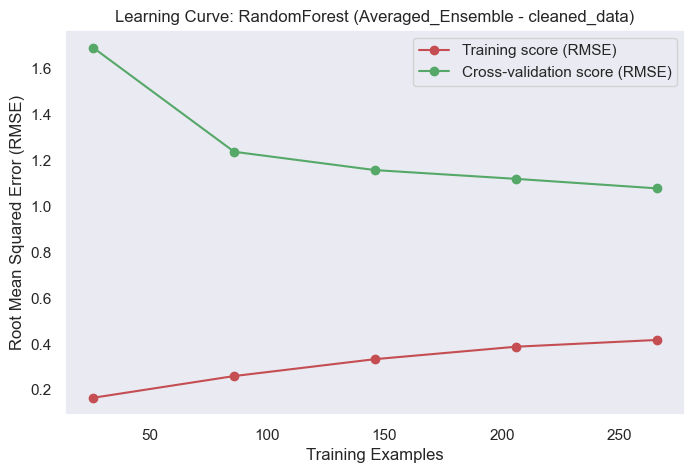


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


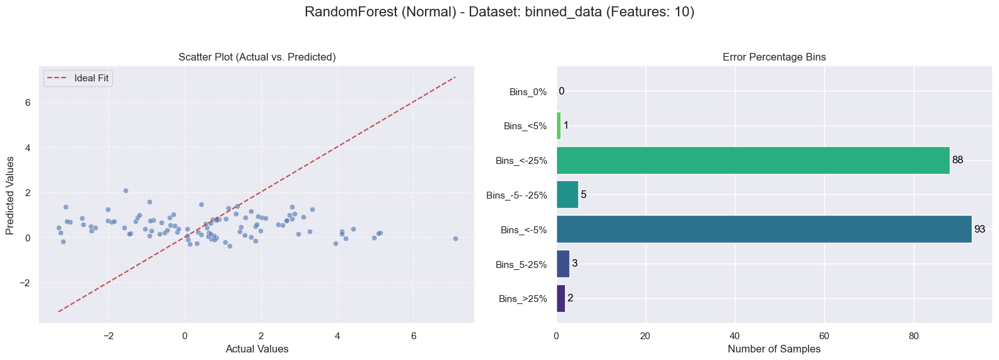

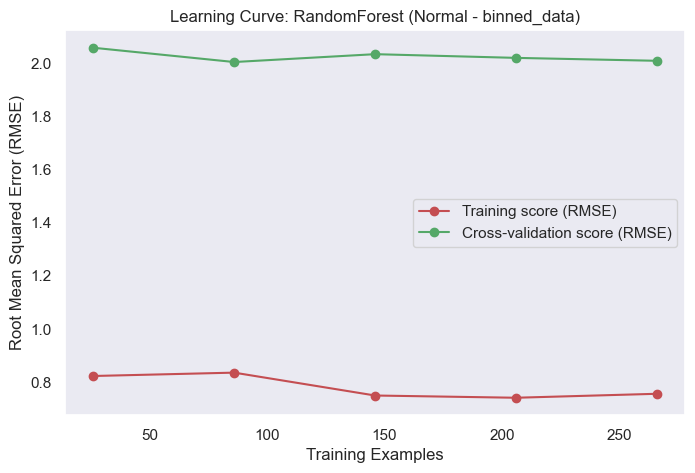

  2. Tuning Model with GridSearchCV...


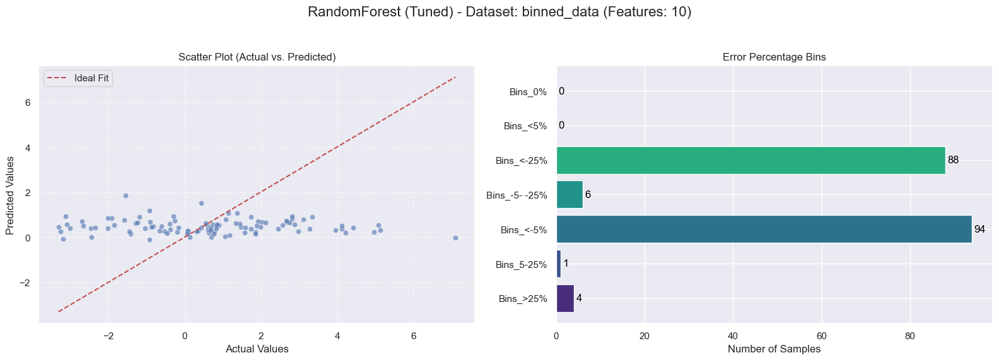

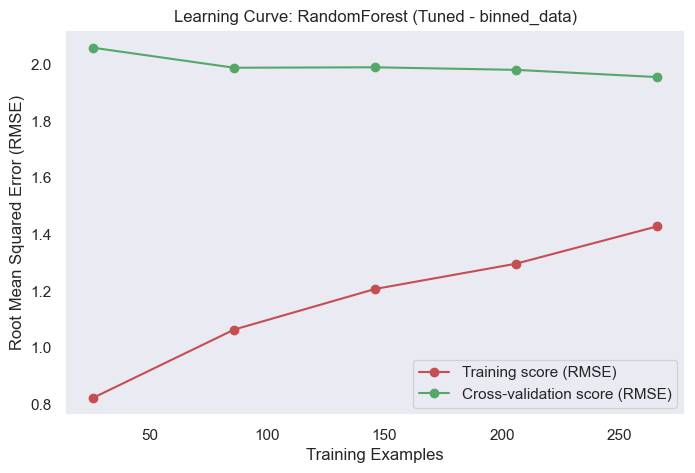

  3. Running RFECV Feature Selection...


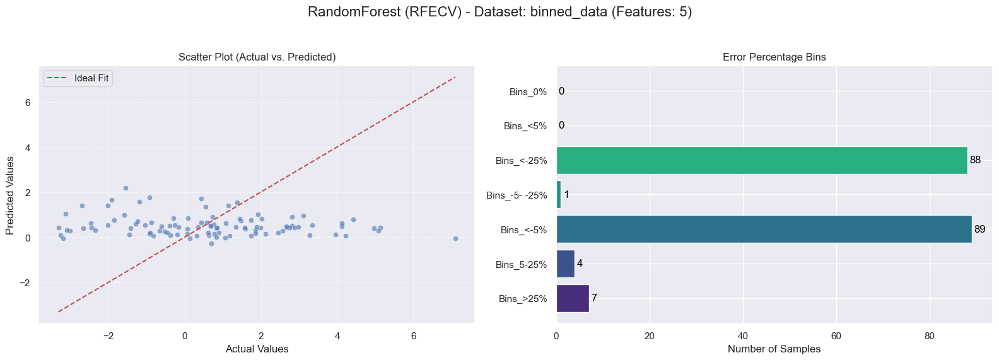

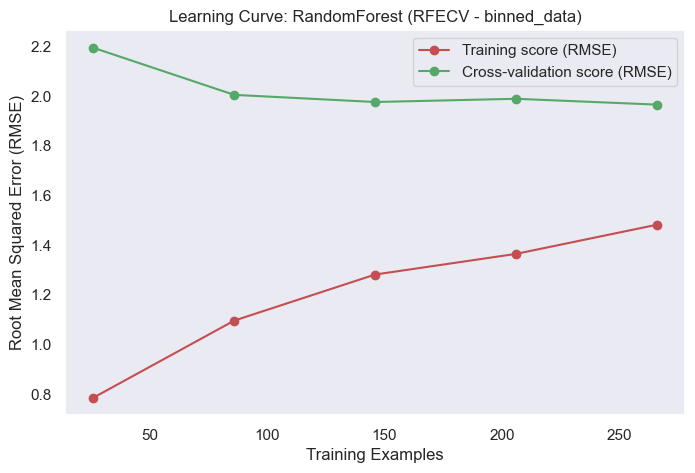

  4. Creating Averaged Ensemble...


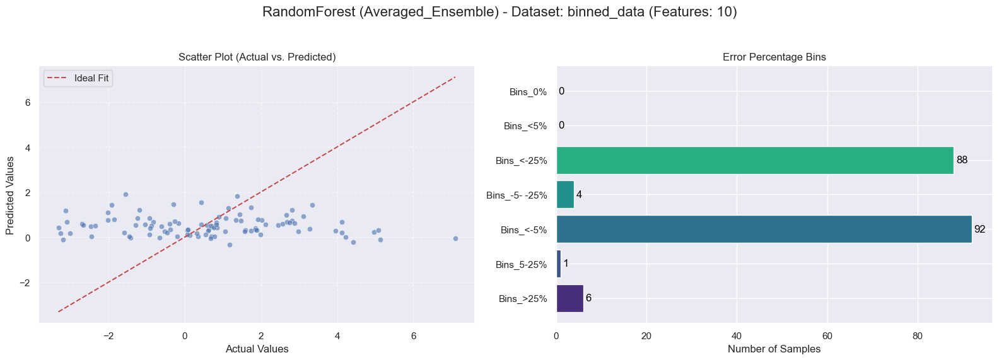

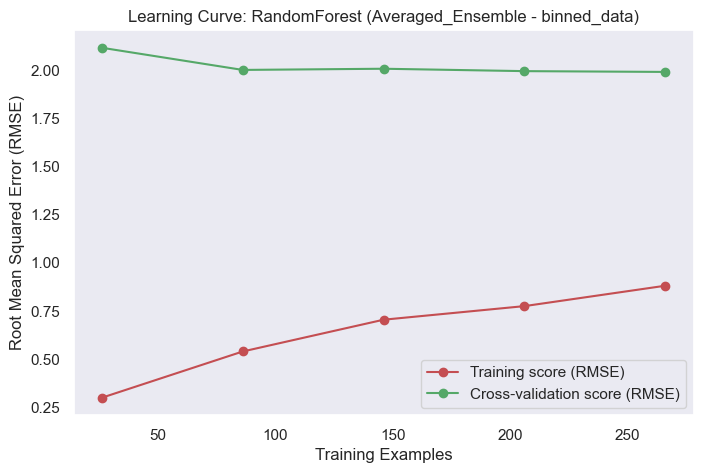

--- Finished Modeling for: RandomForest ---


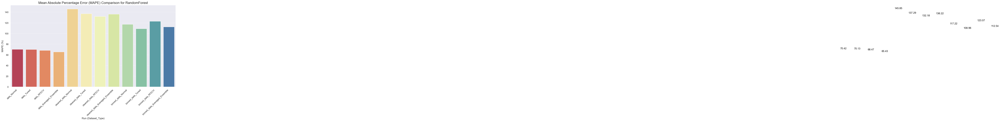





           CONSOLIDATED RESULTS FOR RandomForest

--- Best Parameters for Tuned RandomForest Models ---
        Dataset                            Best_Params
0          data  {'max_depth': 5, 'n_estimators': 100}
1  cleaned_data  {'max_depth': 5, 'n_estimators': 100}
2   binned_data  {'max_depth': 5, 'n_estimators': 100}
           Model               Type       Dataset        MAPE       SMAPE  \
71  RandomForest  Averaged_Ensemble   binned_data  112.538104  143.594789   
68  RandomForest             Normal   binned_data  117.218634  150.209972   
70  RandomForest              RFECV   binned_data  123.072402  151.262287   
69  RandomForest              Tuned   binned_data  108.961594   143.46365   
67  RandomForest  Averaged_Ensemble  cleaned_data  136.218744   64.132798   
64  RandomForest             Normal  cleaned_data  145.853988   66.923178   
66  RandomForest              RFECV  cleaned_data  132.176367   63.820922   
65  RandomForest              Tuned  cleaned_data  137.2

In [65]:
MODEL_NAME = 'RandomForest' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 7. ExtraTrees

--- Starting Modeling for: ExtraTrees ---

--- Processing Dataset: data ---
  1. Training Normal Model...


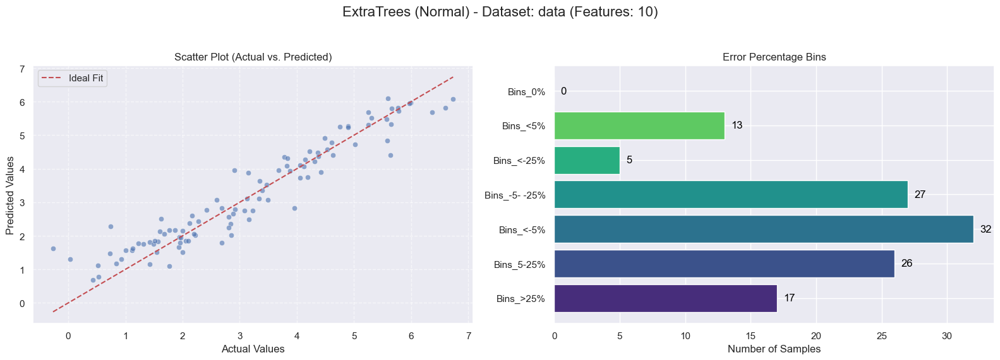

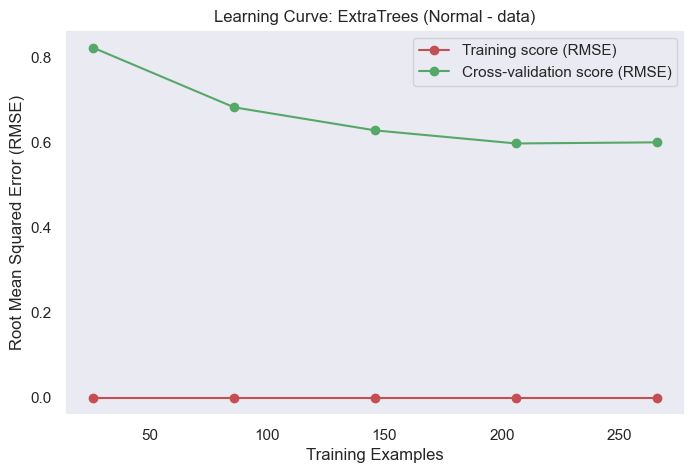

  2. Tuning Model with GridSearchCV...


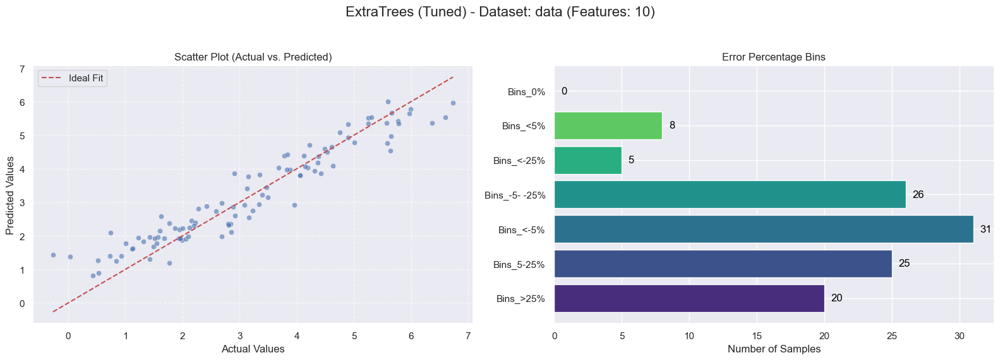

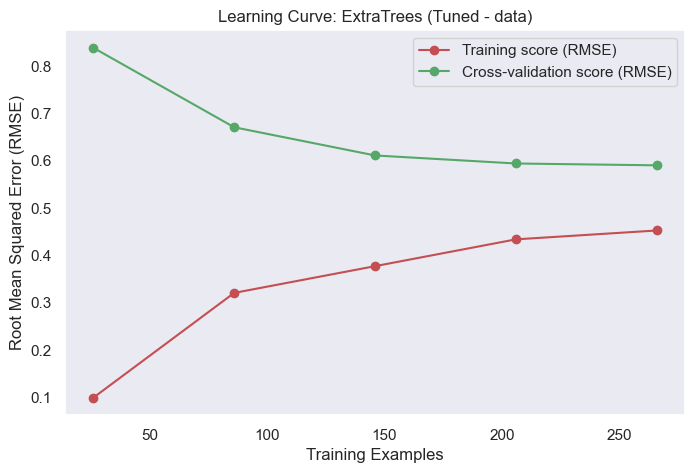

  3. Running RFECV Feature Selection...


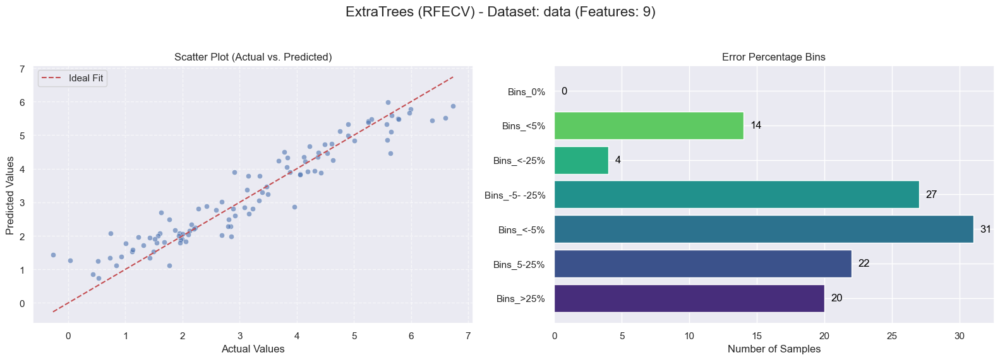

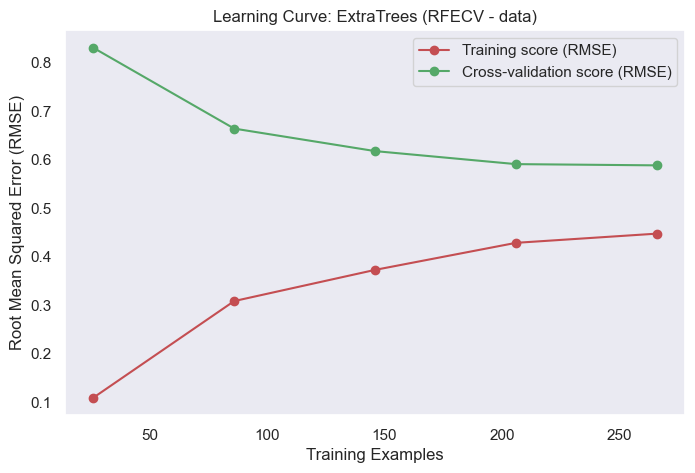

  4. Creating Averaged Ensemble...


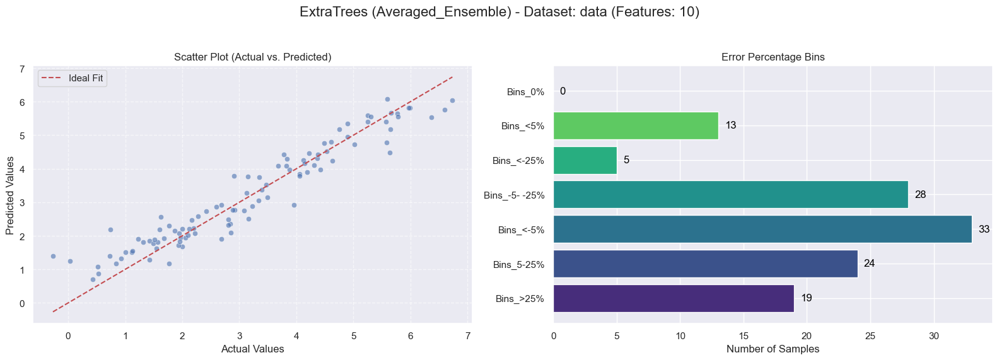

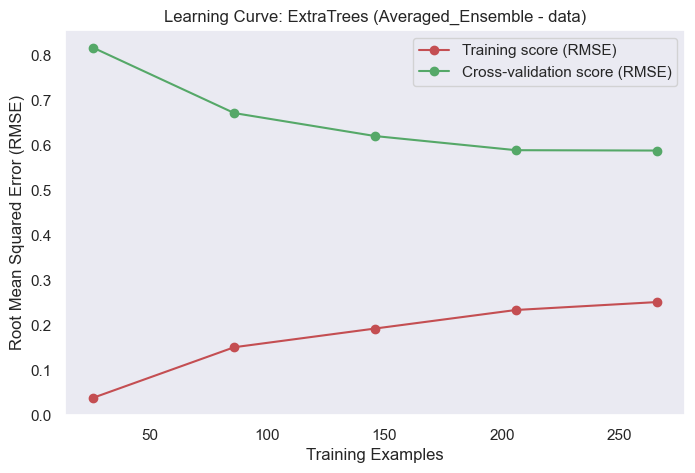


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


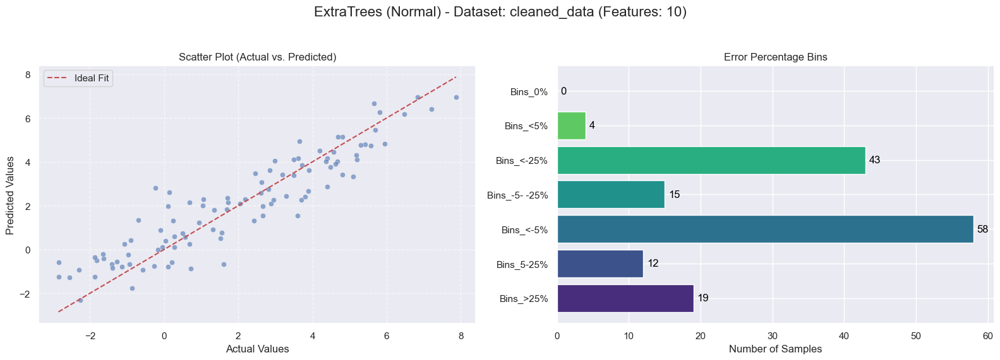

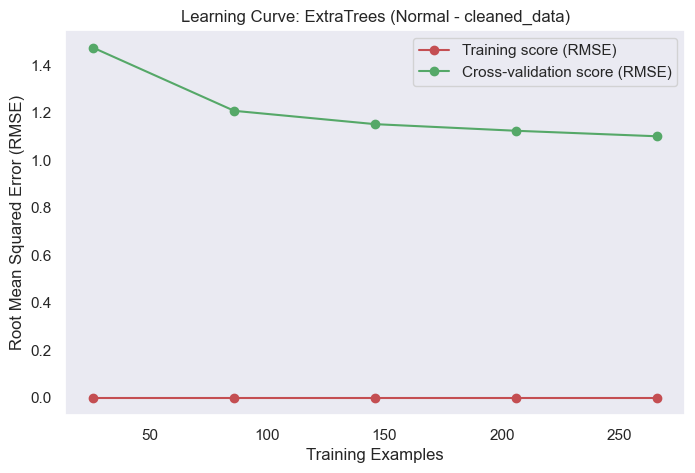

  2. Tuning Model with GridSearchCV...


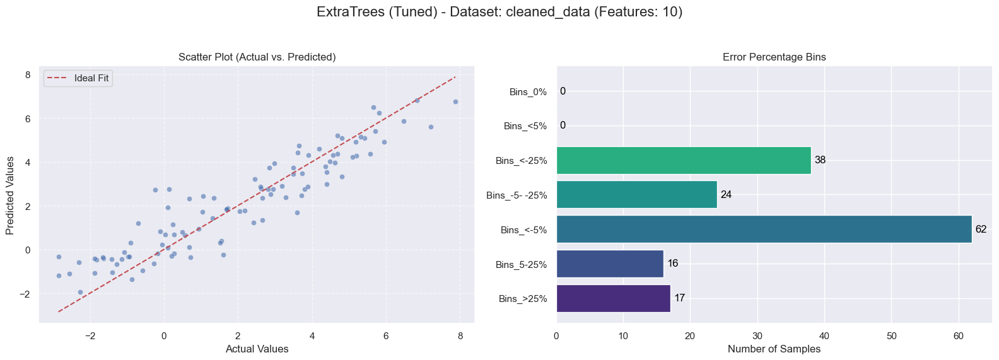

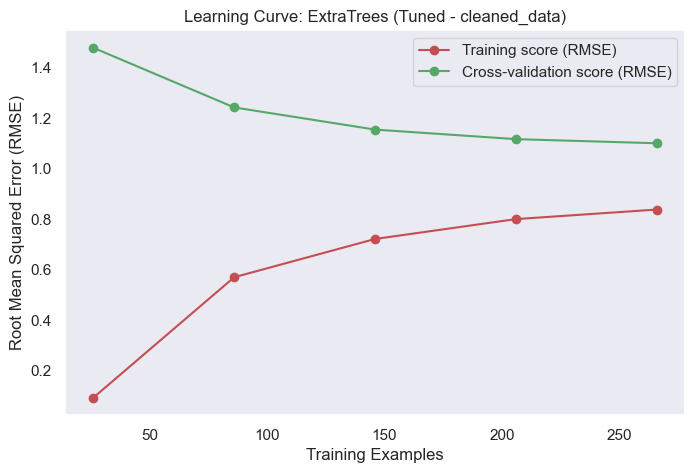

  3. Running RFECV Feature Selection...


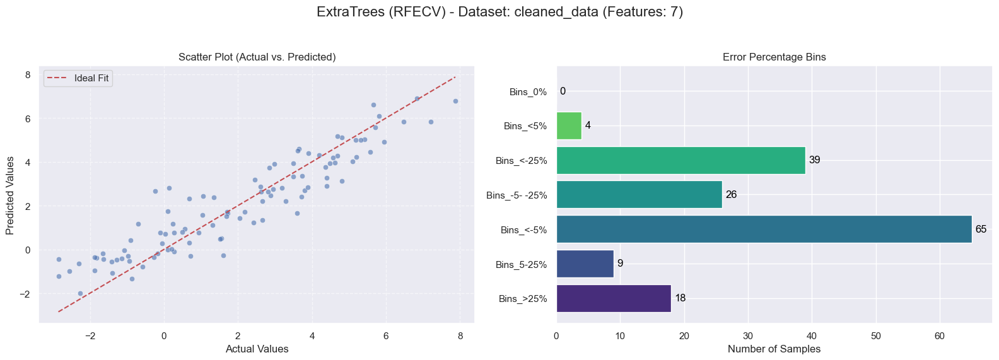

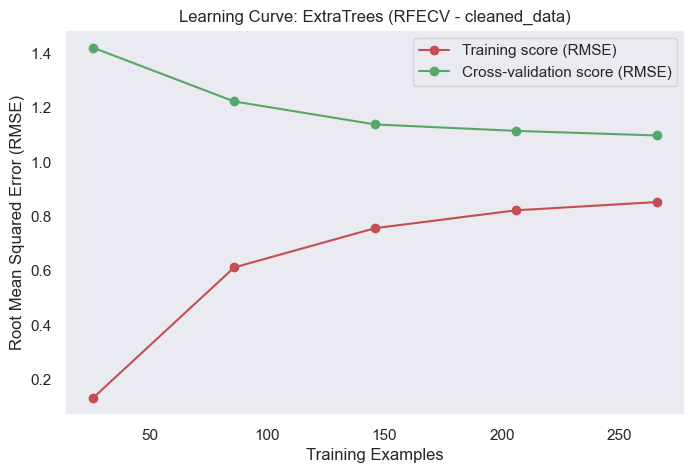

  4. Creating Averaged Ensemble...


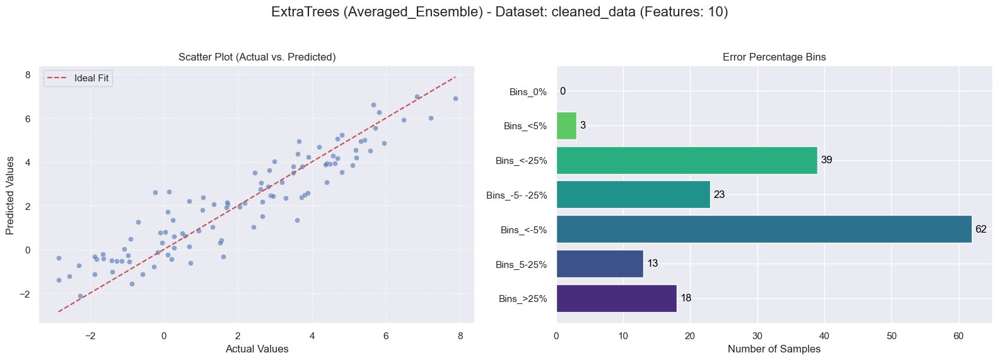

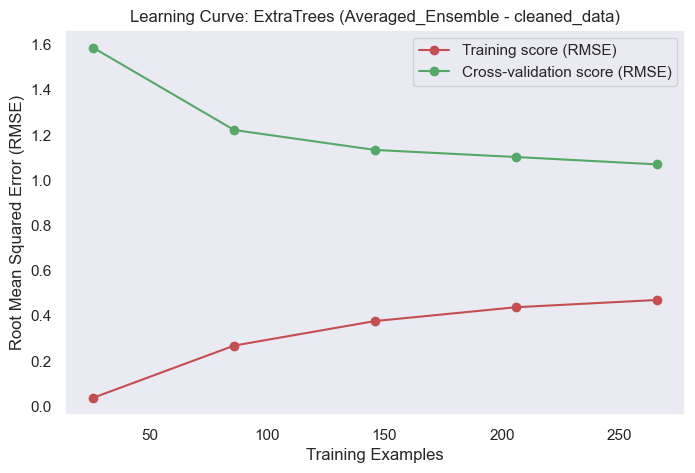


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


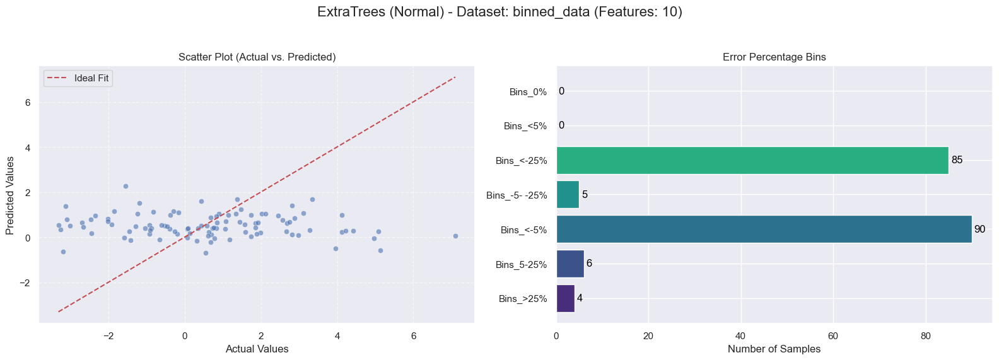

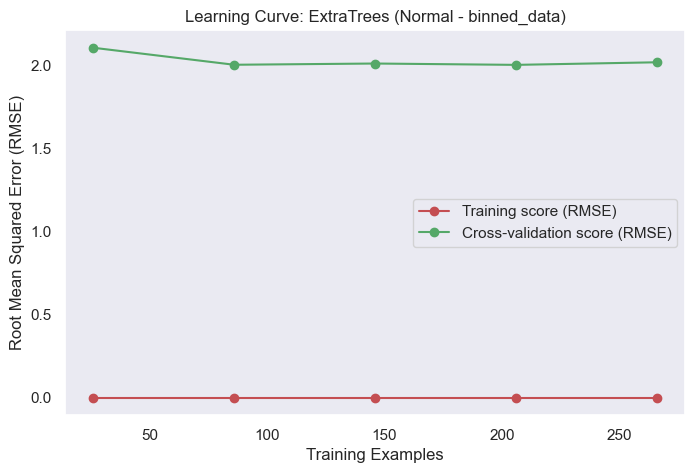

  2. Tuning Model with GridSearchCV...


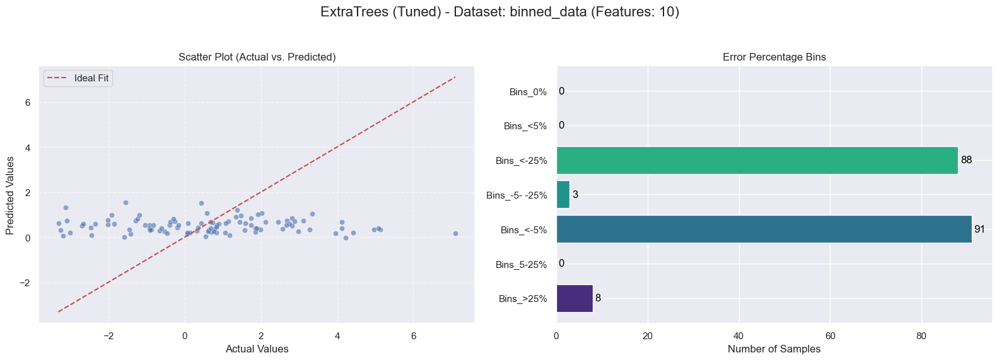

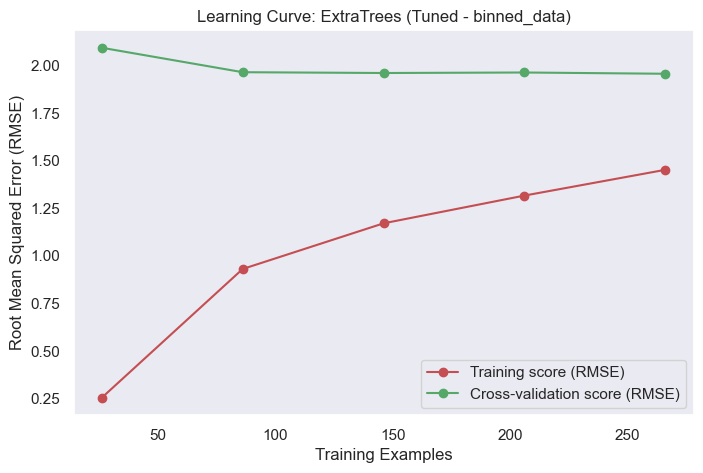

  3. Running RFECV Feature Selection...


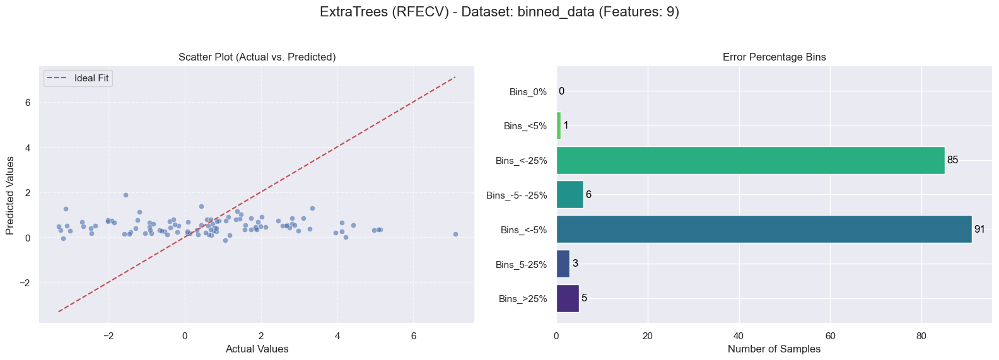

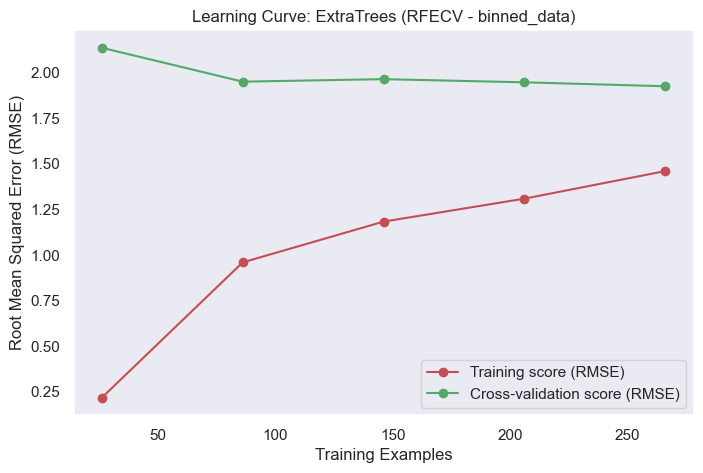

  4. Creating Averaged Ensemble...


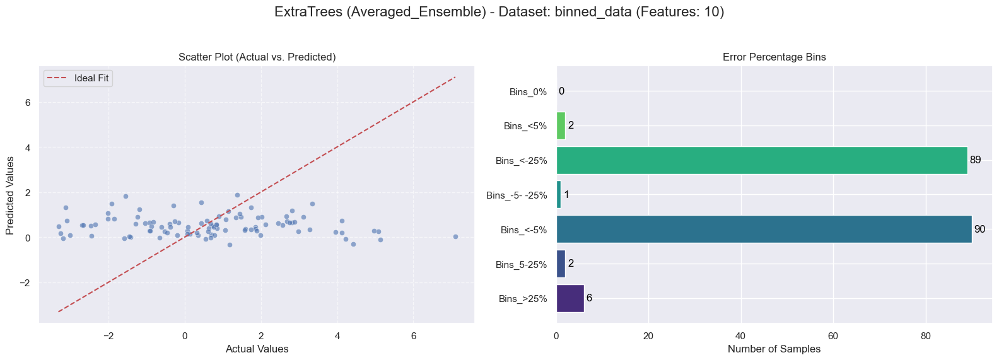

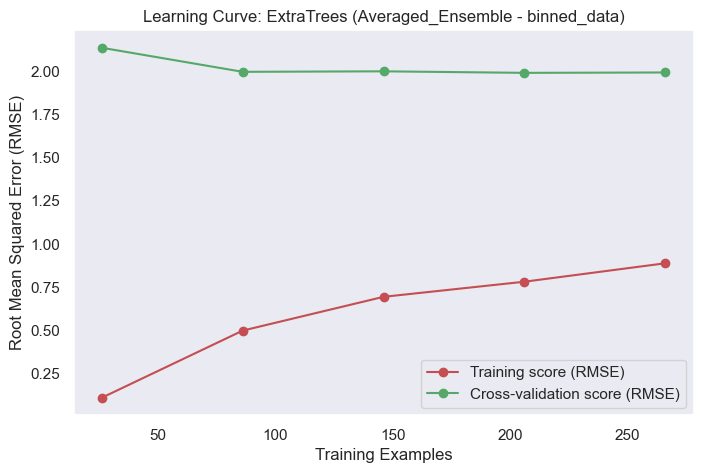

--- Finished Modeling for: ExtraTrees ---


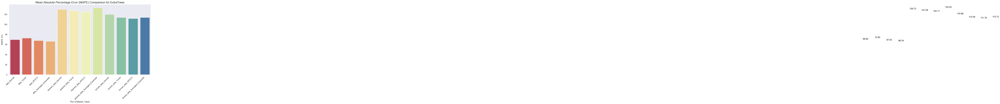





           CONSOLIDATED RESULTS FOR ExtraTrees

--- Best Parameters for Tuned ExtraTrees Models ---
        Dataset                            Best_Params
0          data  {'max_depth': 5, 'n_estimators': 100}
1  cleaned_data   {'max_depth': 5, 'n_estimators': 50}
2   binned_data  {'max_depth': 5, 'n_estimators': 100}
         Model               Type       Dataset        MAPE       SMAPE  \
83  ExtraTrees  Averaged_Ensemble   binned_data  113.721583  142.257006   
80  ExtraTrees             Normal   binned_data   119.97887   144.56407   
82  ExtraTrees              RFECV   binned_data  111.696324  140.967753   
81  ExtraTrees              Tuned   binned_data  113.588166  140.919585   
79  ExtraTrees  Averaged_Ensemble  cleaned_data  133.019362   63.227114   
76  ExtraTrees             Normal  cleaned_data  129.722592   62.677422   
78  ExtraTrees              RFECV  cleaned_data  125.172019   62.614153   
77  ExtraTrees              Tuned  cleaned_data  127.079432   61.520754   
7

In [66]:
MODEL_NAME = 'ExtraTrees' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 8. GradientBoosting

--- Starting Modeling for: GradientBoosting ---

--- Processing Dataset: data ---
  1. Training Normal Model...


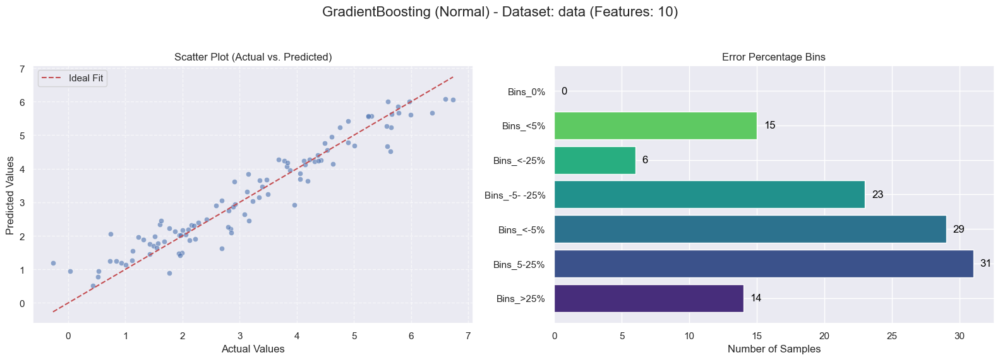

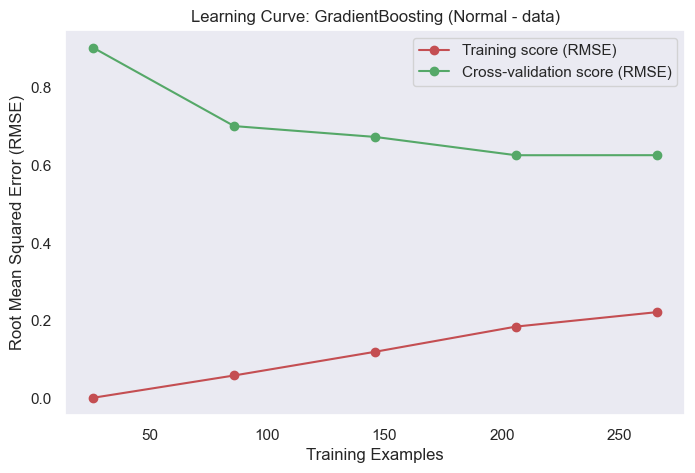

  2. Tuning Model with GridSearchCV...


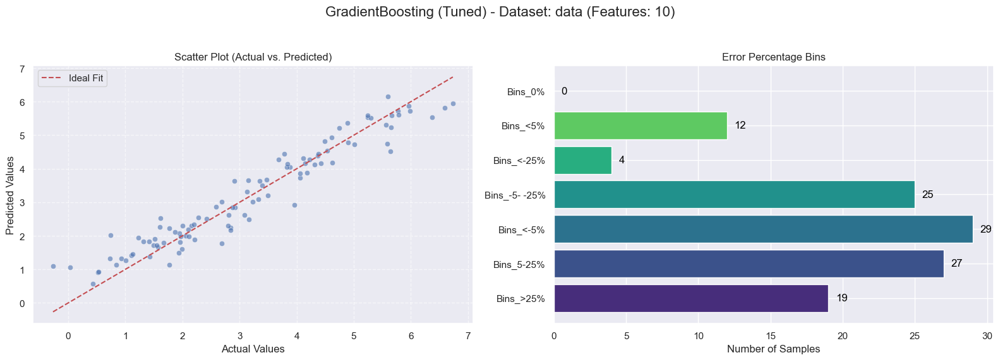

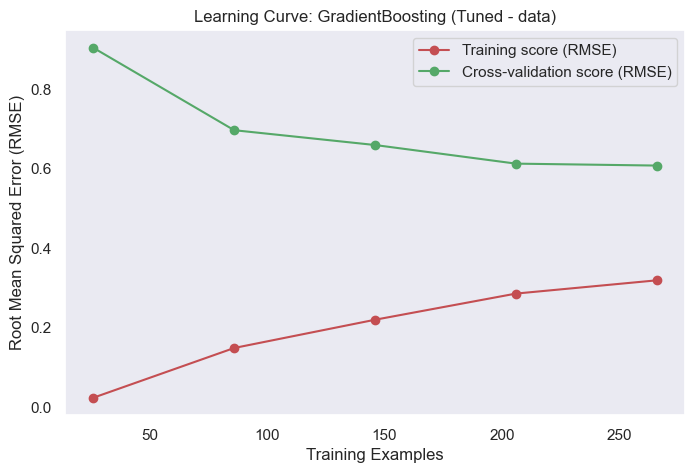

  3. Running RFECV Feature Selection...


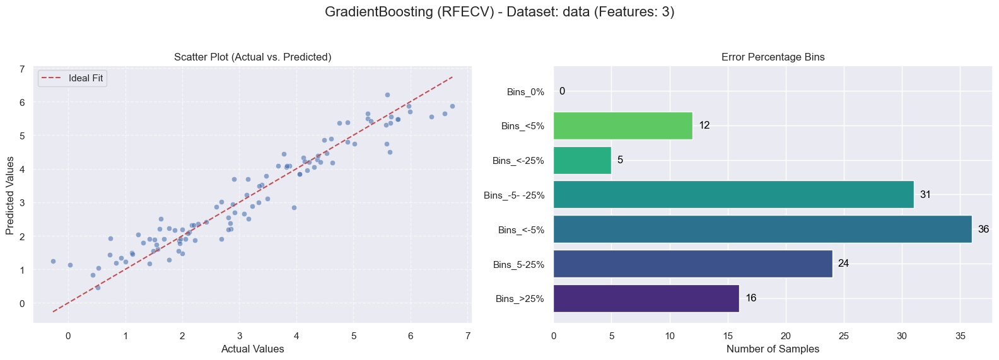

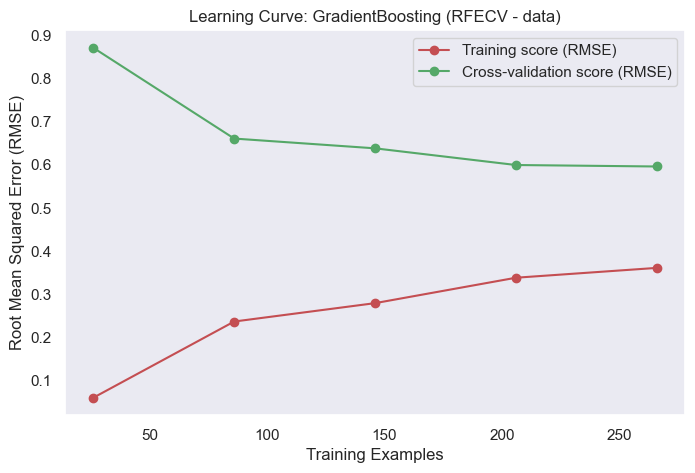

  4. Creating Averaged Ensemble...


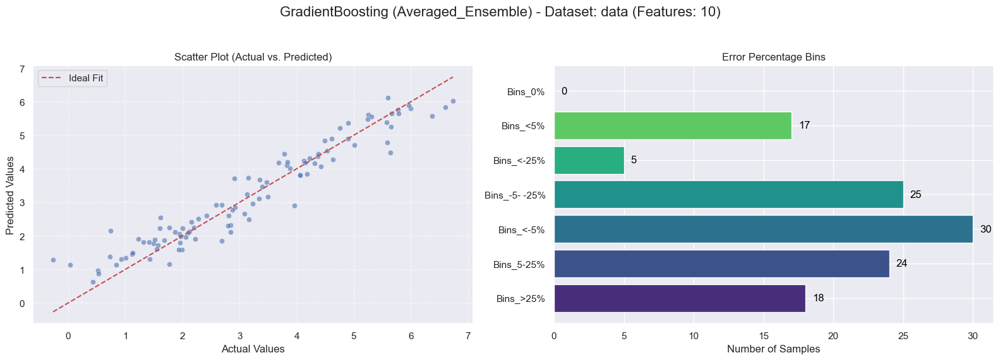

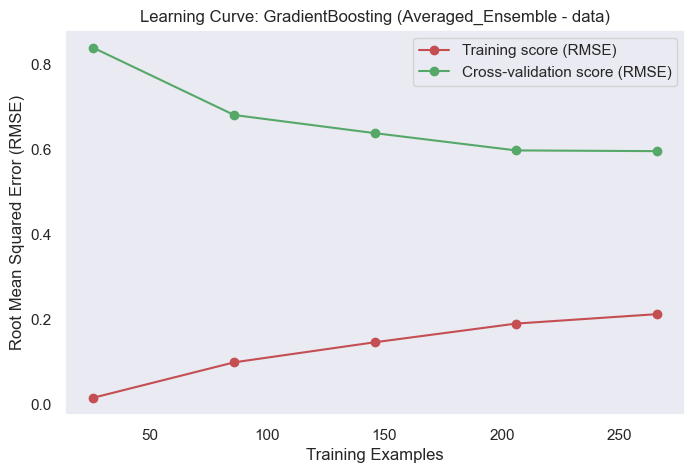


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


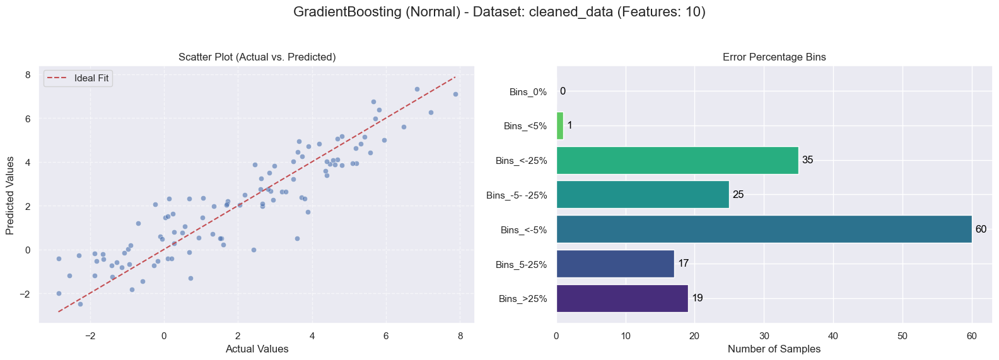

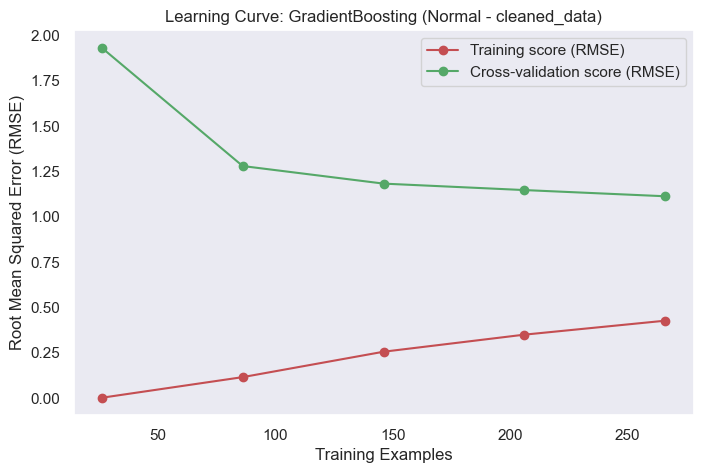

  2. Tuning Model with GridSearchCV...


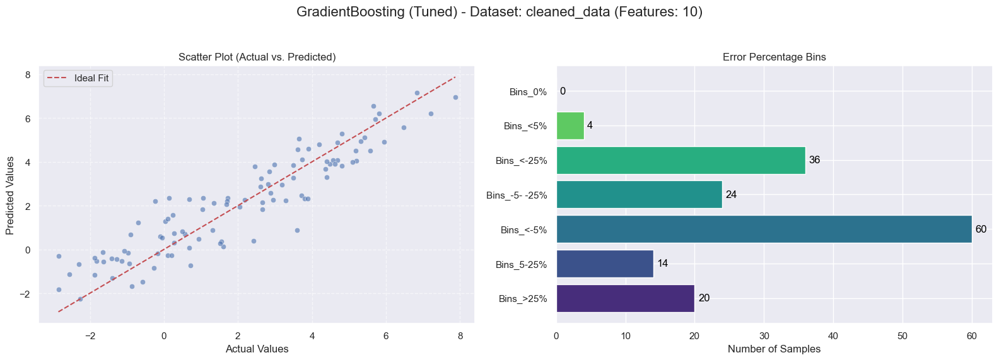

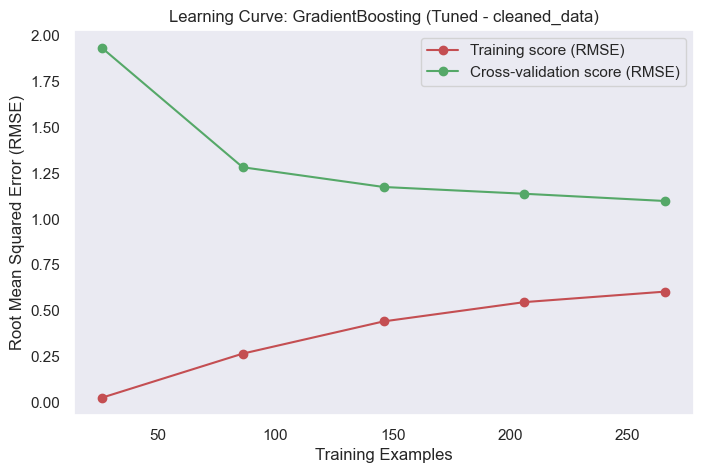

  3. Running RFECV Feature Selection...


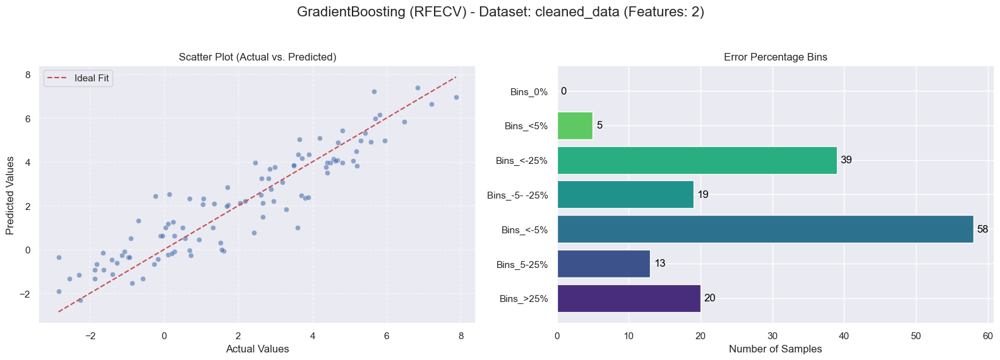

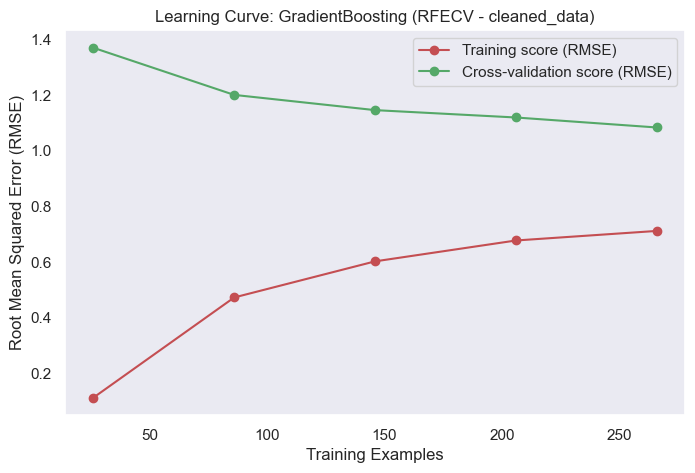

  4. Creating Averaged Ensemble...


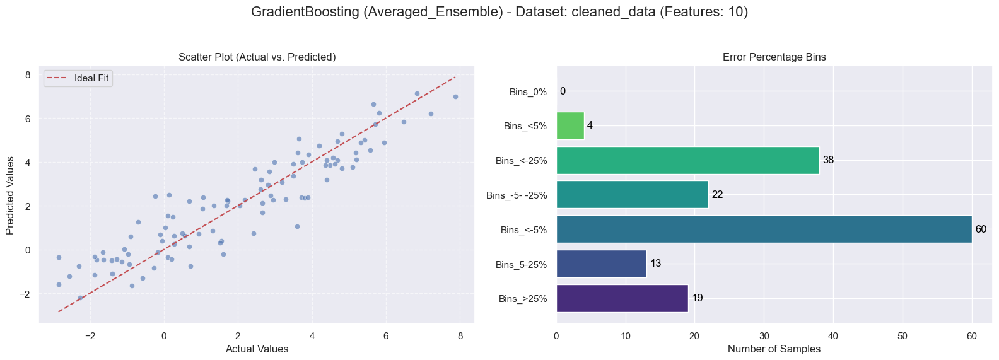

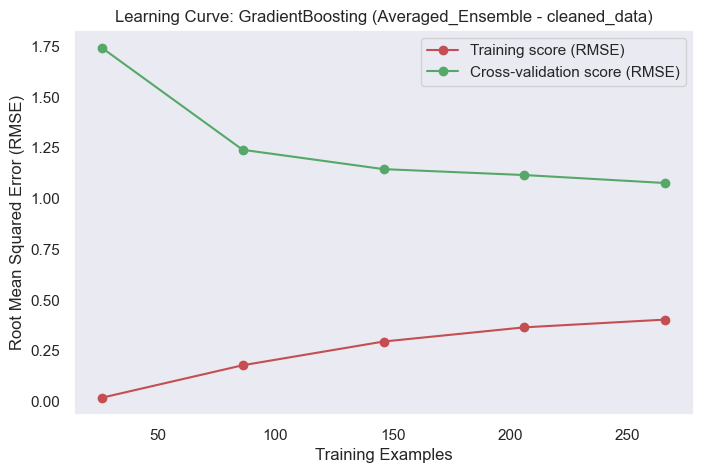


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


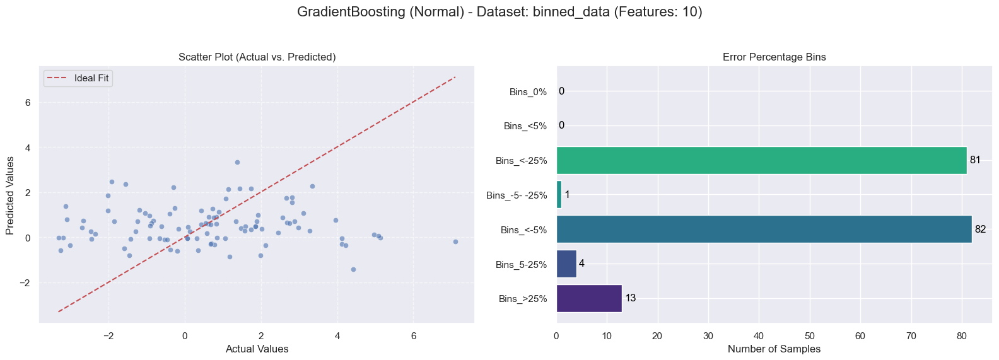

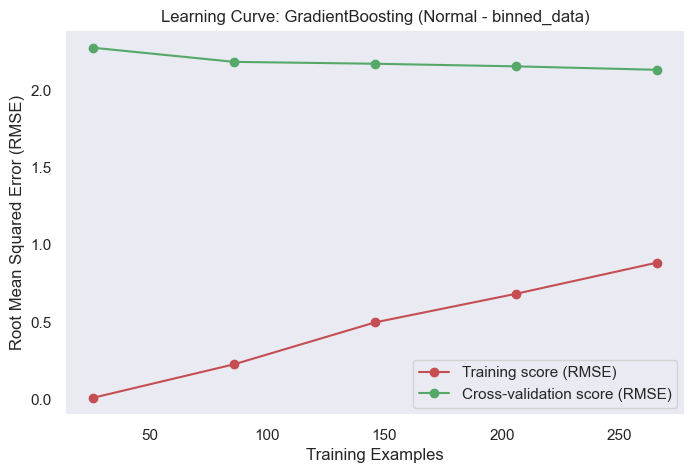

  2. Tuning Model with GridSearchCV...


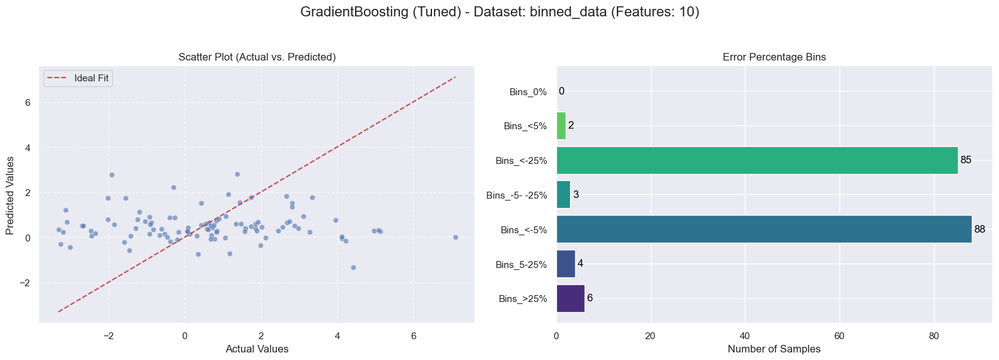

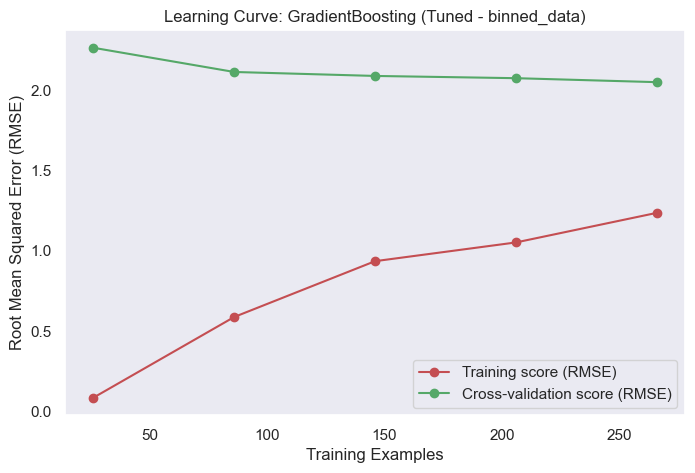

  3. Running RFECV Feature Selection...


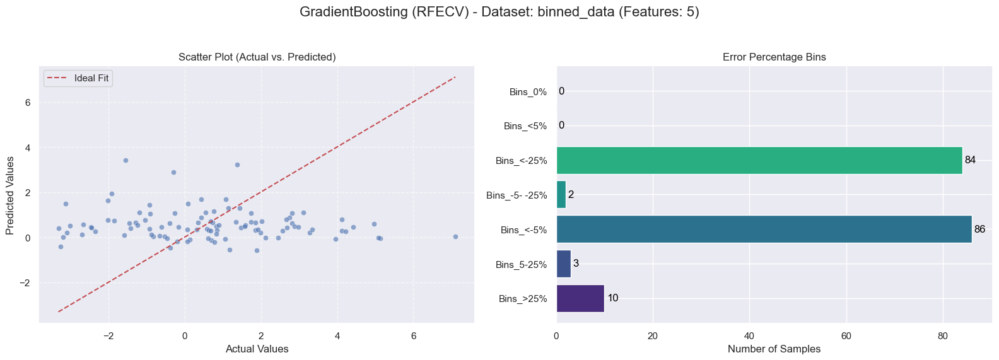

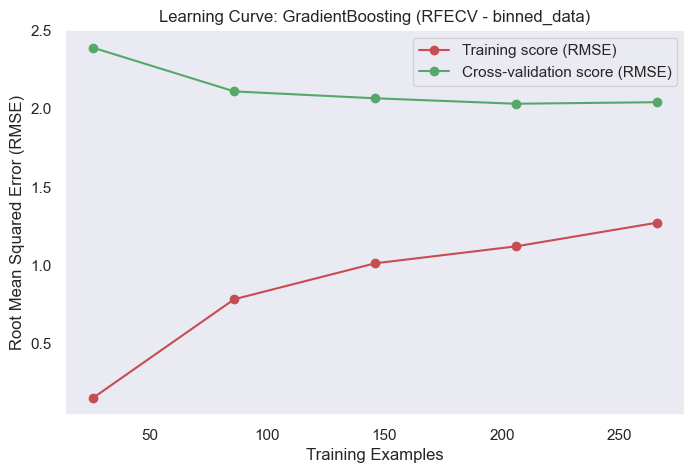

  4. Creating Averaged Ensemble...


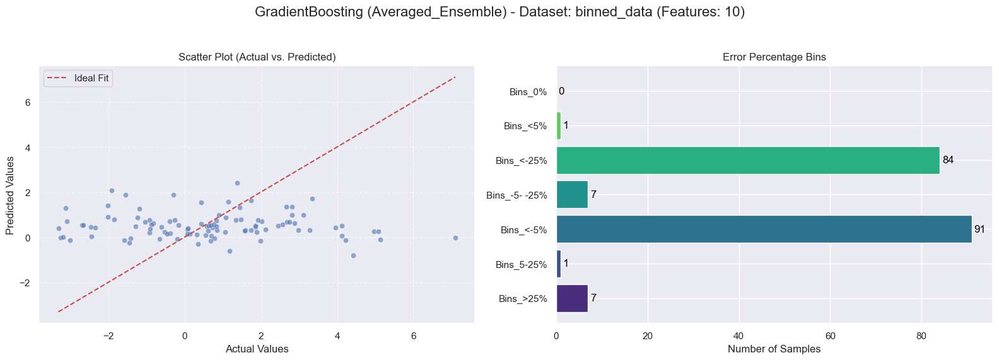

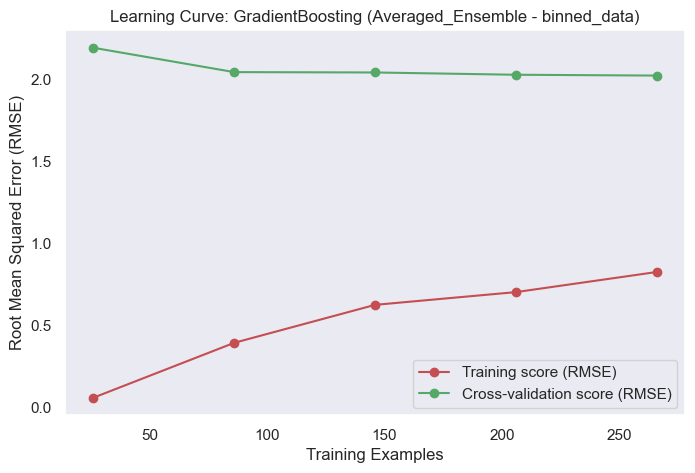

--- Finished Modeling for: GradientBoosting ---


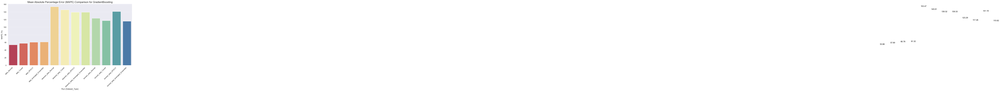





           CONSOLIDATED RESULTS FOR GradientBoosting

--- Best Parameters for Tuned GradientBoosting Models ---
        Dataset                                 Best_Params
0          data  {'learning_rate': 0.1, 'n_estimators': 50}
1  cleaned_data  {'learning_rate': 0.1, 'n_estimators': 50}
2   binned_data  {'learning_rate': 0.1, 'n_estimators': 50}
               Model               Type       Dataset        MAPE       SMAPE  \
95  GradientBoosting  Averaged_Ensemble   binned_data  115.624556  141.395374   
92  GradientBoosting             Normal   binned_data  123.289699  141.015117   
94  GradientBoosting              RFECV   binned_data  141.189419  147.360155   
93  GradientBoosting              Tuned   binned_data  117.258709  140.549908   
91  GradientBoosting  Averaged_Ensemble  cleaned_data  139.334171    63.86303   
88  GradientBoosting             Normal  cleaned_data  153.471756   66.598701   
90  GradientBoosting              RFECV  cleaned_data  139.316853   66.436526

In [67]:
MODEL_NAME = 'GradientBoosting' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 9. SVR

--- Starting Modeling for: SVR ---

--- Processing Dataset: data ---
  1. Training Normal Model...


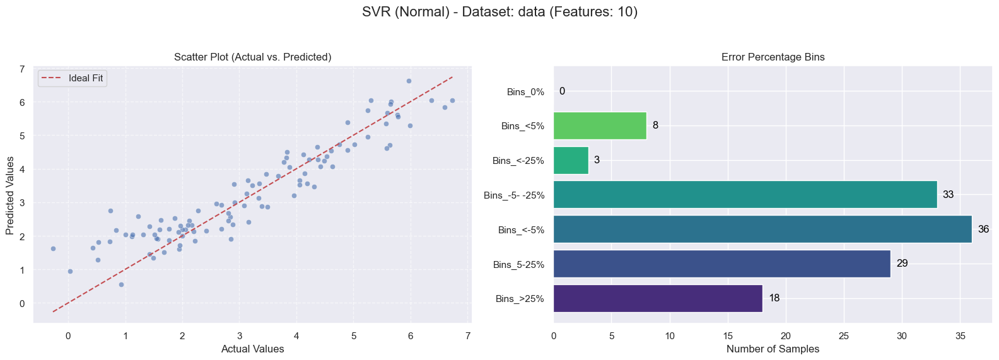

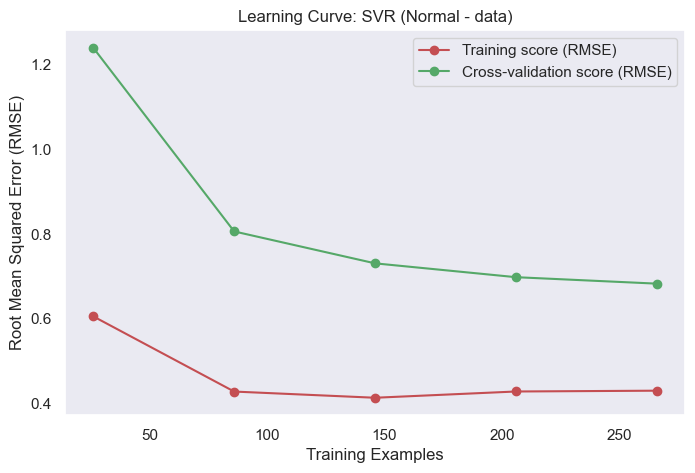

  2. Tuning Model with GridSearchCV...


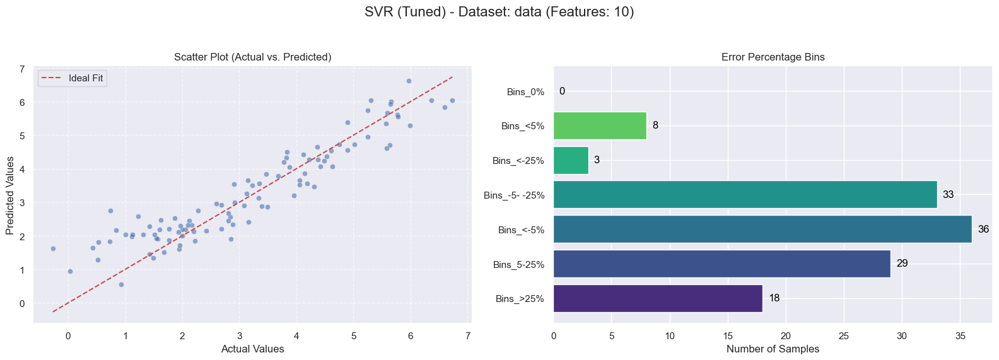

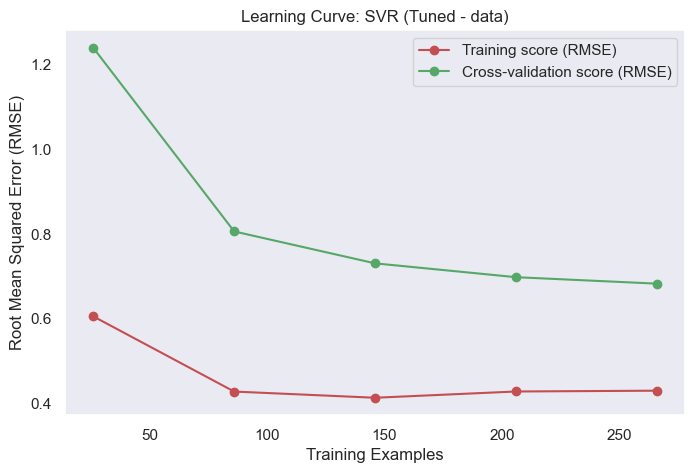

  3. Running RFECV Feature Selection...


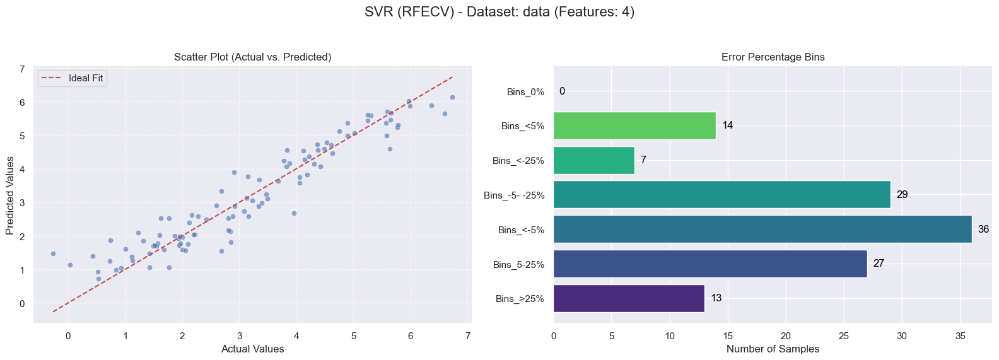

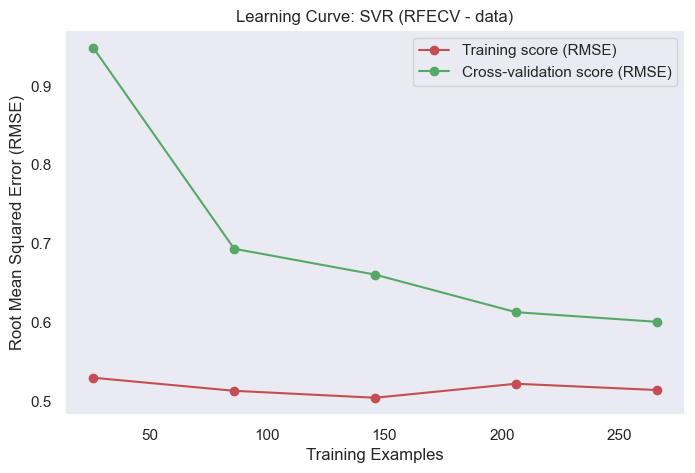

  4. Creating Averaged Ensemble...


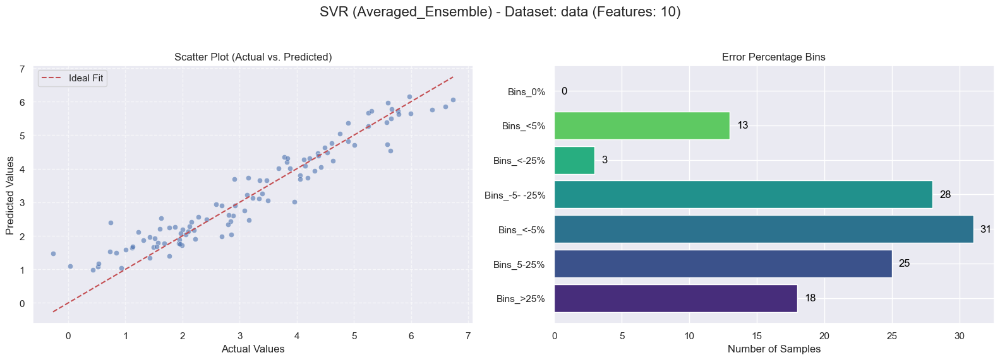

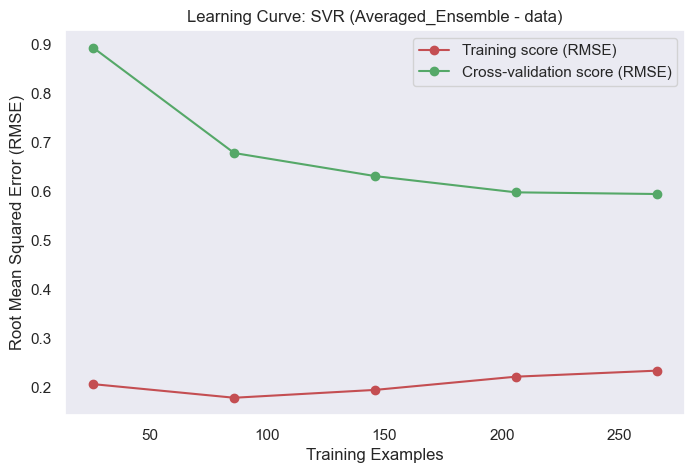


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


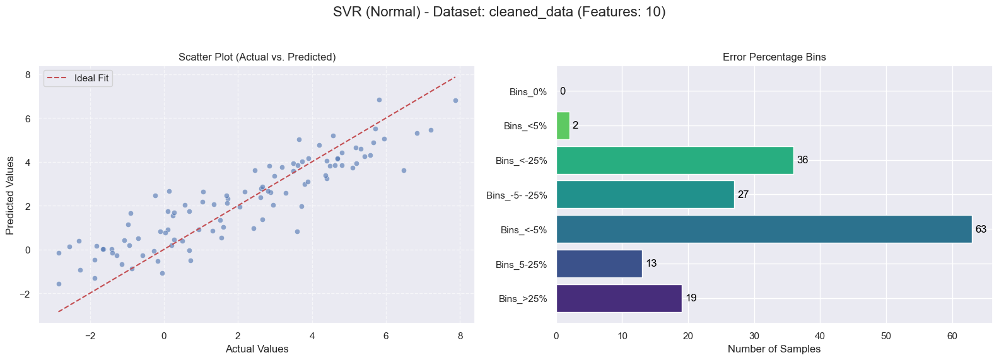

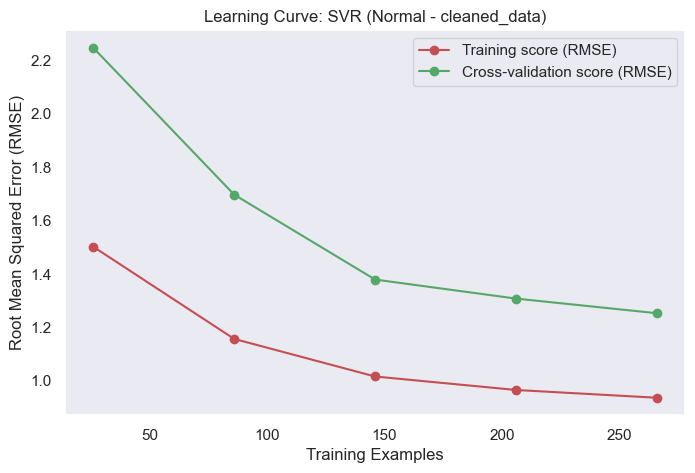

  2. Tuning Model with GridSearchCV...


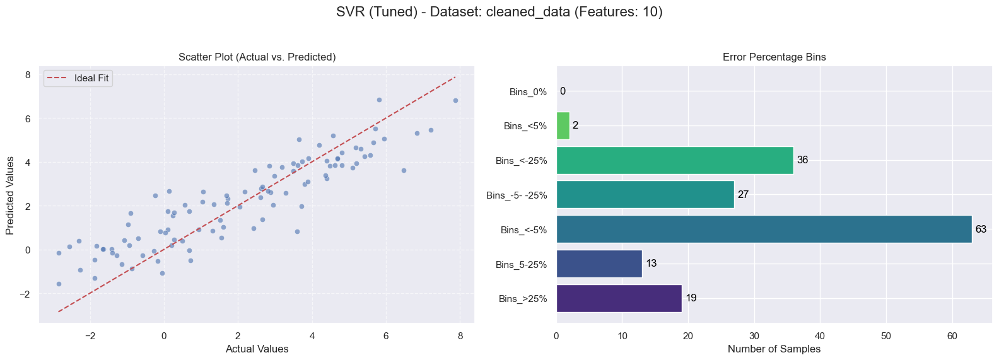

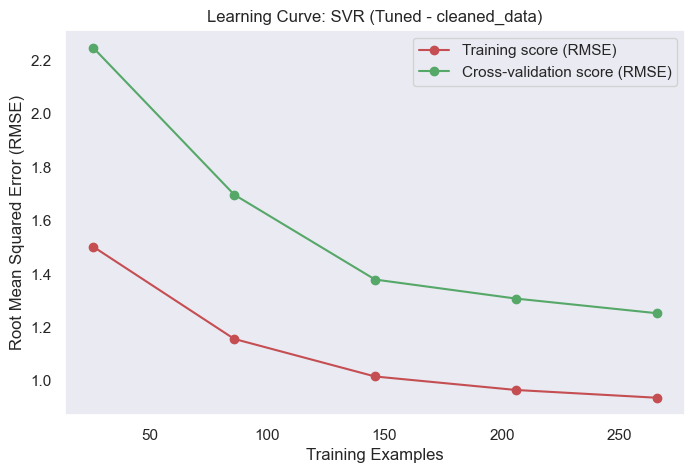

  3. Running RFECV Feature Selection...


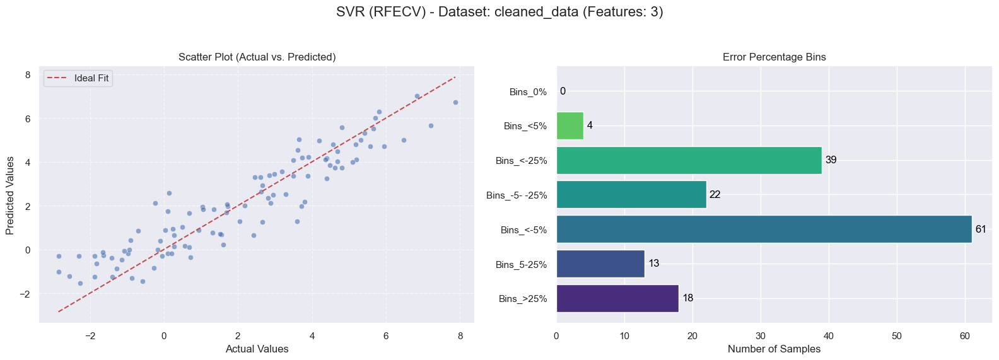

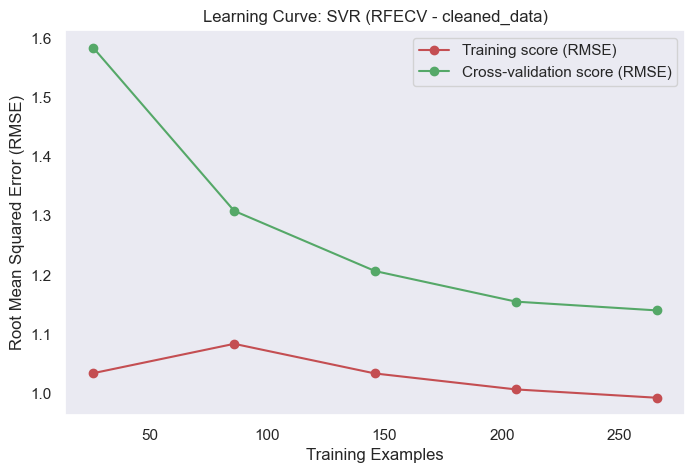

  4. Creating Averaged Ensemble...


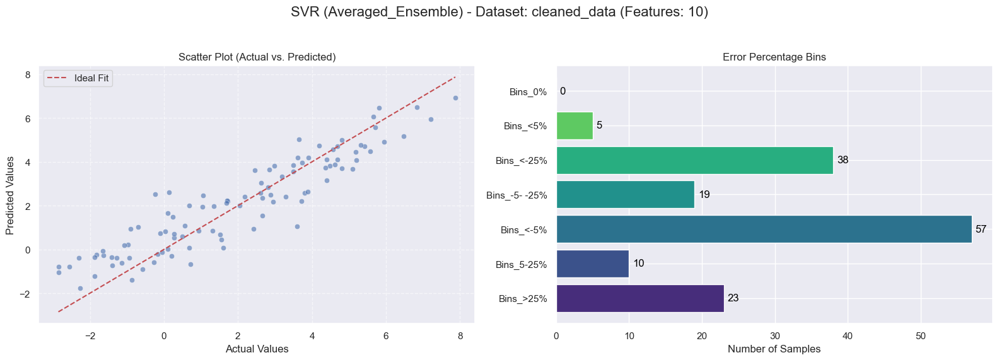

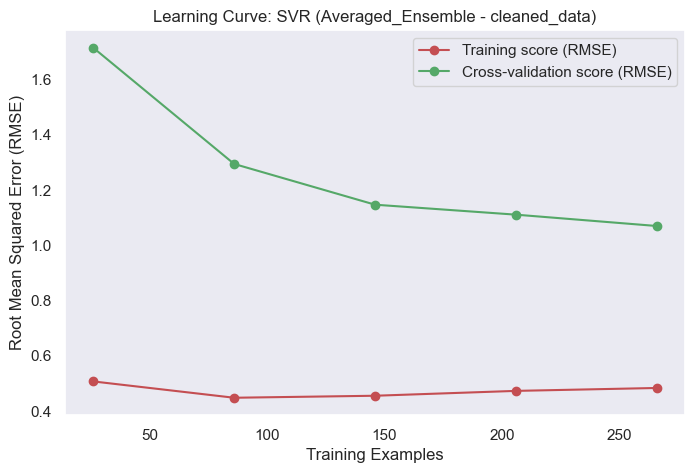


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


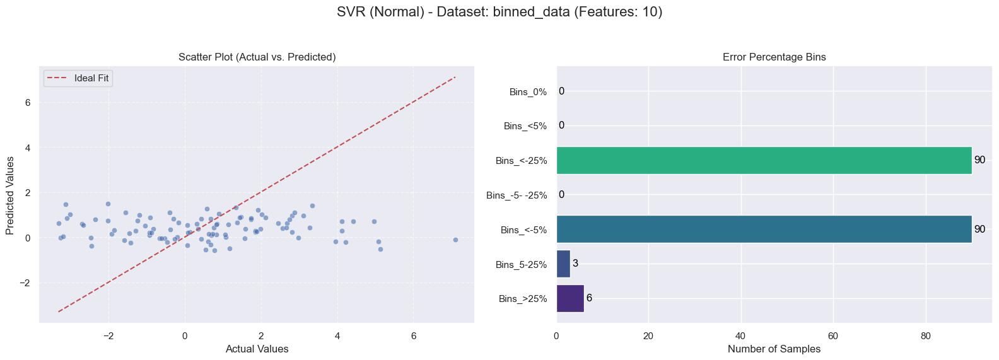

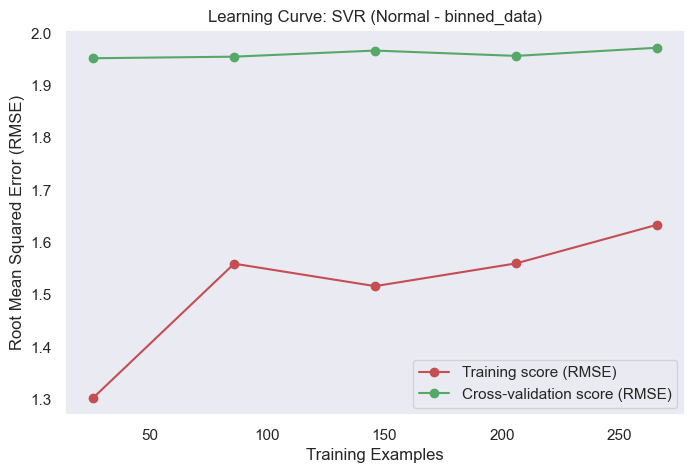

  2. Tuning Model with GridSearchCV...


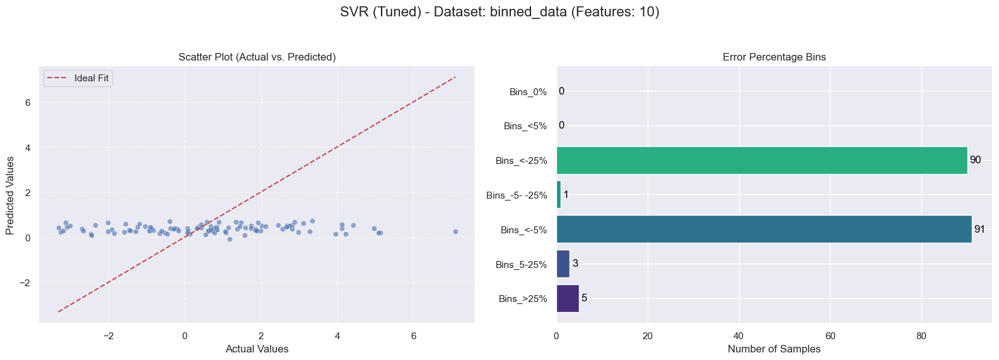

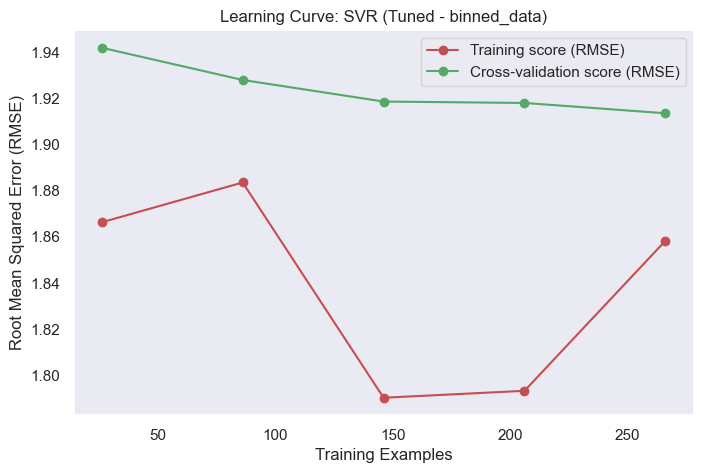

  3. Running RFECV Feature Selection...


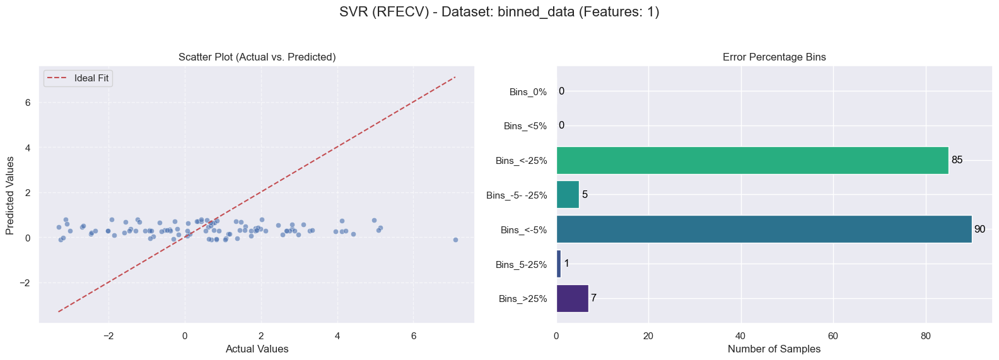

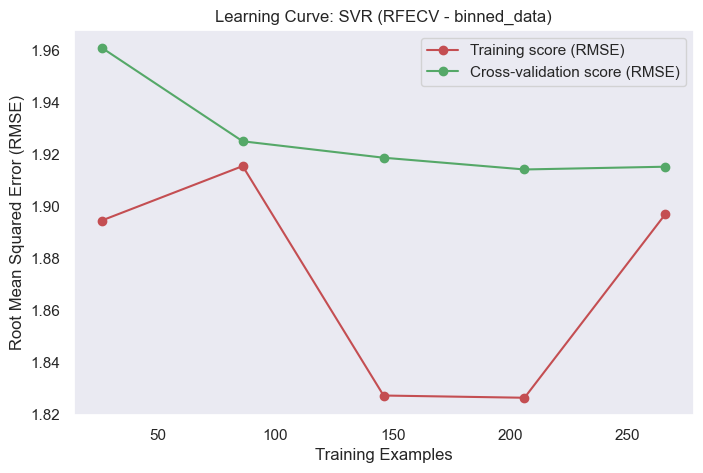

  4. Creating Averaged Ensemble...


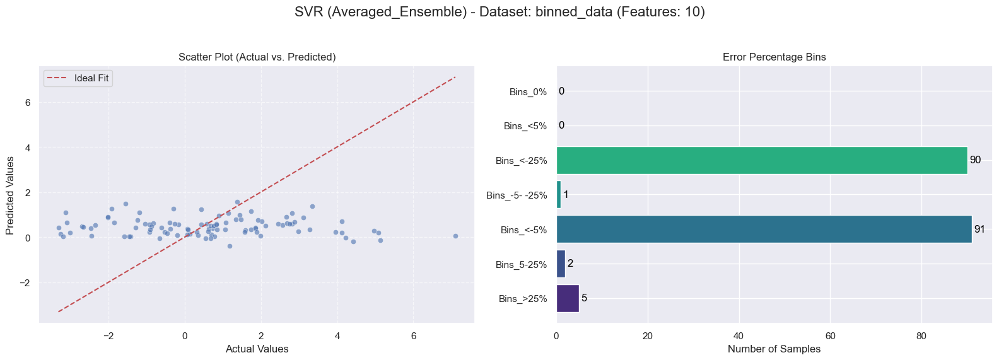

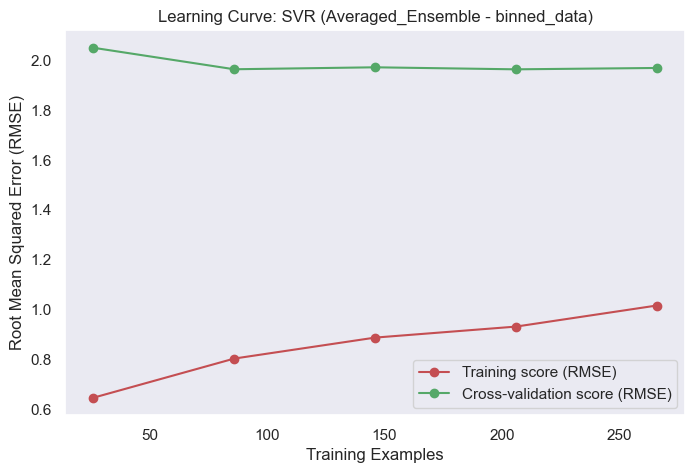

--- Finished Modeling for: SVR ---


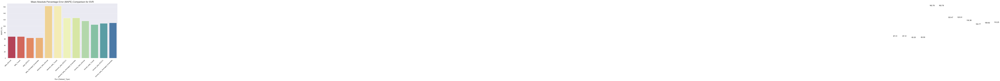





           CONSOLIDATED RESULTS FOR SVR

--- Best Parameters for Tuned SVR Models ---
        Dataset                  Best_Params
0          data  {'C': 1.0, 'kernel': 'rbf'}
1  cleaned_data  {'C': 1.0, 'kernel': 'rbf'}
2   binned_data  {'C': 0.1, 'kernel': 'rbf'}
    Model               Type       Dataset        MAPE       SMAPE      RMSE  \
107   SVR  Averaged_Ensemble   binned_data  110.250881  143.666312  2.220257   
104   SVR             Normal   binned_data  116.375106  147.656075  2.237608   
106   SVR              RFECV   binned_data  108.818101  153.532954  2.190301   
105   SVR              Tuned   binned_data  104.769115  147.225459  2.162078   
103   SVR  Averaged_Ensemble  cleaned_data  125.914166   64.326069  1.037853   
100   SVR             Normal  cleaned_data  162.760938   72.054396  1.208391   
102   SVR              RFECV  cleaned_data  125.473234   66.705915  0.997355   
101   SVR              Tuned  cleaned_data  162.760938   72.054396  1.208391   
99    SVR 

In [68]:
MODEL_NAME = 'SVR' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


### 10. KNN

--- Starting Modeling for: KNN ---

--- Processing Dataset: data ---
  1. Training Normal Model...


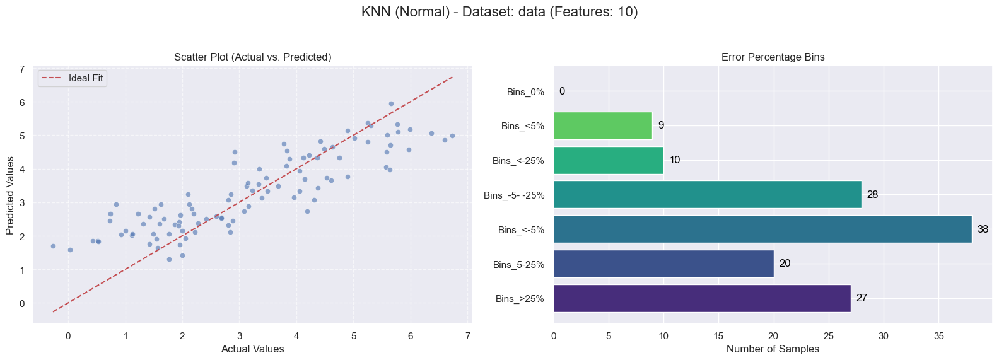

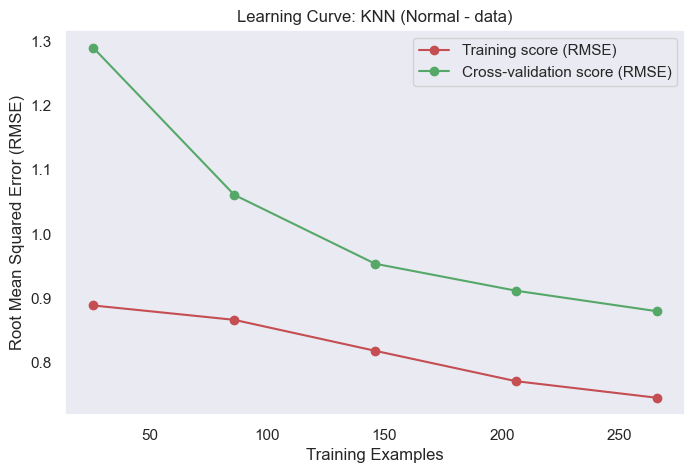

  2. Tuning Model with GridSearchCV...


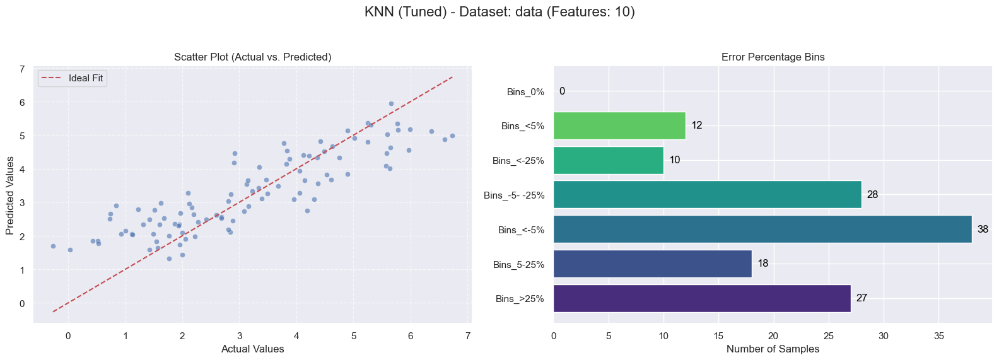

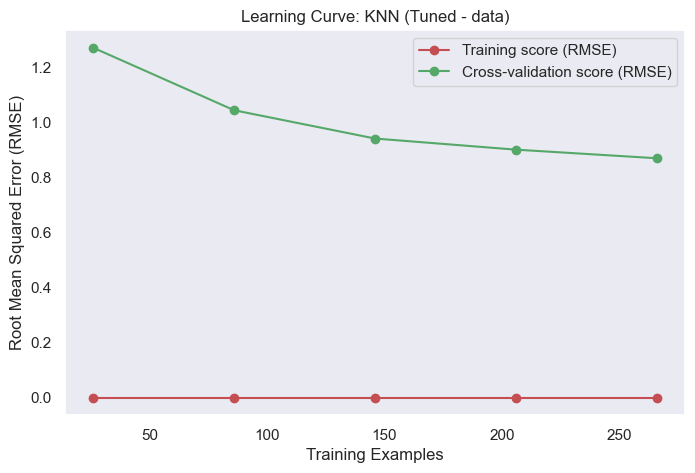

  3. Running RFECV Feature Selection...


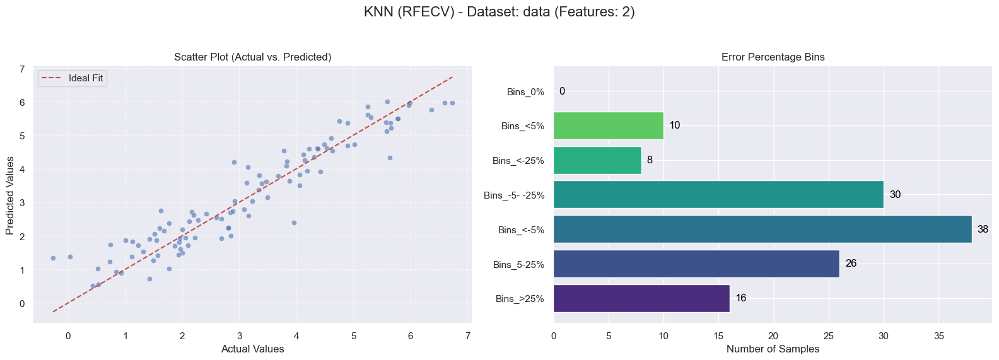

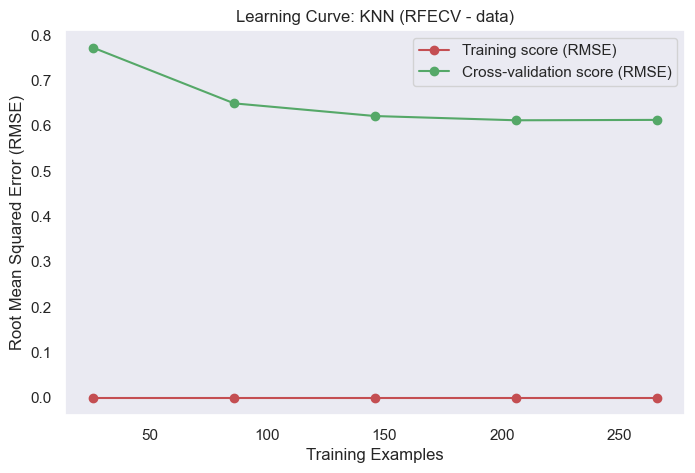

  4. Creating Averaged Ensemble...


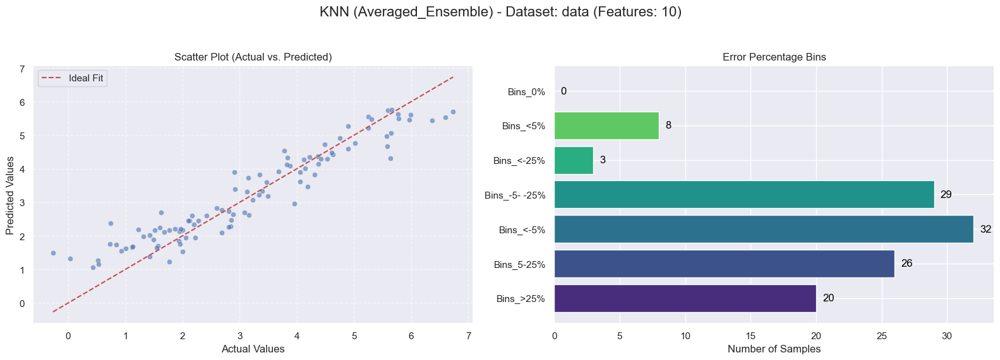

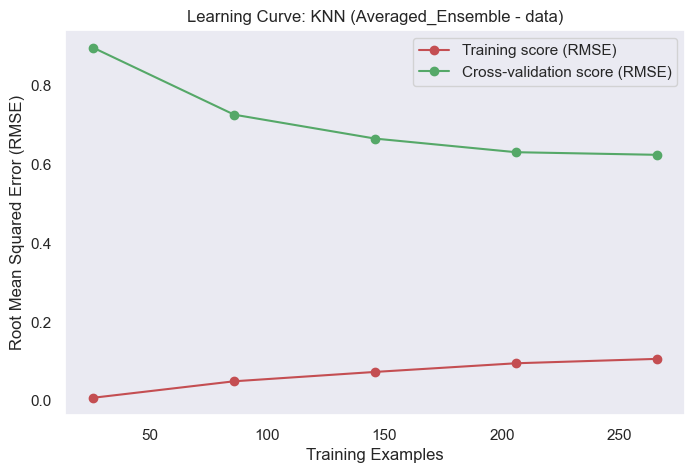


--- Processing Dataset: cleaned_data ---
  1. Training Normal Model...


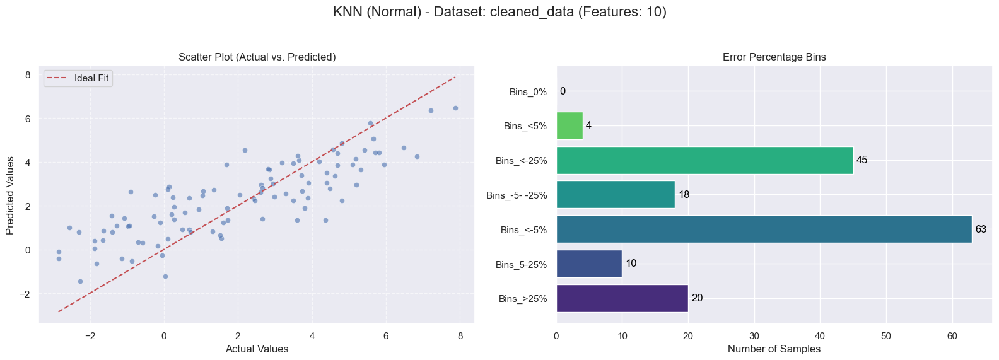

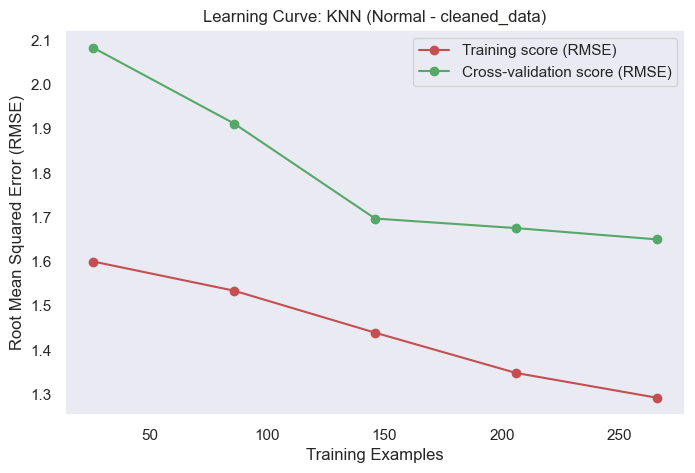

  2. Tuning Model with GridSearchCV...


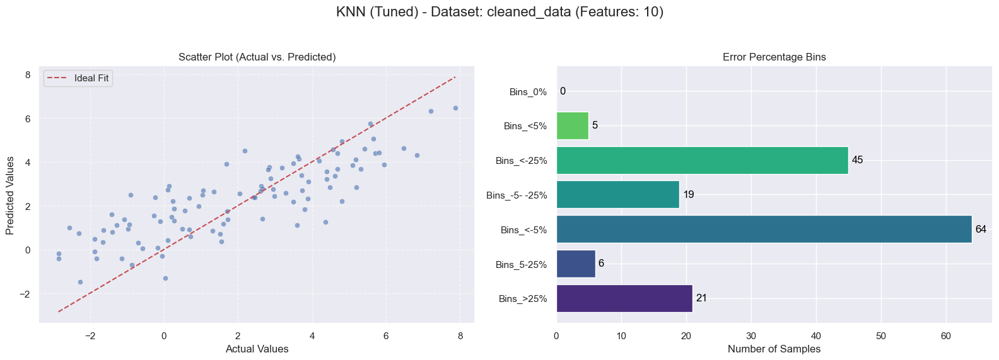

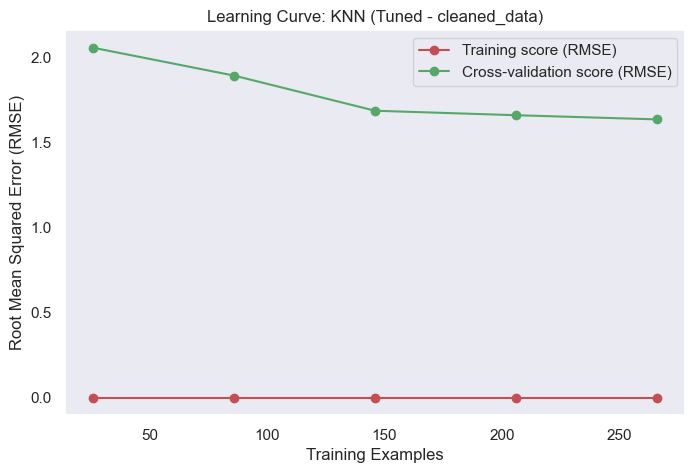

  3. Running RFECV Feature Selection...


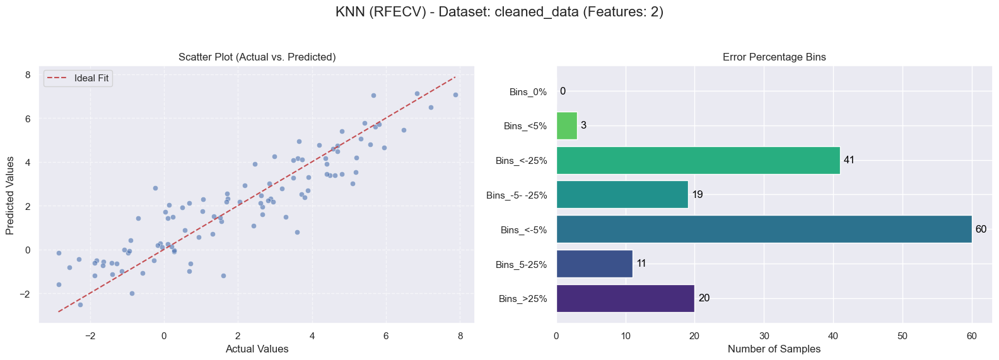

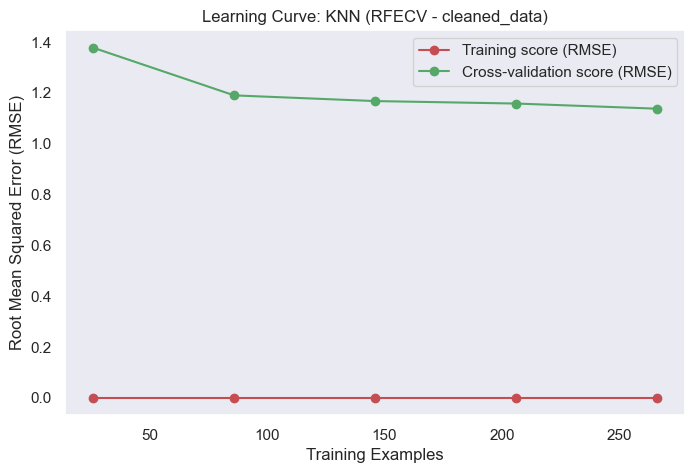

  4. Creating Averaged Ensemble...


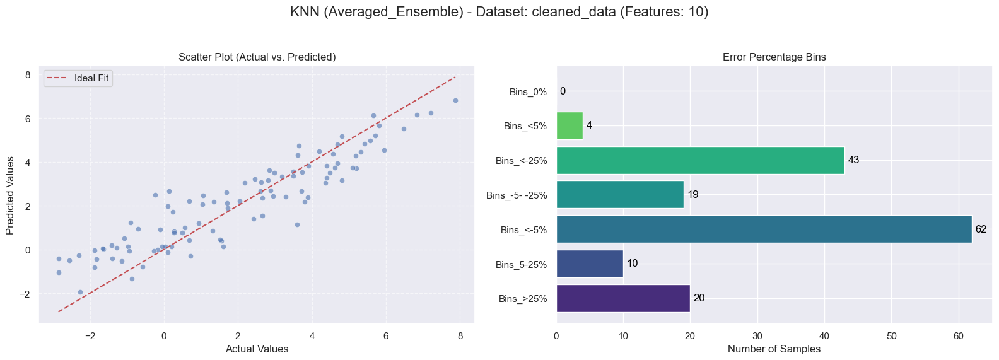

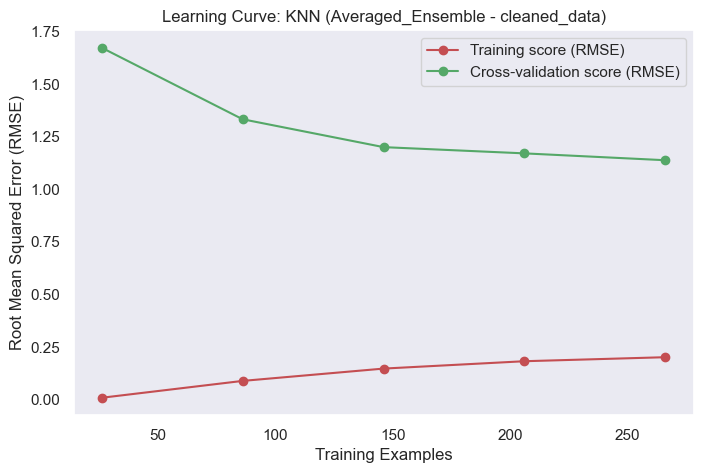


--- Processing Dataset: binned_data ---
  1. Training Normal Model...


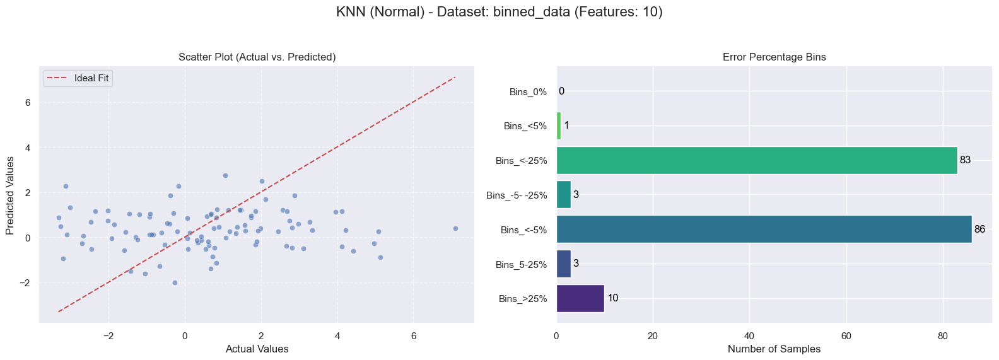

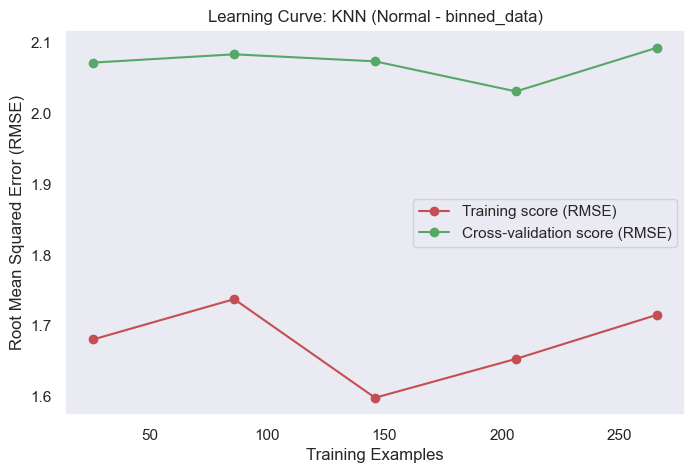

  2. Tuning Model with GridSearchCV...


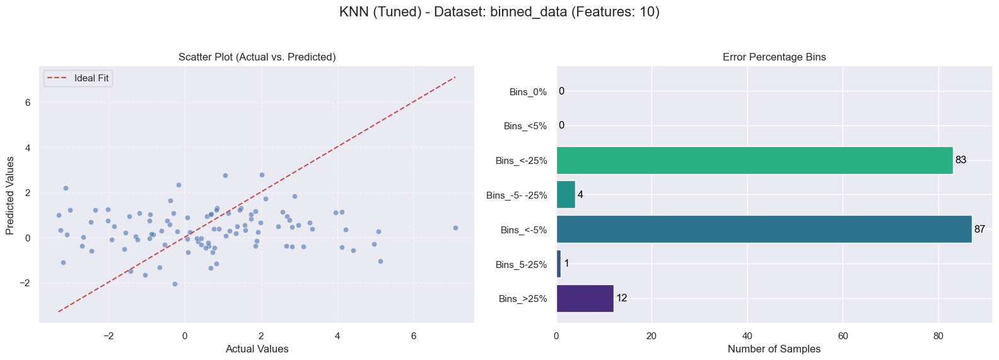

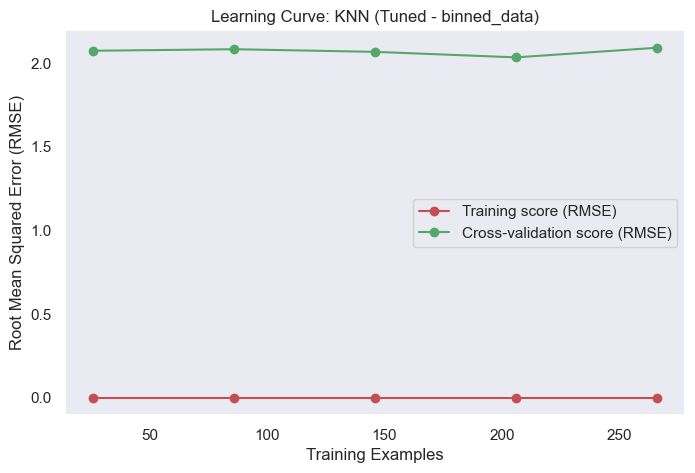

  3. Running RFECV Feature Selection...


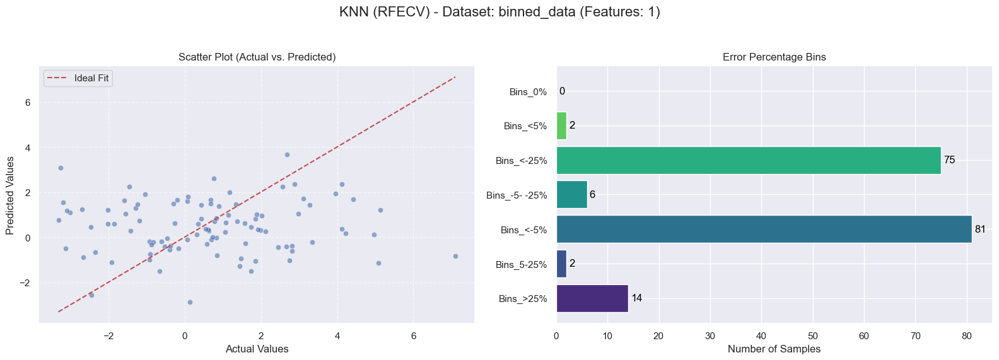

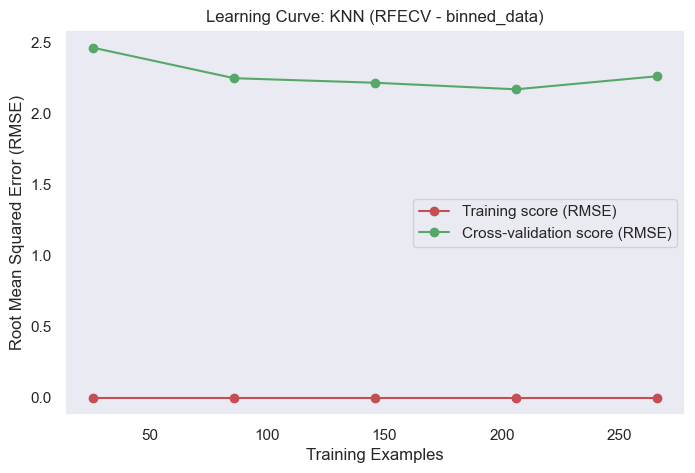

  4. Creating Averaged Ensemble...


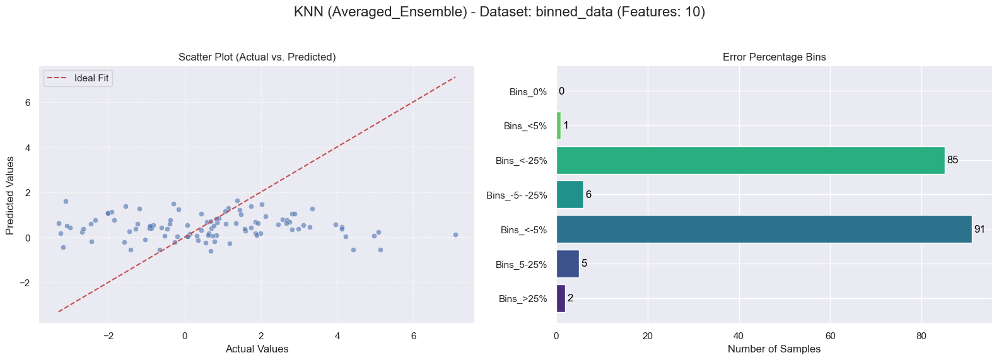

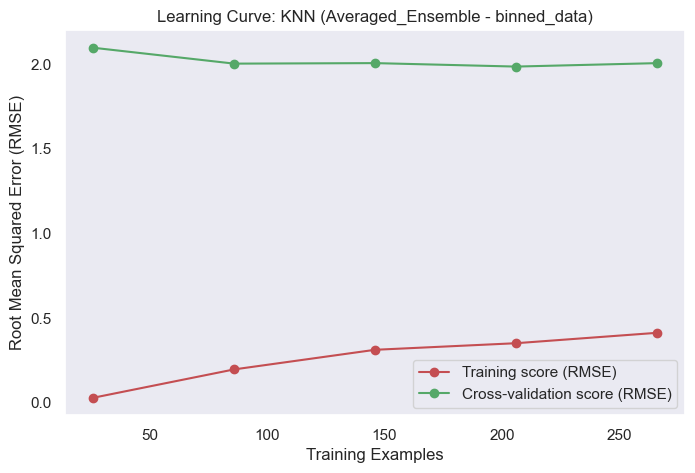

--- Finished Modeling for: KNN ---


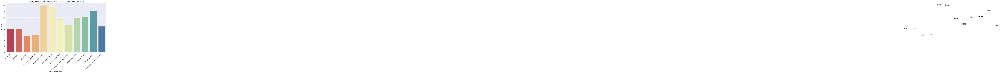





           CONSOLIDATED RESULTS FOR KNN

--- Best Parameters for Tuned KNN Models ---
        Dataset                                Best_Params
0          data  {'n_neighbors': 5, 'weights': 'distance'}
1  cleaned_data  {'n_neighbors': 5, 'weights': 'distance'}
2   binned_data  {'n_neighbors': 5, 'weights': 'distance'}
    Model               Type       Dataset        MAPE       SMAPE      RMSE  \
119   KNN  Averaged_Ensemble   binned_data  111.940679  138.703326  2.238809   
116   KNN             Normal   binned_data  149.268645  146.980489   2.31985   
118   KNN              RFECV   binned_data  179.232496  130.259074   2.42304   
117   KNN              Tuned   binned_data  152.288224  146.850622  2.311908   
115   KNN  Averaged_Ensemble  cleaned_data   119.83292   71.227566  1.106926   
112   KNN             Normal  cleaned_data  201.697253   82.367573  1.566516   
114   KNN              RFECV  cleaned_data  143.830788   66.522788  1.106077   
113   KNN              Tuned  clea

In [69]:
MODEL_NAME = 'KNN' 
run_all_model_variations(MODEL_NAME)

print("\n" * 3)
print(f"================================================================")
print(f"           CONSOLIDATED RESULTS FOR {MODEL_NAME}")
print(f"================================================================")
display_best_params(MODEL_NAME)

# Display the main results table for the current model
display_cols = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Bins_>25%', 'Bins_<-25%']
print(ALL_RESULTS_DF[ALL_RESULTS_DF['Model'] == MODEL_NAME][display_cols].sort_values(by=['Dataset', 'Type']))


## Final Step: View All Results (After running all models)

In [70]:
print("\n\n--- MASTER RESULTS DATAFRAME (ALL MODELS) ---")
display_cols_final = ['Model', 'Type', 'Dataset', 'MAPE', 'SMAPE', 'RMSE', 'CV_Score', 'Feature_Count', 'Best_Params']
ALL_RESULTS_DF.to_csv('ALL_RESULTS_DF.csv', index=False)
print(ALL_RESULTS_DF[display_cols_final].sort_values(by=['Dataset', 'Model', 'Type']))



--- MASTER RESULTS DATAFRAME (ALL MODELS) ---
                Model               Type       Dataset        MAPE  \
35       DecisionTree  Averaged_Ensemble   binned_data  120.218358   
32       DecisionTree             Normal   binned_data  296.184398   
34       DecisionTree              RFECV   binned_data  148.672542   
33       DecisionTree              Tuned   binned_data  151.003729   
59         ElasticNet  Averaged_Ensemble   binned_data  111.877065   
56         ElasticNet             Normal   binned_data  112.851571   
58         ElasticNet              RFECV   binned_data  112.851571   
57         ElasticNet              Tuned   binned_data  111.887391   
83         ExtraTrees  Averaged_Ensemble   binned_data  113.721583   
80         ExtraTrees             Normal   binned_data   119.97887   
82         ExtraTrees              RFECV   binned_data  111.696324   
81         ExtraTrees              Tuned   binned_data  113.588166   
95   GradientBoosting  Averaged_Ensemble  

#### Explainable AI (XAI)

             EXPLAINABLE AI (XAI) ANALYSIS
CHAMPION MODEL IDENTIFIED:
  Model: LinearRegression (RFECV)
  Dataset: data
  MAPE: 47.88%
  Parameters: {}

Re-training champion model to retrieve the object and test data...
Champion model re-trained successfully.

--- Starting SHAP Analysis for LinearRegression (RFECV) on data ---
    Calculating SHAP values for 100 samples...


  0%|          | 0/100 [00:00<?, ?it/s]

    Generating Summary Plot (Global Importance)...


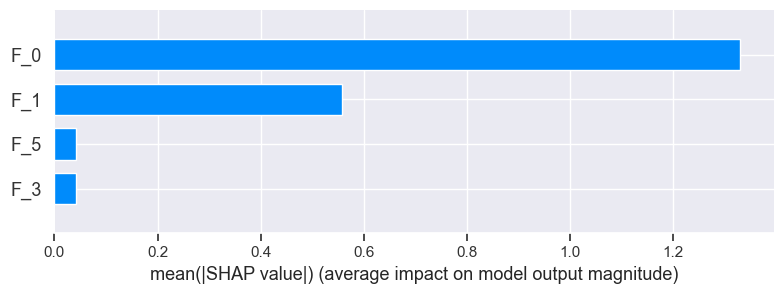

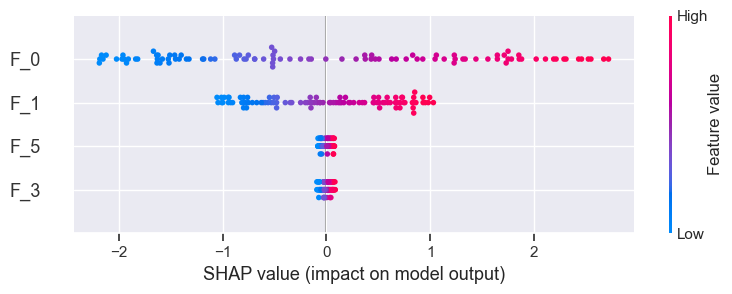

    Generating Dependence Plot (Top Feature)...


<Figure size 800x600 with 0 Axes>

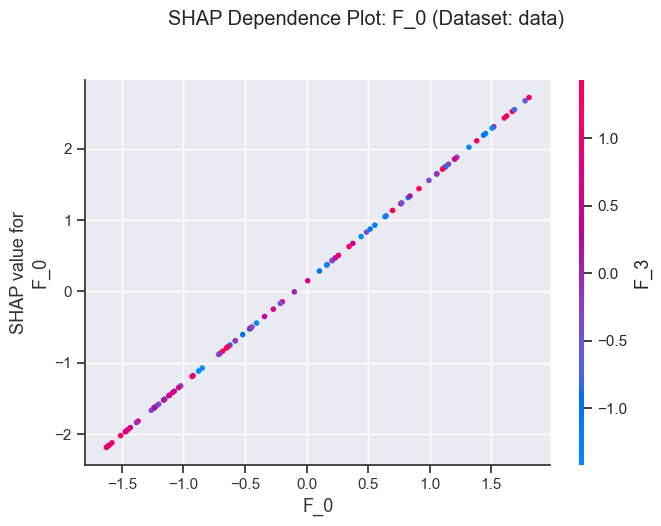

    Generating Force Plot (Local Explanation for first sample)...

--- Force Plot for Sample 0 (Requires interactive environment) ---


Displaying force plot (requires JS environment)...

SHAP analysis complete. Review the generated plots for insights.


In [71]:
# --- XAI Imports (Ensure these are available from the previous run) ---
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import shap 
from sklearn.model_selection import train_test_split, KFold, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor, VotingRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
import warnings
warnings.filterwarnings('ignore') # Suppress warnings during SHAP calculation

# --- Global Configuration (Must match previous code) ---
# Assuming these were defined globally in your environment:
# TARGET_COL = 'mental_health_score' 
# RANDOM_STATE = 42
# N_SPLITS = 3
# DATASETS = {...}
# MODEL_CONFIGS = {...}
# ALL_RESULTS_DF = pd.DataFrame(...) # Populated by model training

# Helper function to safely instantiate a model with or without random_state
def safe_instantiate_model(model_class, **kwargs):
    """Instantiates model, safely applying random_state if supported."""
    params = {}
    if 'random_state' in model_class().get_params() and 'random_state' not in kwargs:
        params['random_state'] = RANDOM_STATE
    
    # Handle n_jobs for ensemble/distance models
    if model_class in [RandomForestRegressor, ExtraTreesRegressor, VotingRegressor, KNeighborsRegressor] and 'n_jobs' not in kwargs:
         params['n_jobs'] = -1
         
    params.update(kwargs)
    return model_class(**params)


# Helper function to get the model class from the MODEL_CONFIGS dictionary
def get_model_class(model_key):
    """Returns the class object for a given model key."""
    class_map = {
        'LinearRegression': LinearRegression, 'Ridge': Ridge, 'Lasso': Lasso, 
        'ElasticNet': ElasticNet, 'DecisionTree': DecisionTreeRegressor, 
        'RandomForest': RandomForestRegressor, 'ExtraTrees': ExtraTreesRegressor, 
        'GradientBoosting': GradientBoostingRegressor, 'SVR': SVR, 
        'KNN': KNeighborsRegressor
    }
    return class_map.get(model_key)

# --- SHAP ANALYSIS FUNCTION (The core logic) ---
def perform_shap_analysis(model, X_test_df, model_key, dataset_name, num_samples=200):
    # ... (function body as previously provided - using the updated safe logic) ...
    """
    Performs SHAP analysis on a trained model and generates key visualizations.
    
    Args:
        model: The trained scikit-learn model.
        X_test_df (pd.DataFrame): The feature data used for prediction.
        model_key (str): Name of the model (for plotting titles).
        dataset_name (str): Name of the dataset (for plotting titles).
        num_samples (int): Number of test samples to use for SHAP calculation.
    """
    
    print(f"\n--- Starting SHAP Analysis for {model_key} on {dataset_name} ---")
    
    # 1. Select the appropriate Explainer
    tree_models = ['DecisionTree', 'RandomForest', 'ExtraTrees', 'GradientBoosting']
    model_name_base = model_key.split(' (')[0] # Remove '(Tuned)' or '(RFECV)' for check

    if model_name_base in tree_models:
        explainer = shap.TreeExplainer(model)
    else:
        # Use a small background dataset for KernelExplainer
        background = shap.sample(X_test_df, min(100, len(X_test_df)))
        explainer = shap.KernelExplainer(model.predict, background)

    # Use a subset of the test data for faster explanation calculation
    X_sample = shap.sample(X_test_df, min(num_samples, len(X_test_df)))
    
    # 2. Calculate SHAP values
    print(f"    Calculating SHAP values for {len(X_sample)} samples...")
    shap_values = explainer.shap_values(X_sample)
    
    # Handle multi-output (list of arrays) vs single-output (array) from shap
    if isinstance(shap_values, list):
        shap_values = shap_values[0] # Take the first output for regression tasks
        
    # --- 3. Global Feature Importance (Summary Plot) ---
    print("    Generating Summary Plot (Global Importance)...")
    plt.figure(figsize=(10, 6))
    plt.title(f'SHAP Global Feature Importance: {model_key} - {dataset_name}')
    shap.summary_plot(shap_values, X_sample, plot_type="bar", show=False)
    plt.show()

    plt.figure(figsize=(10, 6))
    plt.title(f'SHAP Feature Effect (Global Summary): {model_key} - {dataset_name}')
    # Plot showing impact magnitude (x-axis) and feature value (color)
    shap.summary_plot(shap_values, X_sample, show=False)
    plt.show()

    # --- 4. Feature Effect (Dependence Plot) ---
    print("    Generating Dependence Plot (Top Feature)...")
    
    # Identify the top feature to plot its dependence
    top_feature_index = np.argmax(np.mean(np.abs(shap_values), axis=0))
    top_feature_name = X_test_df.columns[top_feature_index]
    
    # Plot the dependence of the top feature
    plt.figure(figsize=(8, 6))
    shap.dependence_plot(top_feature_name, shap_values, X_sample, show=False)
    plt.suptitle(f'SHAP Dependence Plot: {top_feature_name} (Dataset: {dataset_name})', y=1.02)
    plt.show()

    # --- 5. Local Prediction Explanation (Force Plot for a single instance) ---
    print("    Generating Force Plot (Local Explanation for first sample)...")
    
    # Note: Force plots are best visualized in interactive notebooks (Jupyter/Colab)
    print(f"\n--- Force Plot for Sample 0 (Requires interactive environment) ---")
    shap.initjs()
    return shap.force_plot(explainer.expected_value, shap_values[0,:], X_sample.iloc[0,:])


# --- XAI EXECUTION BLOCK: Find and Explain the Champion Model ---

print("="*60)
print("             EXPLAINABLE AI (XAI) ANALYSIS")
print("="*60)

# 1. Identify the Champion Model (Lowest MAPE)
try:
    # Convert MAPE column to numeric, as it may be stored as object/string
    ALL_RESULTS_DF['MAPE'] = pd.to_numeric(ALL_RESULTS_DF['MAPE'])
    
    champion_run = ALL_RESULTS_DF.sort_values(by='MAPE').iloc[0]

    model_key = champion_run['Model']
    model_type = champion_run['Type']
    dataset_name = champion_run['Dataset']
    
    # Safely retrieve best_params (eval will convert string dict back to dict)
    best_params_str = champion_run['Best_Params']
    best_params = {}
    if best_params_str not in ['None', 'nan'] and isinstance(best_params_str, str):
        try:
            best_params = eval(best_params_str)
        except:
            pass # Keep best_params as empty dict if eval fails


    print(f"CHAMPION MODEL IDENTIFIED:")
    print(f"  Model: {model_key} ({model_type})")
    print(f"  Dataset: {dataset_name}")
    print(f"  MAPE: {champion_run['MAPE']:.2f}%")
    print(f"  Parameters: {best_params}")
    print("\nRe-training champion model to retrieve the object and test data...")


    # 2. Prepare Data for the Champion Run
    df = DATASETS[dataset_name]
    X = df.drop(columns=[TARGET_COL])
    y = df[TARGET_COL]
    
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    X_scaled = pd.DataFrame(X_scaled, columns=X.columns)
    
    # Split the data EXACTLY as it was during training
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y, test_size=0.2, random_state=RANDOM_STATE
    )

    # 3. Retrain the Champion Model (to get the model object)
    base_model_class = get_model_class(model_key)
    
    # Base model instantiation with known best parameters
    champion_model = safe_instantiate_model(base_model_class, **best_params)
    
    # Handle Averaged Ensemble separately
    if model_type == 'Averaged_Ensemble':
        # Recreate the base model with its best params for the ensemble component
        model_tuned_component = safe_instantiate_model(base_model_class, **best_params)

        estimators = [
            (model_key, model_tuned_component),
            ('GB', safe_instantiate_model(GradientBoostingRegressor, n_estimators=50)),
            ('ET', safe_instantiate_model(ExtraTreesRegressor, n_estimators=50))
        ]
        champion_model = safe_instantiate_model(VotingRegressor, estimators=estimators)
        

    # If the champion was RFECV, re-run RFECV to get the correct feature subset
    if model_type == 'RFECV':
        rfecv_estimator = MODEL_CONFIGS[model_key]['rfecv_estimator']
        selector = RFECV(
            rfecv_estimator,
            step=1,
            cv=KFold(N_SPLITS, shuffle=True, random_state=RANDOM_STATE),
            scoring='neg_root_mean_squared_error',
            n_jobs=-1
        )
        selector.fit(X_train, y_train)
        X_train_final = X_train.loc[:, selector.support_]
        X_test_final = X_test.loc[:, selector.support_]
        
        champion_model.fit(X_train_final, y_train)
    else:
        # Use full scaled data for all other types
        X_train_final = X_train
        X_test_final = X_test
        champion_model.fit(X_train_final, y_train)
        

    print("Champion model re-trained successfully.")
    
    # 4. Perform SHAP Analysis
    shap_plot_result = perform_shap_analysis(
        model=champion_model, 
        X_test_df=X_test_final, 
        model_key=f"{model_key} ({model_type})", 
        dataset_name=dataset_name,
        num_samples=min(200, len(X_test_final)) # Use up to 200 samples for a better view
    )
    
    # Display the force plot (only useful in interactive environments)
    if 'shap_plot_result' in locals():
        print("Displaying force plot (requires JS environment)...")
        # return shap_plot_result # You might need to uncomment this in Jupyter/Colab

    print("\nSHAP analysis complete. Review the generated plots for insights.")

except NameError:
    print("Error: Required variables (ALL_RESULTS_DF, DATASETS, MODEL_CONFIGS) not found.")
    print("Please ensure the entire preceding model training code has been executed in the current environment.")
except Exception as e:
    print(f"An unexpected error occurred during XAI execution: {e}")